<a href="https://colab.research.google.com/github/vimalrajanb/Stock-market-prediction-Reinforcement-learning/blob/main/Stock_market_prediction_Reinforcement_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Predicting few share values of Indian Stock market using Reinforcement learning


In [ ]:
import yfinance as yf
import pandas as pd
import pandas_ta as ta
import numpy as np
#import matplotlib.pylab as plt
#import matplotlib.lines as mlines
from sklearn.preprocessing import StandardScaler
import gym
from gym import spaces
import mplfinance as mpf
from aif_course.aif_environment import DataLoaderNew
import seaborn as sns

In [ ]:
def visual(tick_obj):
        #visulaising the stock pricce along with Moving average
        mpf.plot(tick_obj.raw_data, type='line', mav=(50,100), volume =True, figratio=(18,10),panel_ratios=(1,1))

def company_analysis(tick_obj):
        #getting 3  stat for getting an idea of overall company performance
        tick = yf.Ticker(tick_obj.ticker)
        print('ebitdaMargins  : ', tick.info['ebitdaMargins'])
        print('trailingPE : ', tick.info['trailingPE'])
        print('marketCap : ', tick.info['marketCap'])


def hist_density_plot(tick_obj):
    sns.distplot(tick_obj.df['returns'], hist = True, kde = True, bins = 20,
                 kde_kws = {'linewidth': 3},hist_kws={'edgecolor':'black'},
            )

    plt.legend(prop={'size': 30} )
    plt.title('Density Plot of daily returns')
    plt.xlabel('Descrete Returns')
    plt.ylabel('Density')

reliance = DataLoaderNew(ticker = 'RELIANCE.NS',
                start_date = '2011-07-01',
                end_date = '2022-07-31',
                use_variables = [])

mrf = DataLoaderNew(ticker = 'MRF.NS',
                start_date = '2011-07-01',
                end_date = '2022-07-31',
                use_variables = [],
                trading_days = 252)

tcs = DataLoaderNew(ticker = 'TCS.NS',
                start_date = '2011-07-01',
                end_date = '2022-07-31',
                use_variables = [])


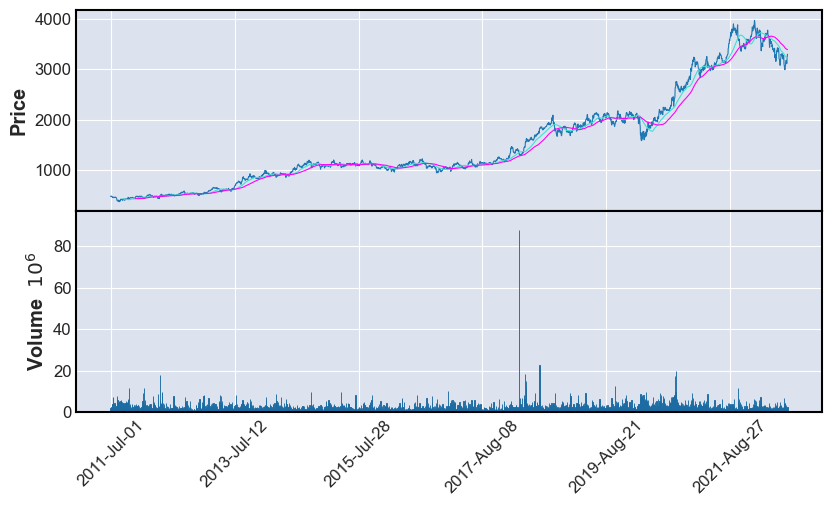

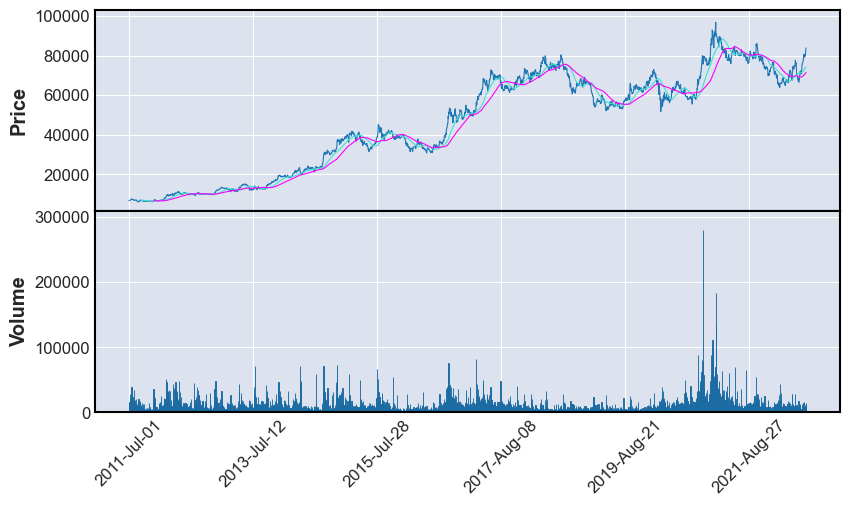

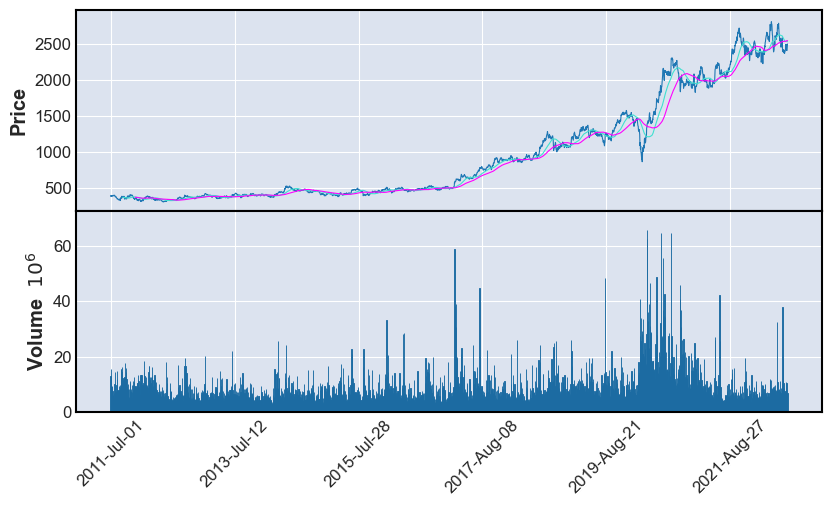

In [ ]:
visual(tcs)
visual(mrf)
visual(reliance)

<AxesSubplot:xlabel='Date'>

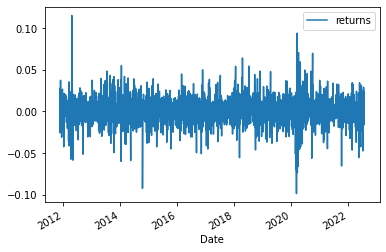

In [ ]:
tcs.df['returns'].plot(legend = True)

<AxesSubplot:xlabel='Date'>

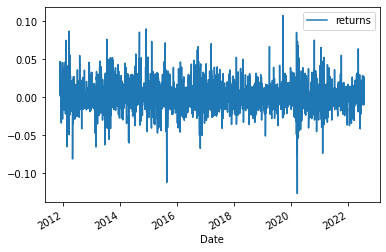

In [ ]:
mrf.df['returns'].plot(legend = True)

<AxesSubplot:xlabel='Date'>

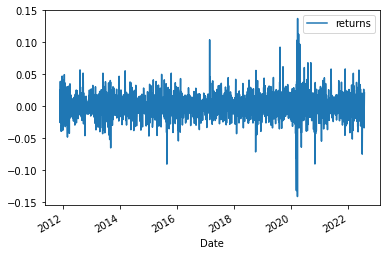

In [ ]:
reliance.df['returns'].plot(legend = True)

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


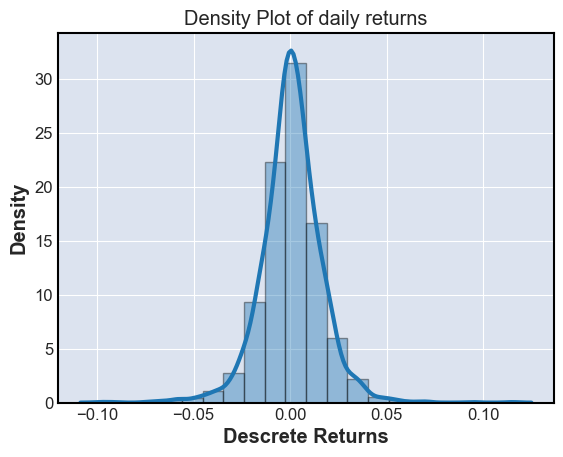

In [ ]:
import matplotlib.pylab as plt
hist_density_plot(tcs)

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


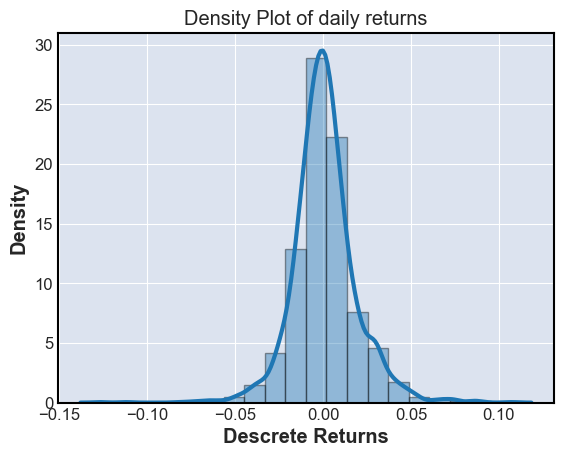

In [ ]:
hist_density_plot(mrf)

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


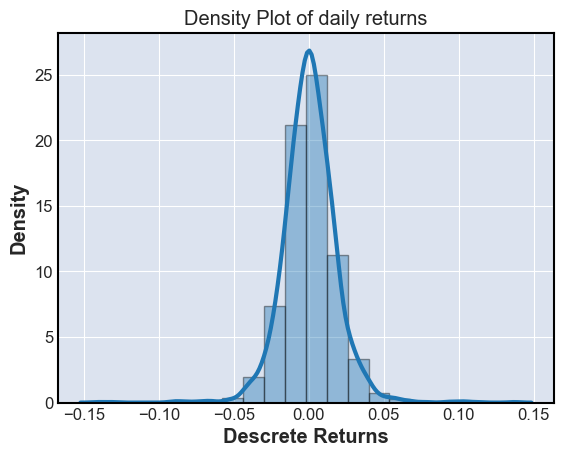

In [ ]:
hist_density_plot(reliance)

#### Observations

Results after training the agent 5 times for the time period 2012- 2017.

- For TCS, the average result of the agent being better than the benchmark is 0.9 which is good, and 4 out of 5 agents went for long action more, which is in favor of the steady improvement market.

- Also for MRF, the avg better performance is 0.8 which is again a decent one. The agent also bought the shares more, which in my opinion is a good decision for MRF considering the bullish market.

- while for Reliance, although it has a long-term upward market, most action taken is short which can be explained from the trained data frame where it was sidewise market; and it shows an average of 0.8 better than the benchmark strategy.

In [ ]:
from aif_course.aif_environment import TradingEnvironmentNew
from stable_baselines3 import A2C
from aif_course.aif_analysis import ai_trade_performance ,analyze_actions_taken

tickers = ['TCS.NS','MRF.NS','RELIANCE.NS']

seed = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]

def train_agent(ticker_name, ta_indicators_used = [], start_date = '2012-01-01', end_date = '2017-12-31'):
    env = TradingEnvironmentNew(ticker = ticker_name)
    for i in range (0,5):
        model = A2C('MlpPolicy', env, verbose = 0)
        model.learn(total_timesteps = 70000)
        res = ai_trade_performance(env, model, seeds = seed, num_plays = 20)
        print(res)
        action_counts = analyze_actions_taken(env, model, plot_actions = True, environment_new = True)
        print (action_counts)

    return env,model

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


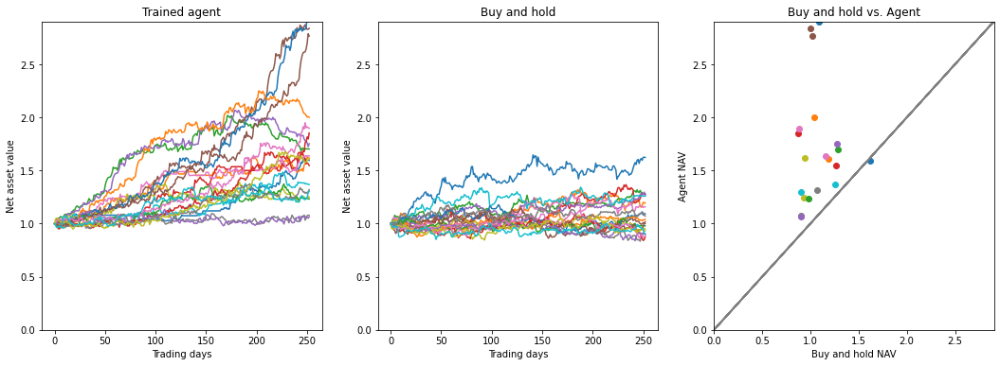

(             agent_avg  market_avg  agent_better
return        1.716730    1.080007          0.95
return_risk   0.951722    0.402058          1.00, array([1.59575499, 1.6116713 , 1.7028207 , 1.54674988, 1.7522708 ,
       2.83787163, 1.63770003, 1.07747731, 1.24902585, 1.36895888,
       2.90374543, 2.00093695, 1.23248582, 1.8532723 , 1.06234825,
       2.76587646, 1.89845633, 1.31955097, 1.61631802, 1.30129857]), array([1.62341506, 1.19242898, 1.28184402, 1.26994578, 1.27568737,
       1.00159737, 1.15873313, 0.90247809, 0.93278024, 1.25854597,
       1.09278711, 1.03975444, 0.98039571, 0.87651742, 0.89837176,
       1.01616632, 0.8795947 , 1.07027009, 0.9459289 , 0.90290195]))


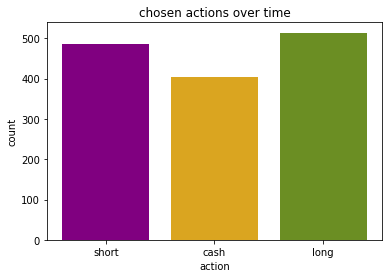

{'short': 486, 'cash': 404, 'long': 514}


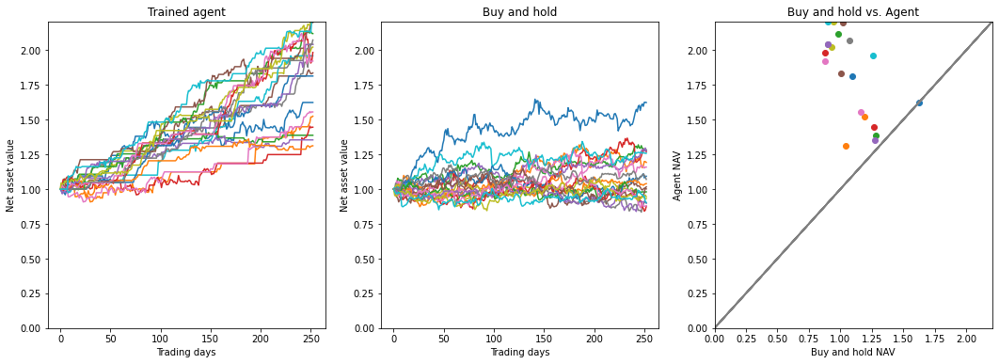

(             agent_avg  market_avg  agent_better
return        1.831667    1.080007           1.0
return_risk   1.247974    0.402058           1.0, array([1.62388494, 1.52492223, 1.38777178, 1.44587221, 1.3546236 ,
       1.8364125 , 1.55535816, 2.04142862, 2.02282438, 1.95943145,
       1.81413846, 1.31220842, 2.11977097, 1.98393526, 2.04142862,
       2.19885735, 1.92181225, 2.07339456, 2.20714586, 2.20811313]), array([1.62341506, 1.19242898, 1.28184402, 1.26994578, 1.27568737,
       1.00159737, 1.15873313, 0.90247809, 0.93278024, 1.25854597,
       1.09278711, 1.03975444, 0.98039571, 0.87651742, 0.89837176,
       1.01616632, 0.8795947 , 1.07027009, 0.9459289 , 0.90290195]))


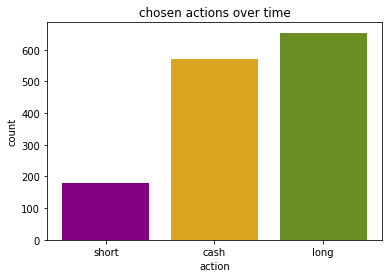

{'short': 180, 'cash': 570, 'long': 654}


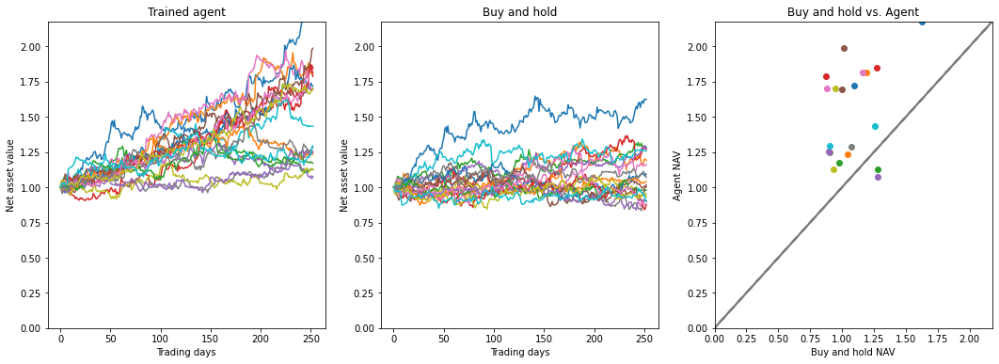

(             agent_avg  market_avg  agent_better
return        1.525027    1.080007           0.9
return_risk   1.156362    0.402058           1.0, array([2.17897911, 1.81281627, 1.12491491, 1.84640517, 1.07689067,
       1.69545318, 1.8191355 , 1.24698473, 1.12888481, 1.43273428,
       1.71906424, 1.23353186, 1.17202761, 1.78790272, 1.25342922,
       1.9874668 , 1.70073973, 1.28813556, 1.70274083, 1.29230072]), array([1.62341506, 1.19242898, 1.28184402, 1.26994578, 1.27568737,
       1.00159737, 1.15873313, 0.90247809, 0.93278024, 1.25854597,
       1.09278711, 1.03975444, 0.98039571, 0.87651742, 0.89837176,
       1.01616632, 0.8795947 , 1.07027009, 0.9459289 , 0.90290195]))


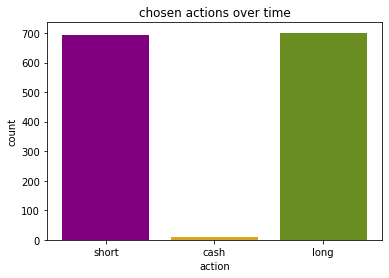

{'short': 692, 'cash': 11, 'long': 701}


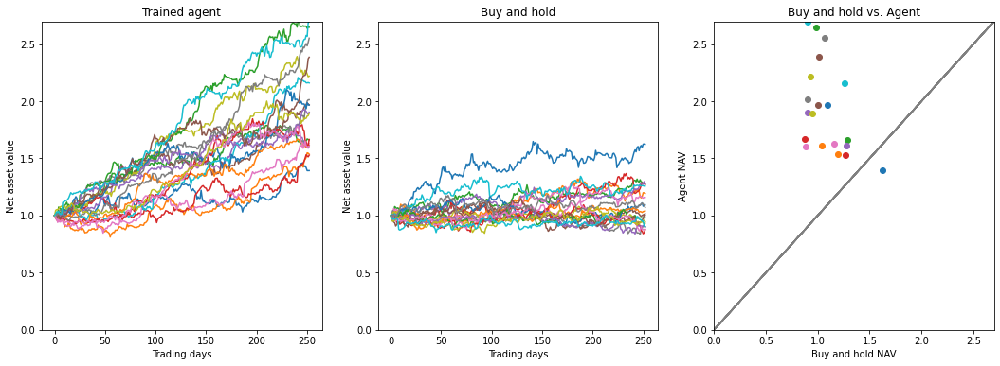

(             agent_avg  market_avg  agent_better
return        1.932244    1.080007          0.95
return_risk   1.147420    0.402058          1.00, array([1.39300142, 1.53630119, 1.66247078, 1.52722299, 1.61336194,
       1.96761974, 1.62793134, 2.01265982, 2.21897001, 2.15950153,
       1.96674605, 1.61095989, 2.64667144, 1.66520076, 1.90393265,
       2.38485415, 1.60426049, 2.55174228, 1.89361083, 2.69786926]), array([1.62341506, 1.19242898, 1.28184402, 1.26994578, 1.27568737,
       1.00159737, 1.15873313, 0.90247809, 0.93278024, 1.25854597,
       1.09278711, 1.03975444, 0.98039571, 0.87651742, 0.89837176,
       1.01616632, 0.8795947 , 1.07027009, 0.9459289 , 0.90290195]))


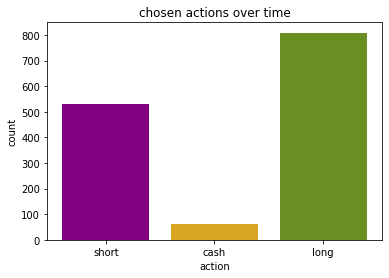

{'short': 532, 'cash': 63, 'long': 809}


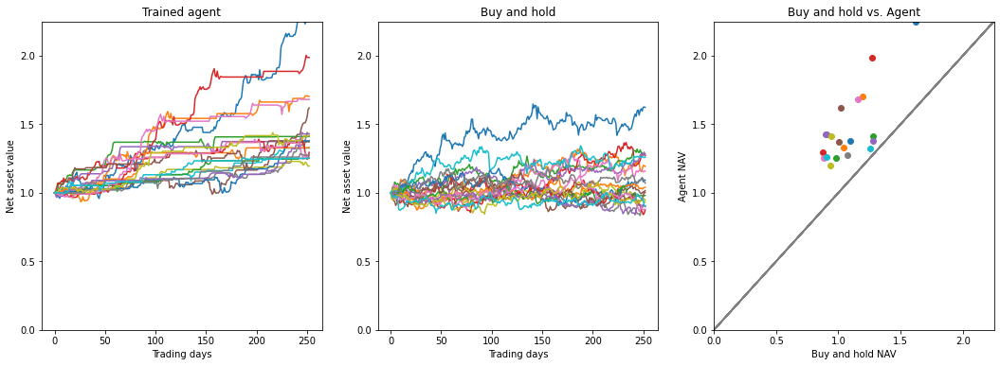

(             agent_avg  market_avg  agent_better
return        1.462216    1.080007           1.0
return_risk   1.157170    0.402058           1.0, array([2.25045908, 1.7038668 , 1.4106748 , 1.98756704, 1.37697956,
       1.37179106, 1.68131475, 1.42970507, 1.19594432, 1.32661913,
       1.37875052, 1.33059147, 1.25120609, 1.29502002, 1.42970507,
       1.6187044 , 1.25768674, 1.27379713, 1.41590399, 1.2580345 ]), array([1.62341506, 1.19242898, 1.28184402, 1.26994578, 1.27568737,
       1.00159737, 1.15873313, 0.90247809, 0.93278024, 1.25854597,
       1.09278711, 1.03975444, 0.98039571, 0.87651742, 0.89837176,
       1.01616632, 0.8795947 , 1.07027009, 0.9459289 , 0.90290195]))


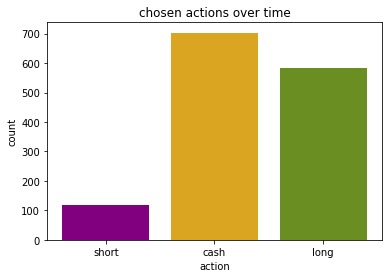

{'short': 117, 'cash': 703, 'long': 584}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x1104357c0>,
 <stable_baselines3.a2c.a2c.A2C at 0x2969b4310>)

In [ ]:
train_agent(tickers[0])

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


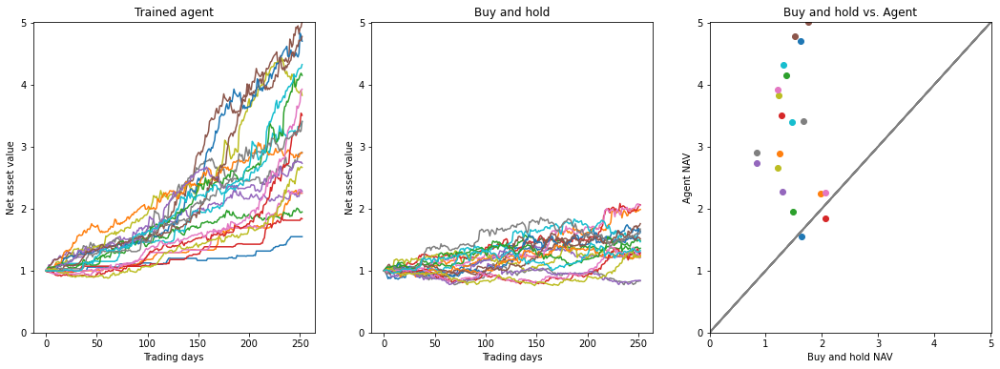

(             agent_avg  market_avg  agent_better
return        3.216239    1.453611           0.9
return_risk   0.992119    0.735080           1.0, array([1.54639104, 2.24880701, 1.9465193 , 1.83575052, 2.27830359,
       5.01529595, 2.2516513 , 2.90756827, 3.82622529, 3.40232165,
       4.69911463, 2.89450954, 4.14834746, 3.50408304, 2.72929962,
       4.77373772, 3.92507525, 3.4049555 , 2.66429192, 4.32253936]), array([1.63774738, 1.98471952, 1.48375062, 2.06002193, 1.29776044,
       1.75612944, 2.05519524, 0.83641119, 1.23004124, 1.46375674,
       1.61332349, 1.24796073, 1.35955045, 1.27595651, 0.83674825,
       1.51136808, 1.20831517, 1.67051734, 1.22007119, 1.32287064]))


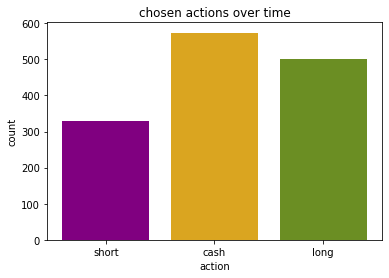

{'short': 329, 'cash': 574, 'long': 501}


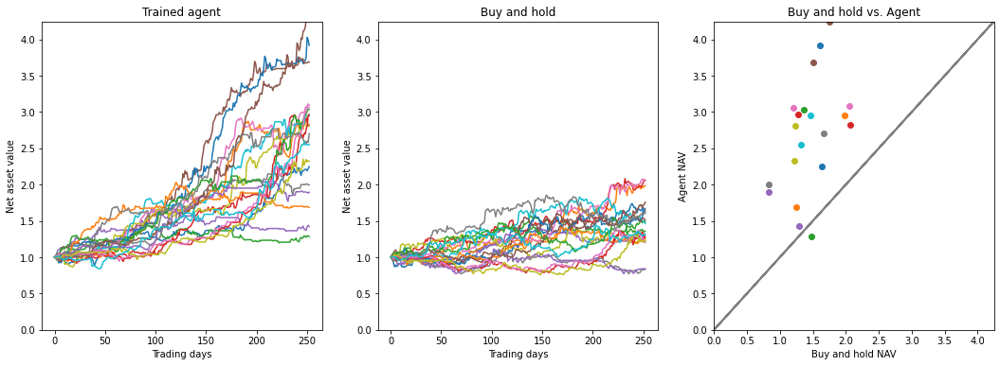

(             agent_avg  market_avg  agent_better
return        2.681543    1.453611          0.95
return_risk   1.032663    0.735080          1.00, array([2.24640562, 2.94749727, 1.28354236, 2.81711503, 1.42413155,
       4.2460393 , 3.08906498, 1.99659849, 2.80711667, 2.9472084 ,
       3.9182275 , 1.68749392, 3.03612354, 2.96677516, 1.89489686,
       3.68782188, 3.062737  , 2.70007464, 2.3221718 , 2.54980942]), array([1.63774738, 1.98471952, 1.48375062, 2.06002193, 1.29776044,
       1.75612944, 2.05519524, 0.83641119, 1.23004124, 1.46375674,
       1.61332349, 1.24796073, 1.35955045, 1.27595651, 0.83674825,
       1.51136808, 1.20831517, 1.67051734, 1.22007119, 1.32287064]))


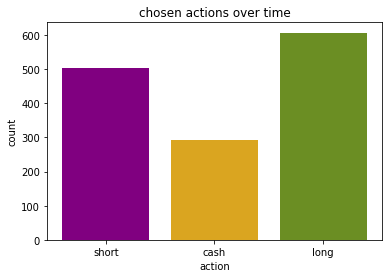

{'short': 504, 'cash': 293, 'long': 607}


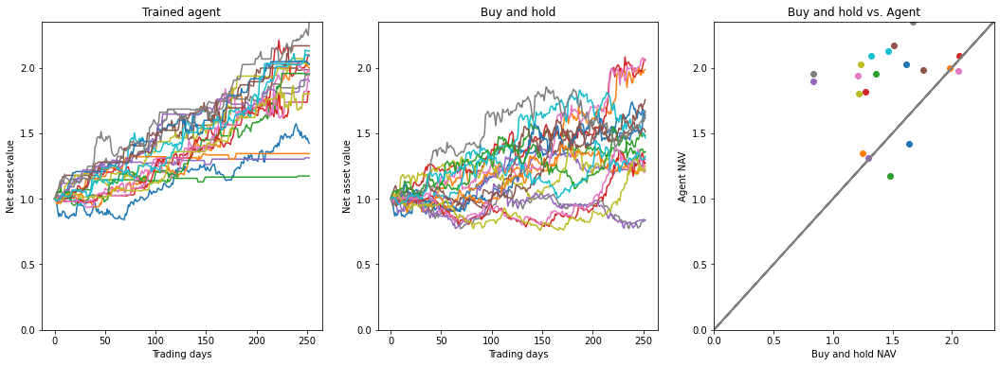

(             agent_avg  market_avg  agent_better
return        1.872995    1.453611          0.85
return_risk   1.296283    0.735080          1.00, array([1.42217098, 2.00014007, 1.17394694, 2.09222463, 1.31241328,
       1.98525102, 1.97347439, 1.95617155, 2.02485829, 2.12858184,
       2.0290307 , 1.34473892, 1.95045204, 1.82014985, 1.89568648,
       2.16703976, 1.94123593, 2.35310366, 1.80001962, 2.08920299]), array([1.63774738, 1.98471952, 1.48375062, 2.06002193, 1.29776044,
       1.75612944, 2.05519524, 0.83641119, 1.23004124, 1.46375674,
       1.61332349, 1.24796073, 1.35955045, 1.27595651, 0.83674825,
       1.51136808, 1.20831517, 1.67051734, 1.22007119, 1.32287064]))


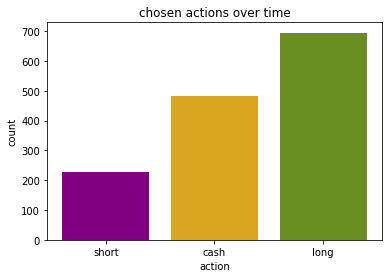

{'short': 228, 'cash': 481, 'long': 695}


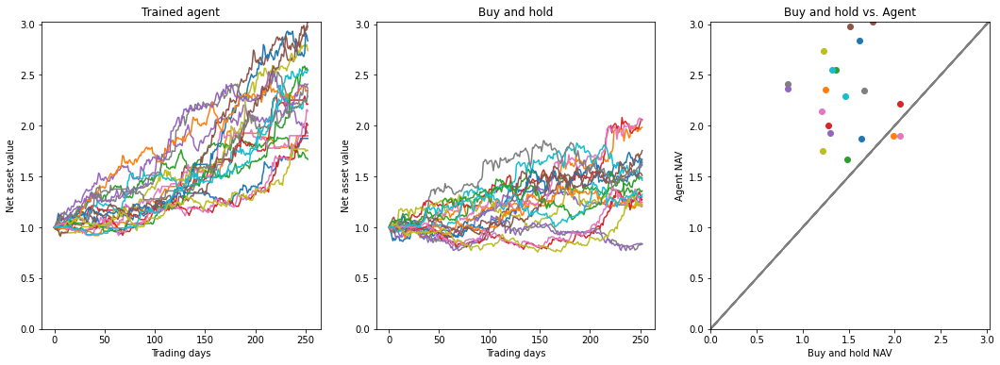

(             agent_avg  market_avg  agent_better
return        2.292655    1.453611           0.9
return_risk   1.128760    0.735080           1.0, array([1.87519286, 1.90035182, 1.67037623, 2.21298607, 1.92794989,
       3.02767634, 1.90254062, 2.41027939, 2.73958831, 2.29486382,
       2.8351129 , 2.35255683, 2.54754268, 2.00654087, 2.36815964,
       2.98020326, 2.14593929, 2.34697258, 1.75516961, 2.55308706]), array([1.63774738, 1.98471952, 1.48375062, 2.06002193, 1.29776044,
       1.75612944, 2.05519524, 0.83641119, 1.23004124, 1.46375674,
       1.61332349, 1.24796073, 1.35955045, 1.27595651, 0.83674825,
       1.51136808, 1.20831517, 1.67051734, 1.22007119, 1.32287064]))


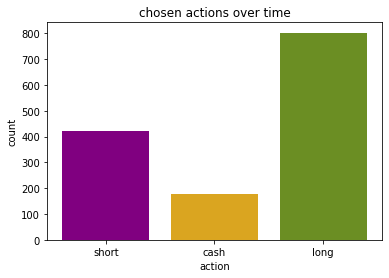

{'short': 423, 'cash': 178, 'long': 803}


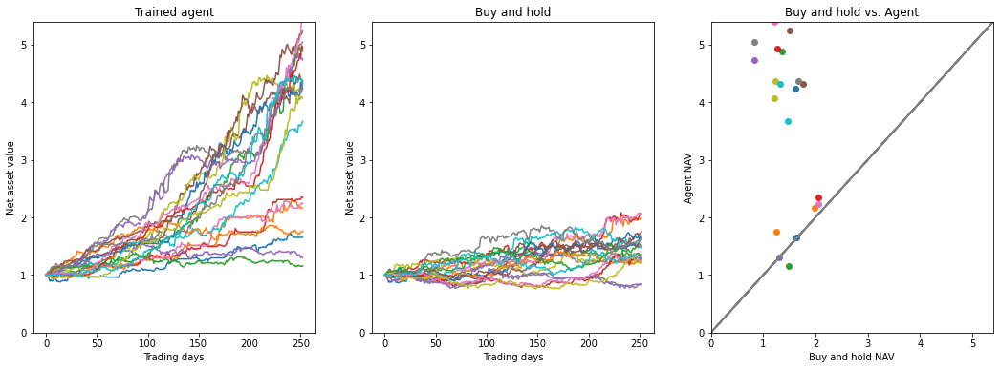

(             agent_avg  market_avg  agent_better
return        3.609420    1.453611          0.95
return_risk   0.986183    0.735080          1.00, array([1.6527171 , 2.15796913, 1.15659972, 2.34533916, 1.30311624,
       4.31450428, 2.23472177, 5.04346069, 4.36773623, 3.66948633,
       4.22760191, 1.75094711, 4.88150427, 4.93142047, 4.73423633,
       5.24580917, 5.39919024, 4.37446042, 4.07264533, 4.32492754]), array([1.63774738, 1.98471952, 1.48375062, 2.06002193, 1.29776044,
       1.75612944, 2.05519524, 0.83641119, 1.23004124, 1.46375674,
       1.61332349, 1.24796073, 1.35955045, 1.27595651, 0.83674825,
       1.51136808, 1.20831517, 1.67051734, 1.22007119, 1.32287064]))


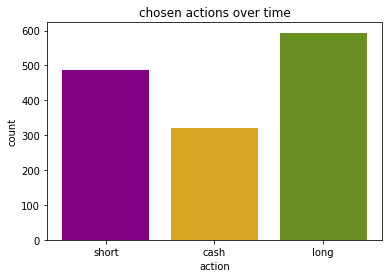

{'short': 488, 'cash': 322, 'long': 594}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x297f71bb0>,
 <stable_baselines3.a2c.a2c.A2C at 0x11003fb50>)

In [ ]:
train_agent(tickers[1])

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


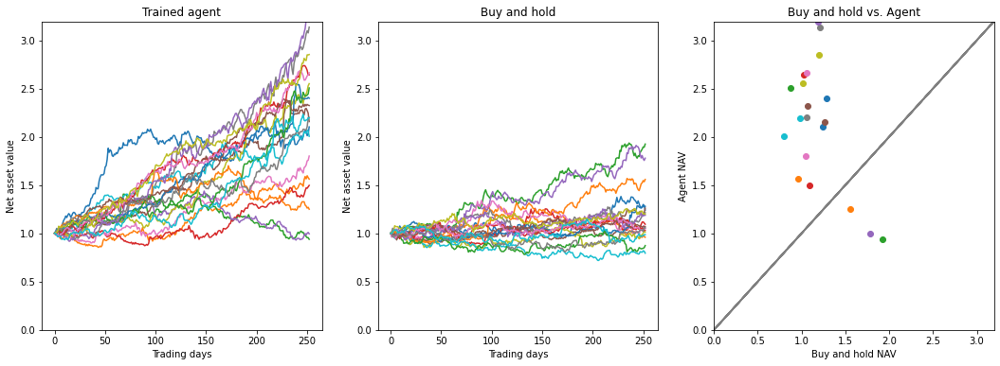

(             agent_avg  market_avg  agent_better
return        2.148293    1.180994          0.85
return_risk   1.103255    0.390001          1.00, array([2.1021785 , 1.56152282, 0.93814793, 1.4963458 , 0.99523691,
       2.15733128, 1.80023219, 3.13533531, 2.54978626, 2.00487939,
       2.3991023 , 1.24973266, 2.50551693, 2.64196805, 3.19478316,
       2.32400246, 2.66301568, 2.19922858, 2.85169762, 2.19580737]), array([1.24011269, 0.95910606, 1.92424435, 1.09425224, 1.77822415,
       1.26058102, 1.05034168, 1.21434319, 1.0125484 , 0.79448033,
       1.27965489, 1.55750053, 0.87289428, 1.03059721, 1.18709357,
       1.06936243, 1.05263806, 1.05644044, 1.1994907 , 0.98597809]))


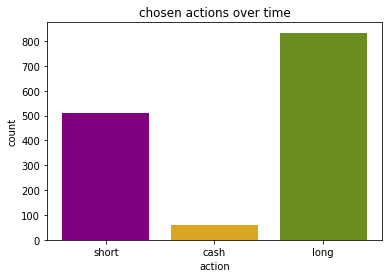

{'short': 512, 'cash': 58, 'long': 834}


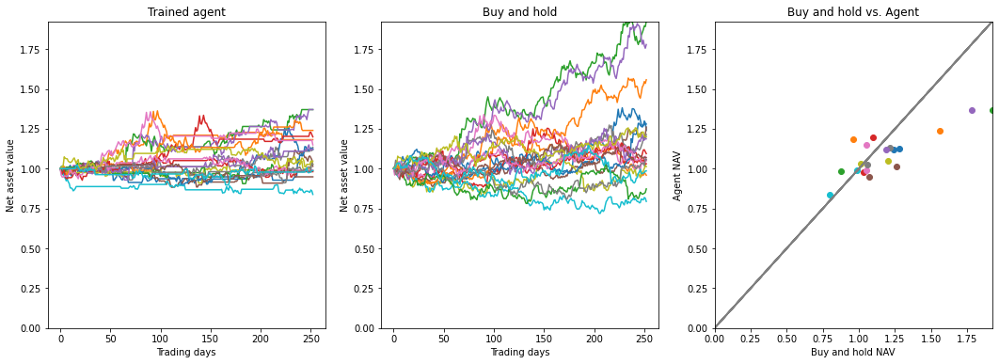

(             agent_avg  market_avg  agent_better
return        1.093104    1.180994          0.35
return_risk   0.371255    0.390001          0.00, array([1.11892302, 1.18173215, 1.37046389, 1.19931871, 1.37046389,
       1.01474378, 1.14904415, 1.1342771 , 1.02844497, 0.83850751,
       1.12528297, 1.23984249, 0.98701298, 0.98101214, 1.12147673,
       0.94866689, 0.99104068, 1.02700721, 1.04704979, 0.98776176]), array([1.24011269, 0.95910606, 1.92424435, 1.09425224, 1.77822415,
       1.26058102, 1.05034168, 1.21434319, 1.0125484 , 0.79448033,
       1.27965489, 1.55750053, 0.87289428, 1.03059721, 1.18709357,
       1.06936243, 1.05263806, 1.05644044, 1.1994907 , 0.98597809]))


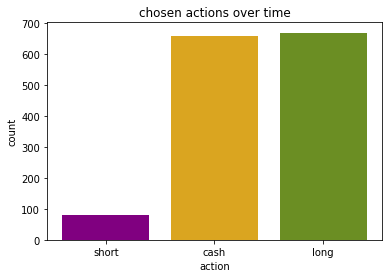

{'short': 80, 'cash': 656, 'long': 668}


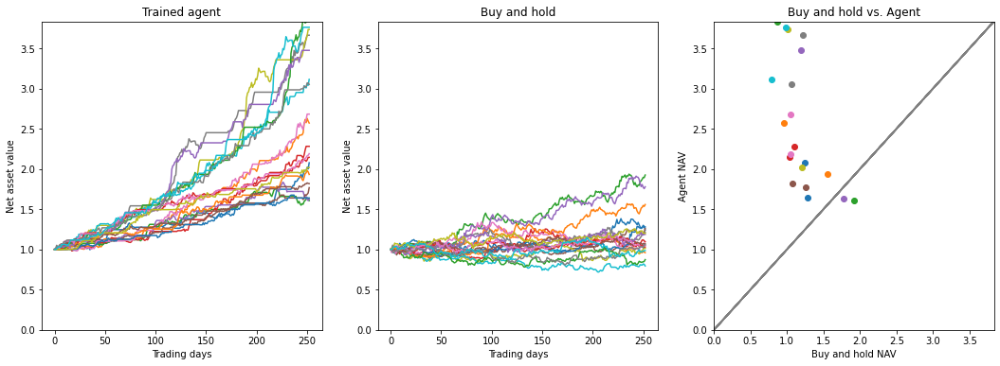

(             agent_avg  market_avg  agent_better
return        2.548511    1.180994           0.9
return_risk   1.114421    0.390001           1.0, array([2.07633997, 2.57021717, 1.60616966, 2.28095922, 1.62590567,
       1.76702936, 2.68118861, 3.66181576, 3.73282618, 3.11230944,
       1.63909401, 1.9317529 , 3.83322739, 2.14396813, 3.4735914 ,
       1.81739318, 2.18872541, 3.05042767, 2.01720728, 3.76007718]), array([1.24011269, 0.95910606, 1.92424435, 1.09425224, 1.77822415,
       1.26058102, 1.05034168, 1.21434319, 1.0125484 , 0.79448033,
       1.27965489, 1.55750053, 0.87289428, 1.03059721, 1.18709357,
       1.06936243, 1.05263806, 1.05644044, 1.1994907 , 0.98597809]))


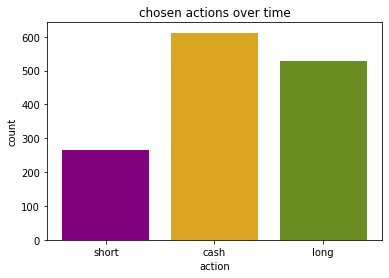

{'short': 264, 'cash': 612, 'long': 528}


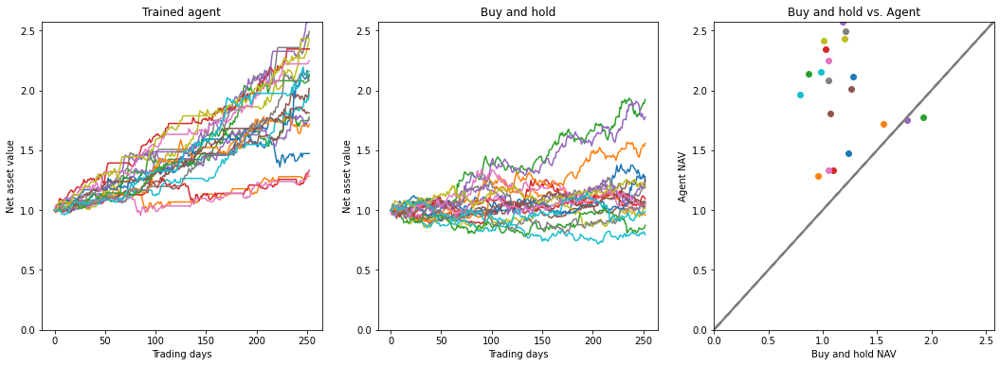

(             agent_avg  market_avg  agent_better
return        1.972959    1.180994           0.9
return_risk   1.242771    0.390001           1.0, array([1.47242351, 1.28441842, 1.77618126, 1.33148203, 1.75277432,
       2.01632422, 1.33254186, 2.49133787, 2.41242815, 1.96417491,
       2.1168567 , 1.71676304, 2.13566287, 2.34537346, 2.57625065,
       1.81033836, 2.2486846 , 2.08509445, 2.43208488, 2.15799042]), array([1.24011269, 0.95910606, 1.92424435, 1.09425224, 1.77822415,
       1.26058102, 1.05034168, 1.21434319, 1.0125484 , 0.79448033,
       1.27965489, 1.55750053, 0.87289428, 1.03059721, 1.18709357,
       1.06936243, 1.05263806, 1.05644044, 1.1994907 , 0.98597809]))


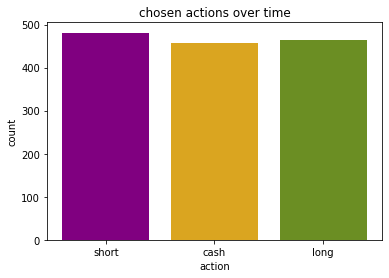

{'short': 481, 'cash': 458, 'long': 465}


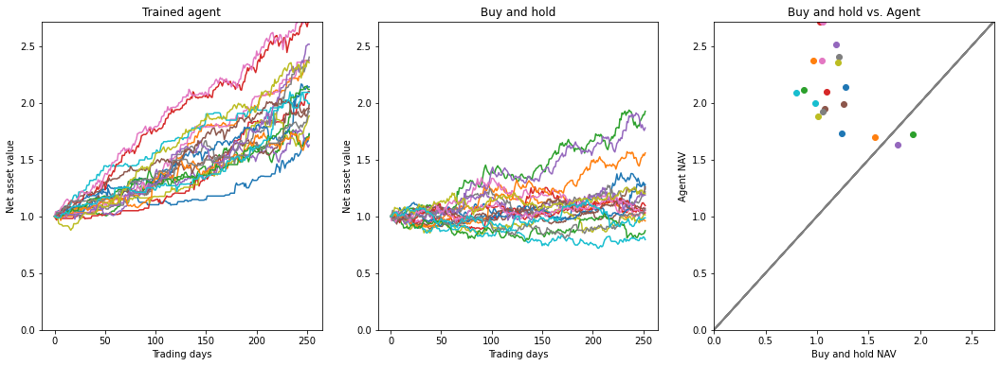

(             agent_avg  market_avg  agent_better
return        2.119258    1.180994           0.9
return_risk   1.289397    0.390001           1.0, array([1.72708751, 2.36988606, 1.72268544, 2.09838   , 1.62760668,
       1.98776288, 2.36842105, 2.4015794 , 1.88370843, 2.09147986,
       2.13907276, 1.69617521, 2.1168044 , 2.70999889, 2.51472268,
       1.94872073, 2.71570402, 1.9200036 , 2.35222371, 1.99312939]), array([1.24011269, 0.95910606, 1.92424435, 1.09425224, 1.77822415,
       1.26058102, 1.05034168, 1.21434319, 1.0125484 , 0.79448033,
       1.27965489, 1.55750053, 0.87289428, 1.03059721, 1.18709357,
       1.06936243, 1.05263806, 1.05644044, 1.1994907 , 0.98597809]))


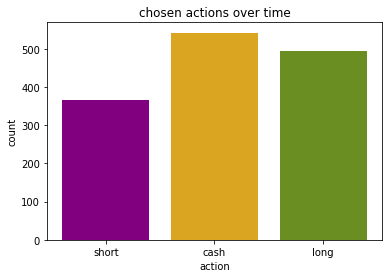

{'short': 367, 'cash': 542, 'long': 495}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x297faac40>,
 <stable_baselines3.a2c.a2c.A2C at 0x297e81550>)

In [ ]:
train_agent(tickers[2])

### 1. Efficiency Ratio : ER

It is designed to account for market noise or volatility.


Efficiency Ratio = Absolute net change in close price movement over N periods / absolute sum of the individual close price changes

$$
ER = \frac{Abs.change}{Abs.volatility}
$$
where

$$
Abs.change = Close_{1} - Close_{n}
$$

$Close_{1}$ is the  starting close price in the period and  $Close_{n}$ is the final close price in the period


and

$$
Abs.volatility = \sum \limits _{t=1} ^{n}|Close_{t} - Close_{t-1}|
$$

$Close_{t}$ is the Close price at day t and $Close_{t-1}$ is Previous day Close price of t.


The absolute price is used because there are positive and negative values(each day may close above or below the previous day close)


Most stocks,will fall somwhere between 100 and - 100. Readings above 30 typically provide a good indication of an uptrend while readings below -30 indicate a downtrend

### 2. Relative Strength Index : RSI

RSI is a well versed momentum based oscillator which is used to measure the speed (velocity) as well as the change (magnitude) of directional price movements. when graphed, it provides a visual mean to monitor both the current, as well as historical, strength and weakness of a particular market.

$$
RSI = 100 \space  – \frac{100}{ (1 + RS)}
$$

where

$$
RS = \frac{Avg Gain(C_t)}{Avg Loss(C_t)}
$$


Avg Gain is Average Gain of n days UP :

$$
\begin{equation*}
Avg Gain(C_t) = \frac{\sum \limits _{t=1} ^{n}Close_{t} - Close_{t-1}}{n}  \quad\quad \text{if  $Close_{t} - Close_{t-1} > 1 \quad else \space  0$}.
\end{equation*}
$$


Avg Loss is Average Loss of n days DOWN :

$$
\begin{equation*}
Avg Loss(C_t) = \frac{\sum \limits _{t=1} ^{n}|Close_{t} - Close_{t-1}|}{n}  \quad\quad \text{for  $Close_{t} - Close_{t-1} < 1 \quad else \space 0 $}.
\end{equation*}
$$

and

n = RSI period (14 days is likely the most popular period)

Specifically, RSI operates between a scale of 0 and 100. The closer RSI is to 0, the weaker the momentum is for price movements. The opposite is also true. An RSI closer to 100 indicates a period of stronger momentum.

RSI > 70 : should be considered overbought  
RSI < 30 : should be considered oversold  
30 < RSI < 70 was to be considered neutral  
RSI around 50 signified “no trend”.

### 3. Weighted Moving Average : WMA

Moving averages are used to see the average price movement over a certain period.WMA gives more weight to current data ie, in an n-day WMA the latest day has weight n, the second latest n-1, etc., down to one.


$$
\begin{equation*}
WMA(P_t) =  \frac {(n -i)\sum \limits _{i=0}^{n-1}p_{t-i}}{\sum \limits _{i=0}^{n-1} n-i}
\quad\quad \text{ =   
$ \quad \space\frac{np_{t} +(n-1)p_{t-1} +(n-2) p_{t-2} + ... + 2p_{((t-n)+2)}+ p_{((t-n)+1)}}{n + (n-1) + ... + 2+1}$}.
\end{equation*}
$$

Where $p$ is the stock price at day 𝑡  and $n$ is the time period for which WMA is calculated.

### 4.Stochastic oscillator : STOCH

A stochastic oscillator is a popular technical indicator for generating overbought and oversold signals.  The term stochastic refers to the point of a current price in relation to its price range over a period of time. This method attempts to predict price turning points by comparing the closing price of a security to its price range.


$$
\begin{equation*}
\%K =  100  \frac{P - Low_{n}}{High_{n} - Low_{n}}
\end{equation*}
$$

Where,  
$P$ is the most recent closing price   
$Low _{n}$ is the lowest price over the last n periods  
$High _{n}$ is the highest price over the last n periods (Typical values for n are 5, 9, or 14 periods)

### 5. Positive volume index : PVI

The positive volume index provides signals for price changes based on positive increases in trading volume. ie, it focuses on days when the volume has increased from the previous day. If volume doesn't increase from one period to the next, the PVI stays the same.  



If today’s volume $V_t$ > $V_{t-1}$ , then:

$$
\begin{equation*}
PVI(C_t) =  PVI(C_{t-1}) +  \frac{Close_t - Close_{t-1}}{Close_{t-1}} PVI(C_{t-1})
\end{equation*}
$$


If today’s volume $V_t$ <= $V_{t-1}$ , then:

$$
\begin{equation*}
PVI(C_t) =  PVI(C_{t-1})
\end{equation*}
$$

Note: If there is no previous PVI calculation, use the price calculation from today as the previous PVI as well.


#### observations

- For TCS, After traing the agent with the selected indicators,eventhough average action taken is long, it started taking short action more than before, maybe because it has only few state variables to observe compared to the above agent.(The agent should have tried to explore a bit)

- While the agent trained for MRF isn't showing any much difference, it has still choosen long action more. comparing to the previous agent where all indicators used ,I would say previous agent did reasonably  than agent with few variables to observe.

- Similarlly we can notice that the agent for Reliance have bought the stocks more whereas earlier agent did better by holding shares most of the time.

- From all these observation , for me, the indicators chosen was not sufficent/good enough for the agent to learn the market environment to take correct actions, eventhough it was much better than the buy and hold starategy.

In [ ]:
ta_indicators_used = ['ER_10', 'RSI_14', 'WMA_10', 'STOCHk_14_3_3', 'PVI_1']

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


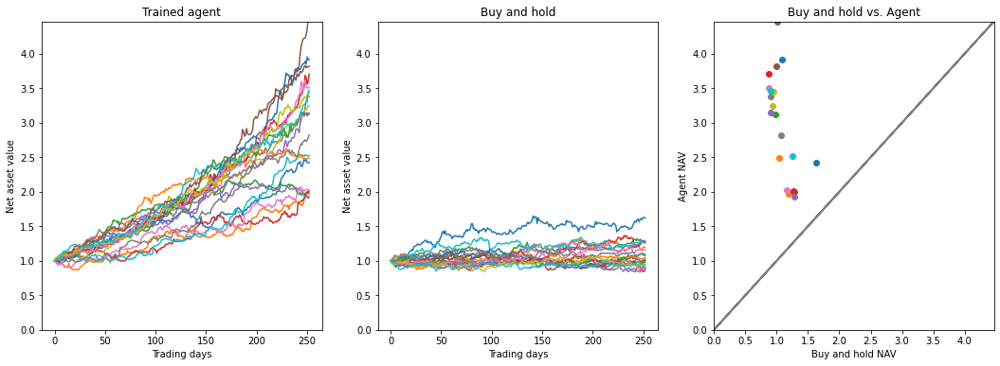

(             agent_avg  market_avg  agent_better
return        2.969406    1.080007           1.0
return_risk   1.245116    0.402057           1.0, array([2.42046678, 1.96770217, 1.99030509, 2.01441885, 1.93151181,
       3.8158457 , 2.02223455, 3.38022337, 3.2465733 , 2.52108141,
       3.91452624, 2.49007799, 3.12288565, 3.70282471, 3.13988873,
       4.46607258, 3.50814248, 2.82044294, 3.44488541, 3.46800236]), array([1.62341455, 1.19242904, 1.28184348, 1.26994559, 1.27568762,
       1.00159726, 1.15873266, 0.90247786, 0.93278014, 1.25854575,
       1.0927875 , 1.03975467, 0.98039602, 0.87651718, 0.89837189,
       1.01616621, 0.87959438, 1.0702706 , 0.94592881, 0.90290176]))


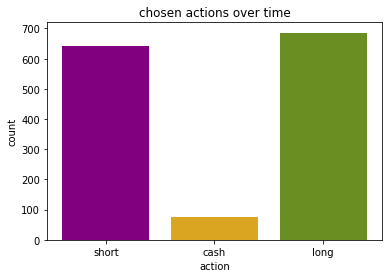

{'short': 641, 'cash': 77, 'long': 686}


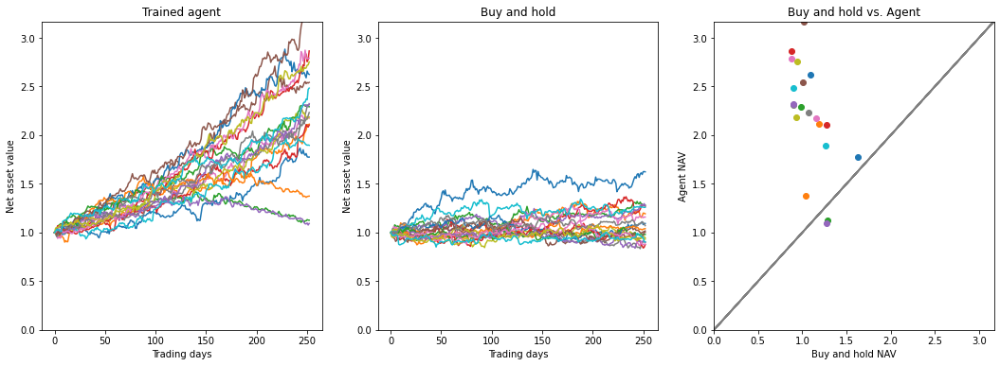

(             agent_avg  market_avg  agent_better
return        2.211252    1.080007           0.9
return_risk   1.241572    0.402057           1.0, array([1.77482038, 2.11273346, 1.1265584 , 2.10277935, 1.09328005,
       2.54195258, 2.17417253, 2.31293182, 2.18653162, 1.89579055,
       2.62401995, 1.37381464, 2.29208409, 2.86449904, 2.32350298,
       3.16815337, 2.78996961, 2.2320961 , 2.75199641, 2.48335468]), array([1.62341455, 1.19242904, 1.28184348, 1.26994559, 1.27568762,
       1.00159726, 1.15873266, 0.90247786, 0.93278014, 1.25854575,
       1.0927875 , 1.03975467, 0.98039602, 0.87651718, 0.89837189,
       1.01616621, 0.87959438, 1.0702706 , 0.94592881, 0.90290176]))


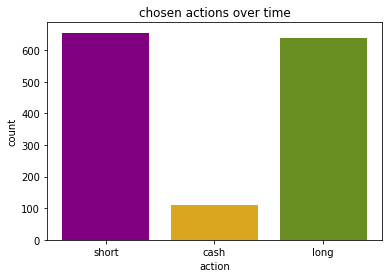

{'short': 655, 'cash': 111, 'long': 638}


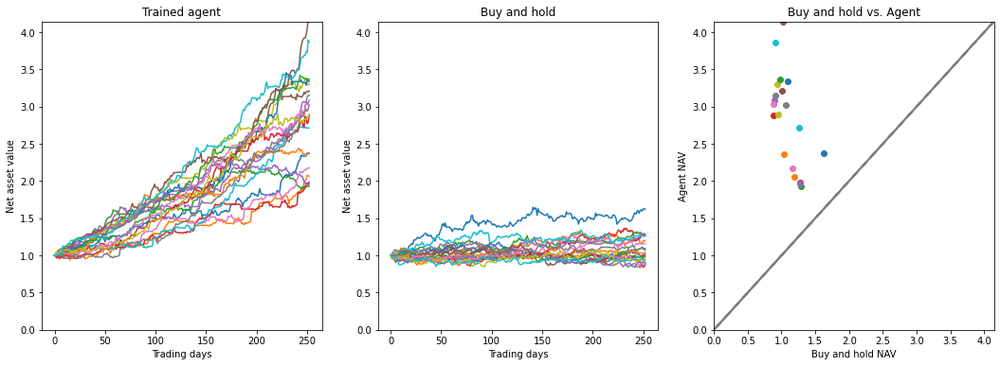

(             agent_avg  market_avg  agent_better
return        2.842458    1.080007           1.0
return_risk   1.266721    0.402057           1.0, array([2.3741984 , 2.06087173, 1.92864609, 1.98486775, 1.96305416,
       3.20876387, 2.1752459 , 3.15023173, 3.29798827, 2.71276598,
       3.34079268, 2.36552434, 3.36618565, 2.88256377, 3.08158461,
       4.14466818, 3.03029846, 3.01759638, 2.89684642, 3.8664583 ]), array([1.62341455, 1.19242904, 1.28184348, 1.26994559, 1.27568762,
       1.00159726, 1.15873266, 0.90247786, 0.93278014, 1.25854575,
       1.0927875 , 1.03975467, 0.98039602, 0.87651718, 0.89837189,
       1.01616621, 0.87959438, 1.0702706 , 0.94592881, 0.90290176]))


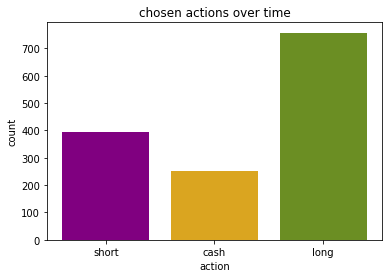

{'short': 394, 'cash': 253, 'long': 757}


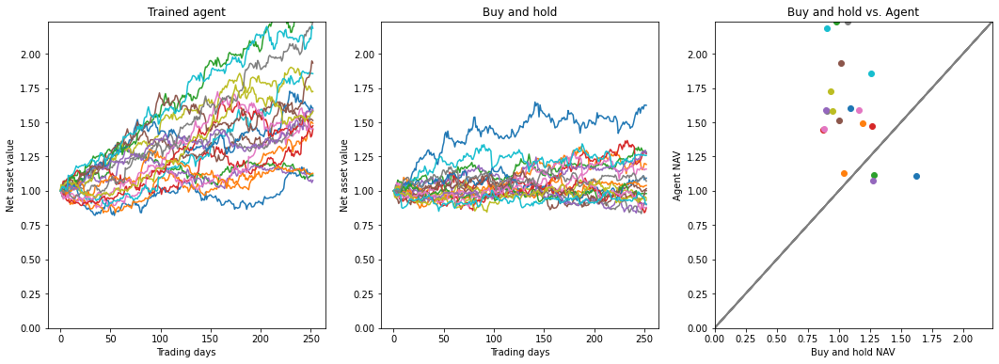

(             agent_avg  market_avg  agent_better
return        1.596043    1.080007          0.85
return_risk   1.014508    0.402057          1.00, array([1.11044349, 1.49204723, 1.11588961, 1.47469985, 1.07671411,
       1.51311182, 1.58618953, 1.58236134, 1.72471486, 1.85450871,
       1.6020437 , 1.12772591, 2.23602022, 1.44856501, 1.58959346,
       1.93212257, 1.4536505 , 2.23566772, 1.57914668, 2.18565354]), array([1.62341455, 1.19242904, 1.28184348, 1.26994559, 1.27568762,
       1.00159726, 1.15873266, 0.90247786, 0.93278014, 1.25854575,
       1.0927875 , 1.03975467, 0.98039602, 0.87651718, 0.89837189,
       1.01616621, 0.87959438, 1.0702706 , 0.94592881, 0.90290176]))


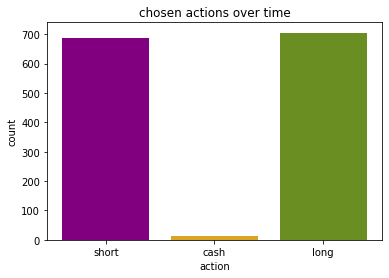

{'short': 686, 'cash': 13, 'long': 705}


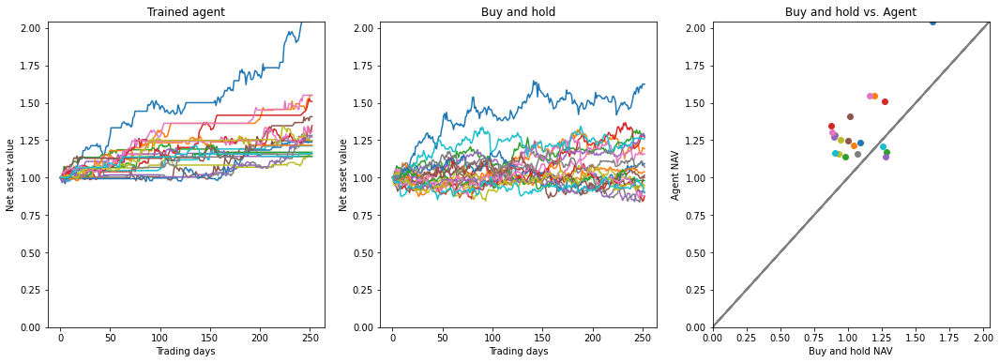

(             agent_avg  market_avg  agent_better
return        1.318317    1.080007          0.85
return_risk   1.116594    0.402057          1.00, array([2.04506332, 1.55047578, 1.16945586, 1.5079291 , 1.14152249,
       1.24612839, 1.55047578, 1.28209895, 1.16066288, 1.21181172,
       1.23692076, 1.21628606, 1.14264818, 1.34743525, 1.27234075,
       1.406966  , 1.30524213, 1.15767015, 1.24970497, 1.16550728]), array([1.62341455, 1.19242904, 1.28184348, 1.26994559, 1.27568762,
       1.00159726, 1.15873266, 0.90247786, 0.93278014, 1.25854575,
       1.0927875 , 1.03975467, 0.98039602, 0.87651718, 0.89837189,
       1.01616621, 0.87959438, 1.0702706 , 0.94592881, 0.90290176]))


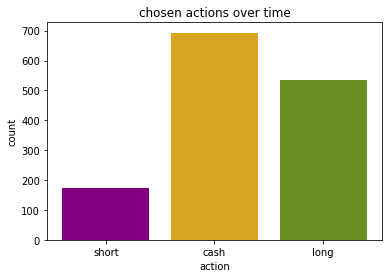

{'short': 175, 'cash': 693, 'long': 536}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x28b8e1a90>,
 <stable_baselines3.a2c.a2c.A2C at 0x28e8e2fa0>)

In [ ]:
#tcs
train_agent(tickers[0] , ta_indicators_used)


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


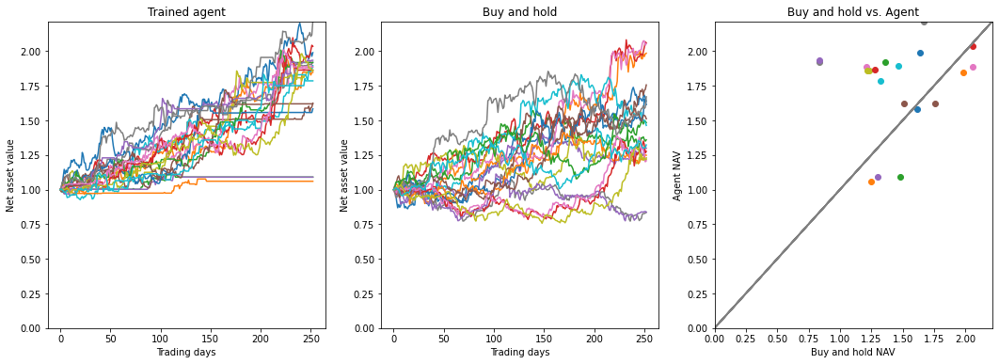

(             agent_avg  market_avg  agent_better
return        1.748115    1.453611           0.6
return_risk   1.161918    0.735080           1.0, array([1.98919884, 1.84655342, 1.09023223, 2.03474396, 1.09023223,
       1.62413039, 1.88467876, 1.9201029 , 1.85825048, 1.89550739,
       1.58338059, 1.06031379, 1.91779737, 1.86339048, 1.93390974,
       1.61957826, 1.88726027, 2.2156562 , 1.86177811, 1.78560226]), array([1.63774643, 1.98471973, 1.48375032, 2.06002194, 1.29776028,
       1.75612975, 2.05519312, 0.83641162, 1.23004116, 1.46375755,
       1.61332346, 1.24796098, 1.35955027, 1.27595712, 0.83674827,
       1.5113679 , 1.20831502, 1.67051616, 1.2200709 , 1.32287126]))


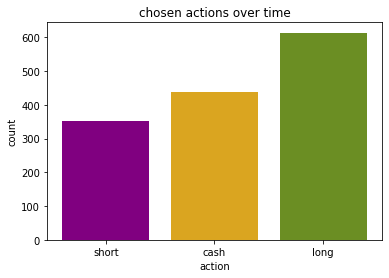

{'short': 352, 'cash': 438, 'long': 614}


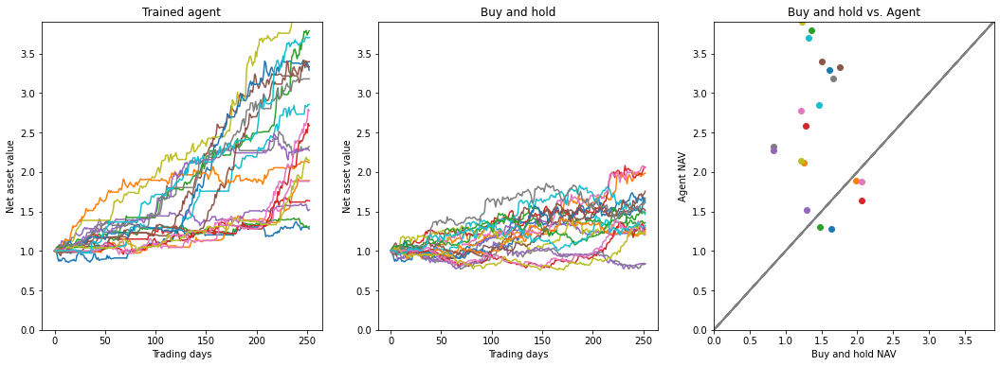

(             agent_avg  market_avg  agent_better
return        2.560007    1.453611          0.75
return_risk   0.924704    0.735080          1.00, array([1.27979131, 1.89082609, 1.30739913, 1.63318252, 1.52327198,
       3.33169103, 1.88257197, 2.32285982, 3.90792847, 2.85491342,
       3.28969963, 2.12233325, 3.78999711, 2.58810713, 2.27375499,
       3.39672388, 2.7755124 , 3.17978506, 2.14773255, 3.7020558 ]), array([1.63774643, 1.98471973, 1.48375032, 2.06002194, 1.29776028,
       1.75612975, 2.05519312, 0.83641162, 1.23004116, 1.46375755,
       1.61332346, 1.24796098, 1.35955027, 1.27595712, 0.83674827,
       1.5113679 , 1.20831502, 1.67051616, 1.2200709 , 1.32287126]))


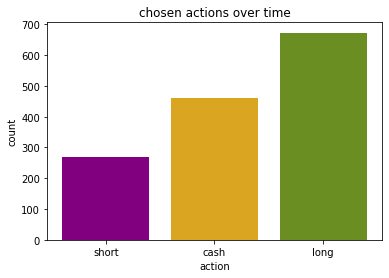

{'short': 269, 'cash': 462, 'long': 673}


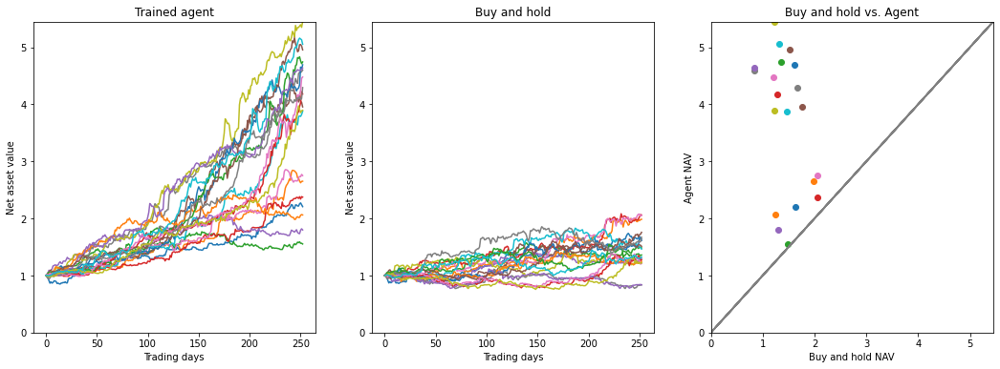

(             agent_avg  market_avg  agent_better
return        3.709421    1.453611           1.0
return_risk   1.066476    0.735080           1.0, array([2.20647765, 2.65169511, 1.5521729 , 2.3726038 , 1.79821157,
       3.95403611, 2.75118733, 4.59873054, 5.44872127, 3.87695277,
       4.69126228, 2.06110093, 4.74123795, 4.17902253, 4.63589345,
       4.95312446, 4.47727904, 4.29262011, 3.89452105, 5.05155916]), array([1.63774643, 1.98471973, 1.48375032, 2.06002194, 1.29776028,
       1.75612975, 2.05519312, 0.83641162, 1.23004116, 1.46375755,
       1.61332346, 1.24796098, 1.35955027, 1.27595712, 0.83674827,
       1.5113679 , 1.20831502, 1.67051616, 1.2200709 , 1.32287126]))


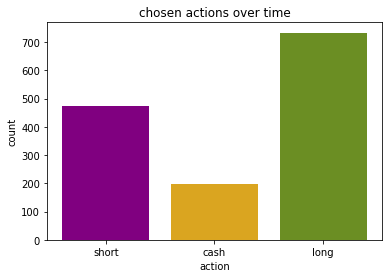

{'short': 472, 'cash': 199, 'long': 733}


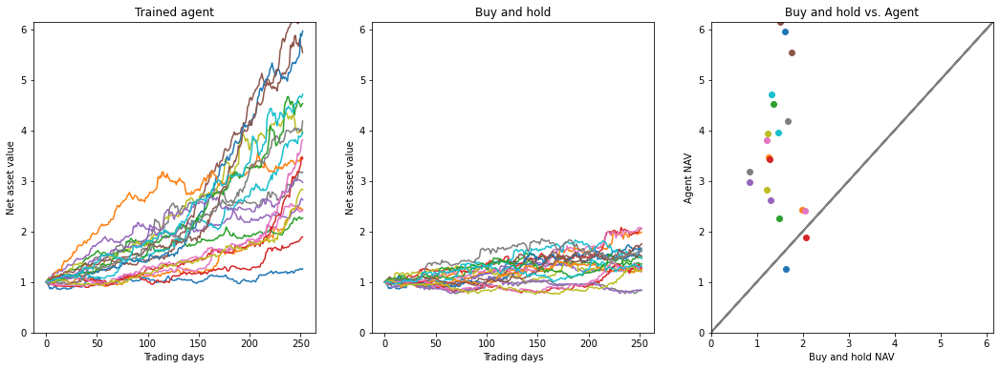

(             agent_avg  market_avg  agent_better
return        3.575363    1.453611           0.9
return_risk   0.939036    0.735080           1.0, array([1.26222257, 2.4318952 , 2.26563372, 1.88933954, 2.62237797,
       5.53817443, 2.4046853 , 3.17319911, 3.92956046, 3.9616113 ,
       5.96132811, 3.46288806, 4.52811341, 3.43476762, 2.96862755,
       6.14871073, 3.80499554, 4.18257322, 2.82527613, 4.7112895 ]), array([1.63774643, 1.98471973, 1.48375032, 2.06002194, 1.29776028,
       1.75612975, 2.05519312, 0.83641162, 1.23004116, 1.46375755,
       1.61332346, 1.24796098, 1.35955027, 1.27595712, 0.83674827,
       1.5113679 , 1.20831502, 1.67051616, 1.2200709 , 1.32287126]))


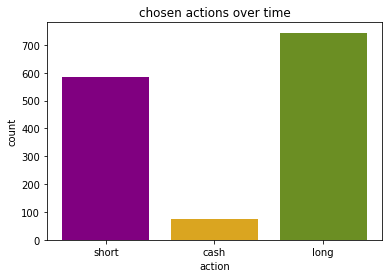

{'short': 585, 'cash': 75, 'long': 744}


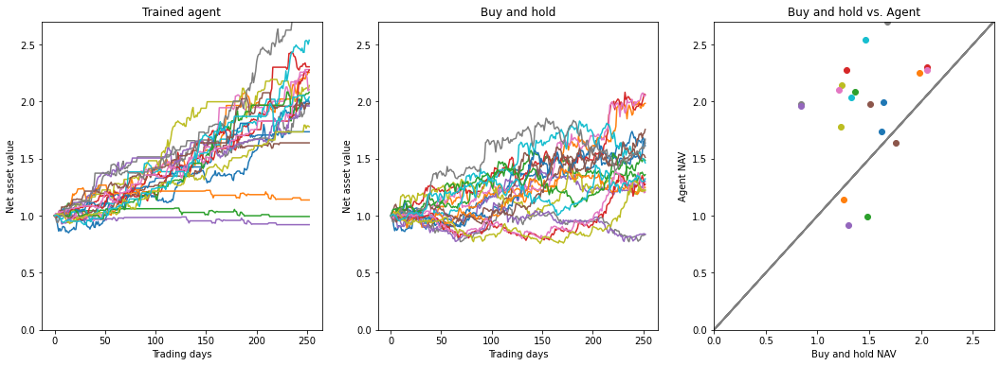

(             agent_avg  market_avg  agent_better
return        1.942659    1.453611           0.8
return_risk   1.128057    0.735080           1.0, array([1.99212105, 2.25597735, 0.99331858, 2.30488762, 0.92151307,
       1.63859152, 2.28051391, 1.98092212, 2.14112402, 2.5381335 ,
       1.73554564, 1.13814544, 2.08289029, 2.27652047, 1.96190127,
       1.98269529, 2.10492952, 2.70257362, 1.78014588, 2.04073533]), array([1.63774643, 1.98471973, 1.48375032, 2.06002194, 1.29776028,
       1.75612975, 2.05519312, 0.83641162, 1.23004116, 1.46375755,
       1.61332346, 1.24796098, 1.35955027, 1.27595712, 0.83674827,
       1.5113679 , 1.20831502, 1.67051616, 1.2200709 , 1.32287126]))


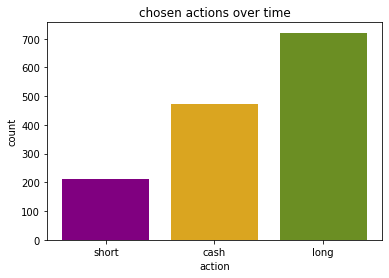

{'short': 210, 'cash': 473, 'long': 721}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x28ead61c0>,
 <stable_baselines3.a2c.a2c.A2C at 0x28eb13af0>)

In [ ]:
#mrf
train_agent(tickers[1] , ta_indicators_used)


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


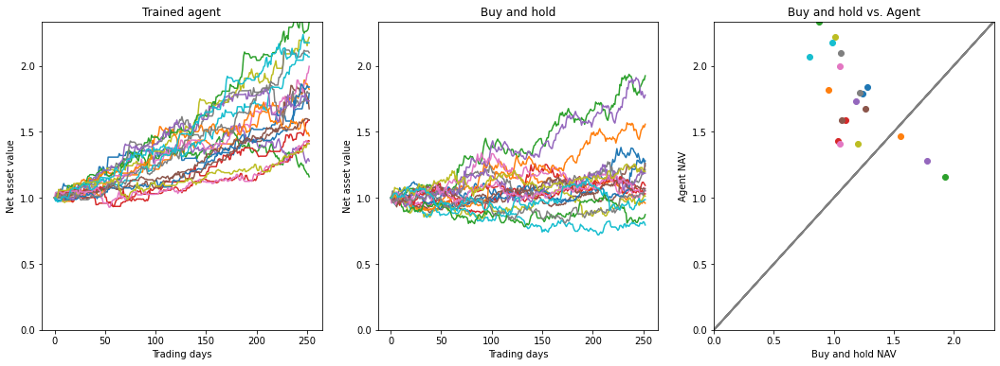

(             agent_avg  market_avg  agent_better
return        1.743964    1.180994          0.85
return_risk   1.186240    0.390001          1.00, array([1.79103776, 1.82113819, 1.15934919, 1.58829347, 1.27938024,
       1.67458925, 1.99546303, 1.79275181, 2.21552624, 2.06796144,
       1.83966595, 1.46928385, 2.33608928, 1.43074432, 1.73400137,
       1.59134998, 1.40770863, 2.09884343, 1.41184673, 2.1742529 ]), array([1.24011261, 0.95910628, 1.92424447, 1.09425238, 1.77822428,
       1.26058086, 1.0503416 , 1.21434327, 1.01254854, 0.79448029,
       1.27965456, 1.55750065, 0.87289433, 1.03059714, 1.18709349,
       1.06936243, 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


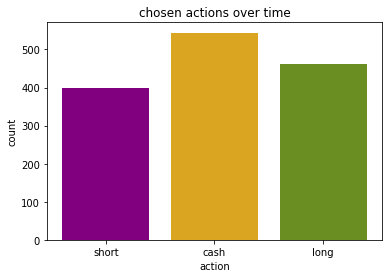

{'short': 398, 'cash': 544, 'long': 462}


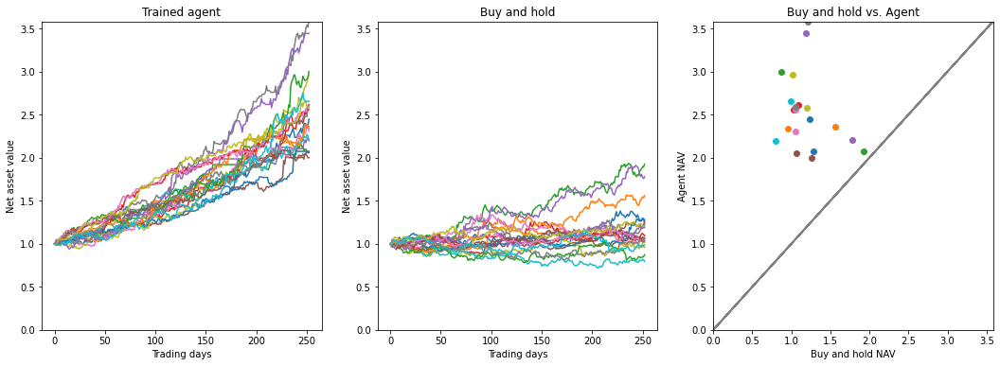

(             agent_avg  market_avg  agent_better
return        2.529092    1.180994           1.0
return_risk   1.331647    0.390001           1.0, array([2.44621338, 2.33868274, 2.0709722 , 2.61663737, 2.20116996,
       1.99928072, 2.30790189, 3.58200967, 2.95866385, 2.19752197,
       2.07313071, 2.3625636 , 2.99880529, 2.55389959, 3.44216601,
       2.05541574, 2.55782229, 2.58849981, 2.57704319, 2.65344397]), array([1.24011261, 0.95910628, 1.92424447, 1.09425238, 1.77822428,
       1.26058086, 1.0503416 , 1.21434327, 1.01254854, 0.79448029,
       1.27965456, 1.55750065, 0.87289433, 1.03059714, 1.18709349,
       1.06936243, 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


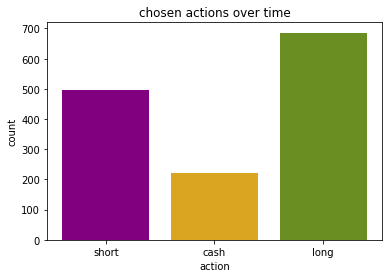

{'short': 496, 'cash': 222, 'long': 686}


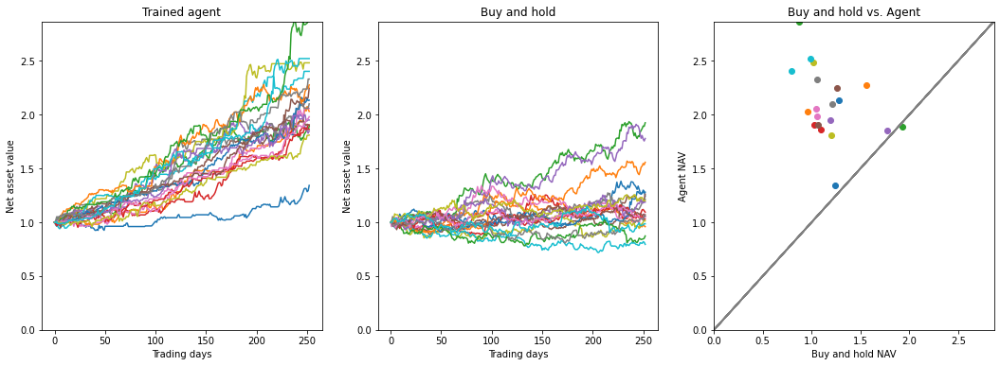

(             agent_avg  market_avg  agent_better
return        2.096958    1.180994          0.95
return_risk   1.228667    0.390001          1.00, array([1.34212512, 2.03020754, 1.89142111, 1.86410996, 1.8495171 ,
       2.24524925, 2.05730598, 2.09974646, 2.48151735, 2.40244947,
       2.1340777 , 2.27621947, 2.86632042, 1.90494999, 1.94978047,
       1.90182788, 1.98087134, 2.33047911, 1.8097855 , 2.52120694]), array([1.24011261, 0.95910628, 1.92424447, 1.09425238, 1.77822428,
       1.26058086, 1.0503416 , 1.21434327, 1.01254854, 0.79448029,
       1.27965456, 1.55750065, 0.87289433, 1.03059714, 1.18709349,
       1.06936243, 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


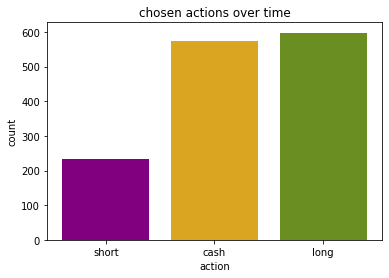

{'short': 233, 'cash': 573, 'long': 598}


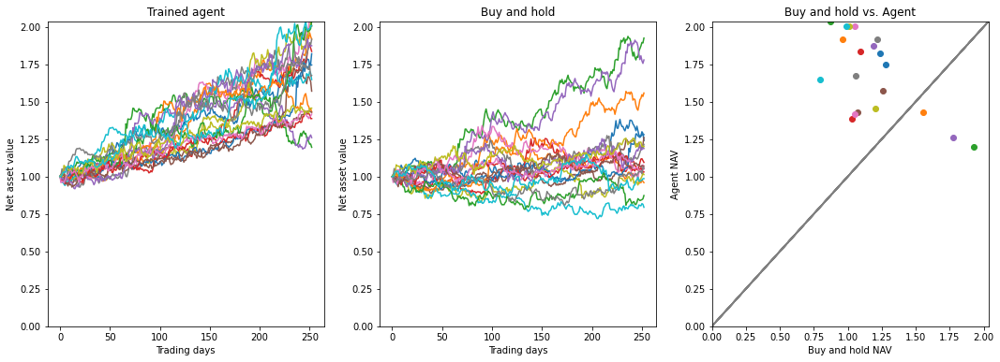

(             agent_avg  market_avg  agent_better
return        1.681217    1.180994          0.85
return_risk   1.292105    0.390001          1.00, array([1.81960724, 1.91674541, 1.19501816, 1.83509324, 1.25964261,
       1.56988672, 2.00398038, 1.91606935, 2.0058094 , 1.64716447,
       1.74481884, 1.43001666, 2.0370613 , 1.38673835, 1.87307289,
       1.42943542, 1.41639571, 1.67503403, 1.4564304 , 2.00630972]), array([1.24011261, 0.95910628, 1.92424447, 1.09425238, 1.77822428,
       1.26058086, 1.0503416 , 1.21434327, 1.01254854, 0.79448029,
       1.27965456, 1.55750065, 0.87289433, 1.03059714, 1.18709349,
       1.06936243, 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


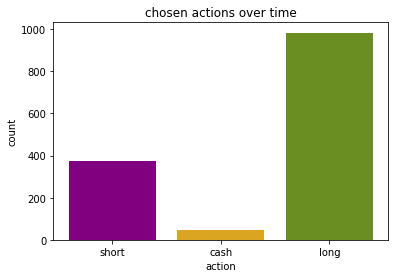

{'short': 376, 'cash': 45, 'long': 983}


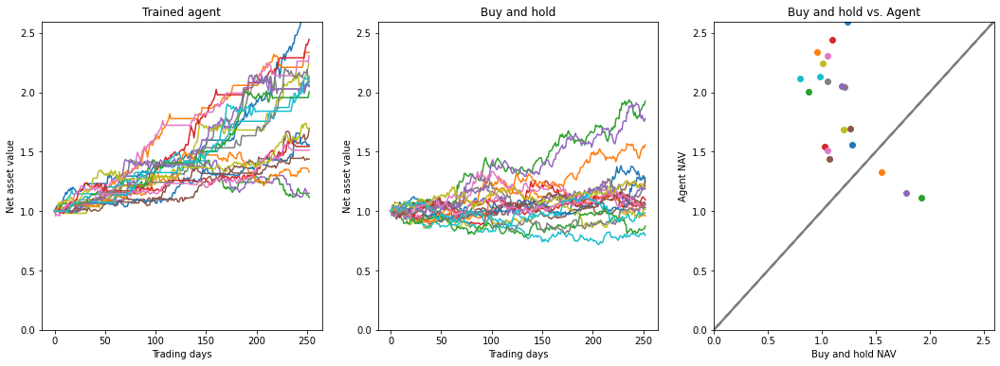

(             agent_avg  market_avg  agent_better
return        1.869818    1.180994          0.85
return_risk   1.206140    0.390001          1.00, array([2.5964774 , 2.335538  , 1.11364113, 2.44512005, 1.14977796,
       1.6962308 , 2.30696161, 2.04737222, 2.2407511 , 2.11853108,
       1.55692137, 1.32856737, 2.00421258, 1.54359101, 2.05315296,
       1.43627004, 1.512013  , 2.08884857, 1.68948244, 2.13289887]), array([1.24011261, 0.95910628, 1.92424447, 1.09425238, 1.77822428,
       1.26058086, 1.0503416 , 1.21434327, 1.01254854, 0.79448029,
       1.27965456, 1.55750065, 0.87289433, 1.03059714, 1.18709349,
       1.06936243, 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


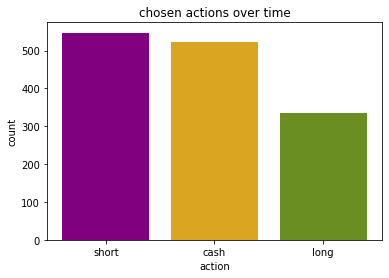

{'short': 547, 'cash': 522, 'long': 335}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x28f0b44f0>,
 <stable_baselines3.a2c.a2c.A2C at 0x28ea1f190>)

In [ ]:
#reliance
train_agent(tickers[2] , ta_indicators_used)


## 4.  reduce the dimensionality of the state space and select a few technical indicators.
We will select indicators which correlate the most to tomorrow's log-return of the close price.

##### observations

-  As before, the agent trained for TCS is still doing better than the rest of the companies, with an average better performance of 0.9 than the buy and hold. Compared to earlier agent performance, there is not much difference with the first agent trained with all indicators but better than taking random indicator values to observe. Could see some of the best indicators in the highest correlation. I took the 20 most correlated ones since when trained for more than 20 (30,40) it was not doing better as expected.

- Whereas the average performance of MRF agents could see reduced (average is 0.7%) once trained with correlated indicators which I think is because, despite a large correlation, it was not logically useful for the agent.

- The agent for Reliance performed almost the same as the earlier agent which was trained with random indicators.

What I came to realize is that I should have tried other ways rather than blindly trusting correlation for selecting the indicators which was not much useful.

In [ ]:
def generate_indicators(ticker_name):
    ticker = yf.Ticker(ticker_name)
    df_raw = ticker.history(start = '2012-01-01', end = '2017-12-31')
    df = df_raw.copy()
    df = df[['Open', 'High', 'Low', 'Close', 'Volume']]
    df.loc[:, 'returns'] = np.log(df.Close) - np.log(df.Close.shift(1))
    df.loc[:, 'returns_target'] = df.returns.shift(-1)
    df.ta.strategy()
    df.drop(['DPO_20', 'ISA_9', 'ISB_26', 'ITS_9', 'ICS_26', 'IKS_26'], axis = 1, inplace = True)
    cols_to_drop = df.columns[df.isnull().mean() > 0.05]
    df.drop(cols_to_drop, axis = 1, inplace = True)
    df.dropna(inplace = True)
    most_corr_indicators = df.corr(method = 'pearson').returns_target.abs().sort_values(ascending = False)[1:21].index.to_list()
    return most_corr_indicators

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


['AO_5_34', 'MACD_12_26_9', 'STCmacd_10_12_26_0.5', 'PDIST', 'SUPERTd_7_3.0', 'MACDs_12_26_9', 'BULLP_13', 'HWU', 'HWM', 'HWMA_0.2_0.1_0.1', 'HWL', 'QQE_14_5_4.236_RSIMA', 'QQE_14_5_4.236', 'high_Z_30_1', 'TSI_13_25_13', 'SMIs_5_20_5', 'DMP_14', 'HMA_10', 'SMI_5_20_5', 'ZL_EMA_10']


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


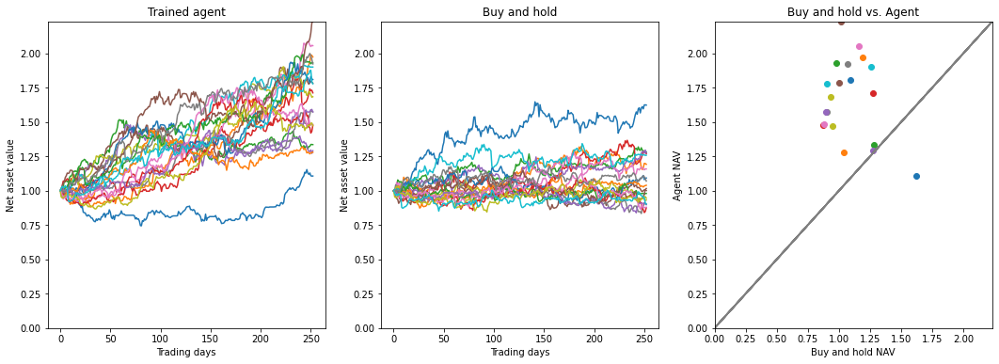

(             agent_avg  market_avg  agent_better
return        1.669216    1.080007          0.95
return_risk   1.157320    0.402058          1.00, array([1.10729517, 1.97357224, 1.3359476 , 1.71281559, 1.29146809,
       1.78302602, 2.05649344, 1.57389901, 1.68484514, 1.90066695,
       1.80966085, 1.27990499, 1.93125621, 1.47709955, 1.57392731,
       2.23384791, 1.48228576, 1.92356006, 1.47376127, 1.77899092]), array([1.62341458, 1.1924289 , 1.2818434 , 1.2699456 , 1.27568774,
       1.00159771, 1.15873238, 0.90247809, 0.93278057, 1.25854632,
       1.09278688, 1.03975467, 0.98039613, 0.87651728, 0.89837168,
       1.01616667, 0.8795948 , 1.07027004, 0.94592859, 0.90290231]))


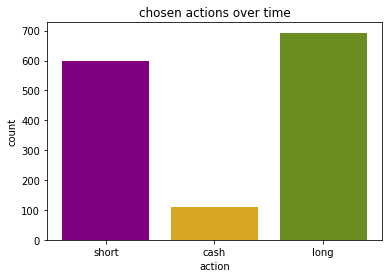

{'short': 600, 'cash': 111, 'long': 693}


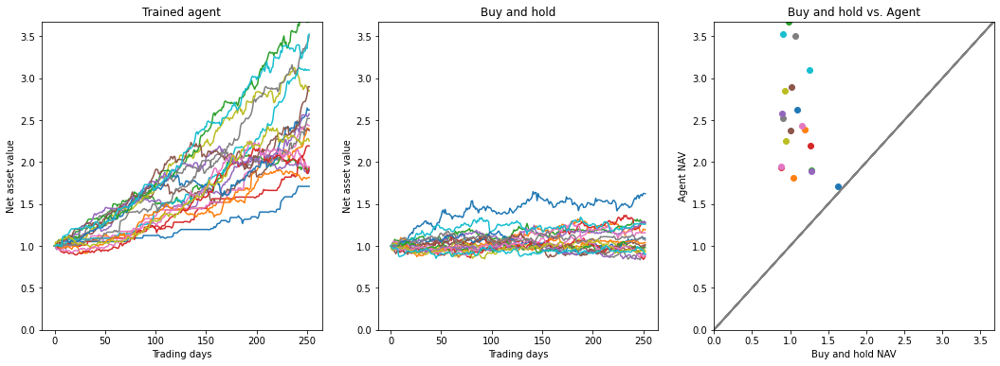

(             agent_avg  market_avg  agent_better
return        2.505302    1.080007           1.0
return_risk   1.216640    0.402058           1.0, array([1.71032735, 2.38737566, 1.90556773, 2.19218636, 1.89172131,
       2.37505119, 2.43383616, 2.51902855, 2.85082873, 3.09524856,
       2.62039241, 1.81631681, 3.6757421 , 1.9373069 , 2.57446775,
       2.89789951, 1.94410893, 3.50306056, 2.25085944, 3.52471773]), array([1.62341458, 1.1924289 , 1.2818434 , 1.2699456 , 1.27568774,
       1.00159771, 1.15873238, 0.90247809, 0.93278057, 1.25854632,
       1.09278688, 1.03975467, 0.98039613, 0.87651728, 0.89837168,
       1.01616667, 0.8795948 , 1.07027004, 0.94592859, 0.90290231]))


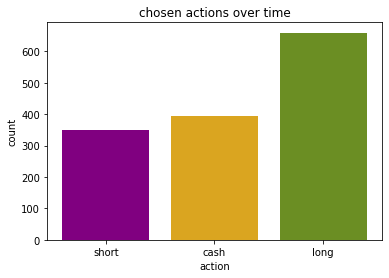

{'short': 351, 'cash': 394, 'long': 659}


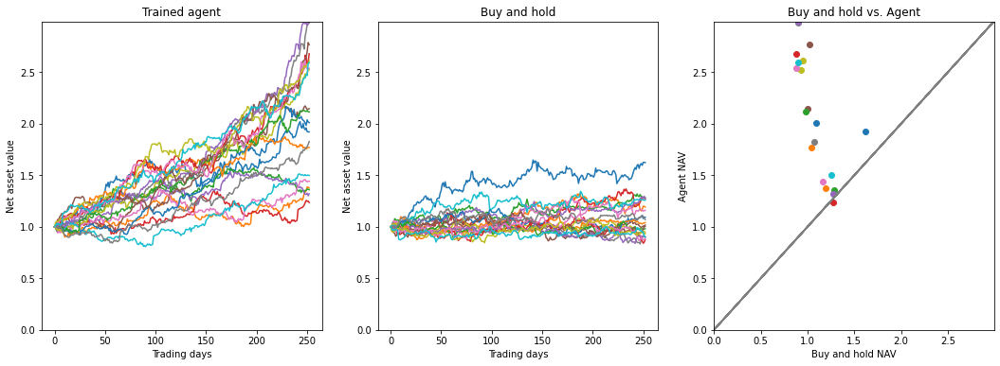

(             agent_avg  market_avg  agent_better
return        2.085205    1.080007          0.95
return_risk   1.119142    0.402058          1.00, array([1.9207919 , 1.37561992, 1.36016236, 1.23577346, 1.32057467,
       2.14644025, 1.44129814, 2.97877562, 2.52313886, 1.49829699,
       2.01074938, 1.77053053, 2.11429012, 2.67857637, 2.99239143,
       2.76582577, 2.53774606, 1.82627078, 2.61335596, 2.59350051]), array([1.62341458, 1.1924289 , 1.2818434 , 1.2699456 , 1.27568774,
       1.00159771, 1.15873238, 0.90247809, 0.93278057, 1.25854632,
       1.09278688, 1.03975467, 0.98039613, 0.87651728, 0.89837168,
       1.01616667, 0.8795948 , 1.07027004, 0.94592859, 0.90290231]))


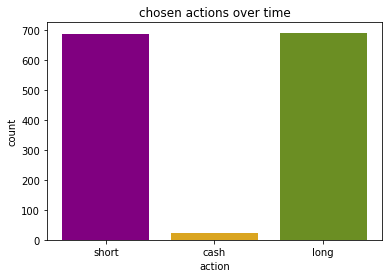

{'short': 689, 'cash': 23, 'long': 692}


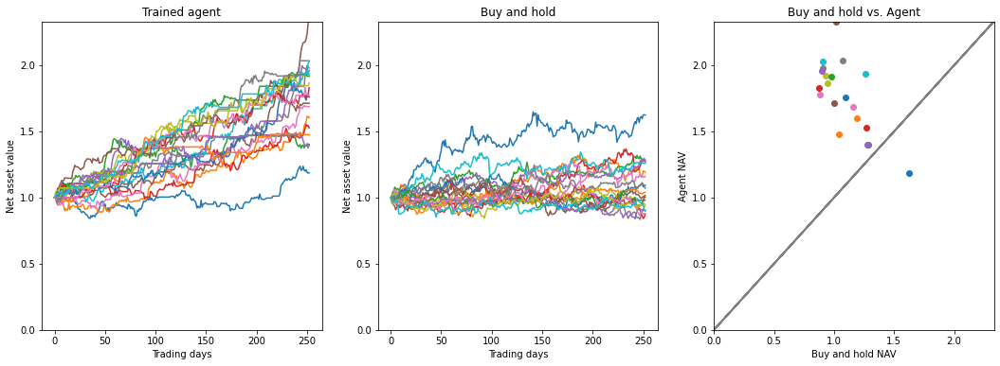

(             agent_avg  market_avg  agent_better
return        1.766124    1.080007          0.95
return_risk   1.285638    0.402058          1.00, array([1.18642441, 1.60204574, 1.40225315, 1.52659656, 1.39631151,
       1.71276017, 1.68659435, 1.97814191, 1.92149775, 1.93464454,
       1.75873548, 1.47492965, 1.91669425, 1.83012364, 1.95996865,
       2.33087573, 1.77739223, 2.03359143, 1.86510538, 2.02780306]), array([1.62341458, 1.1924289 , 1.2818434 , 1.2699456 , 1.27568774,
       1.00159771, 1.15873238, 0.90247809, 0.93278057, 1.25854632,
       1.09278688, 1.03975467, 0.98039613, 0.87651728, 0.89837168,
       1.01616667, 0.8795948 , 1.07027004, 0.94592859, 0.90290231]))


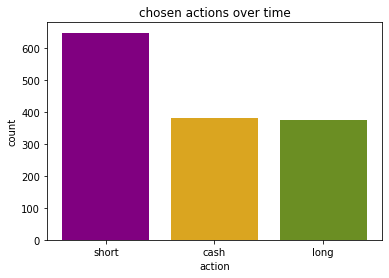

{'short': 648, 'cash': 382, 'long': 374}


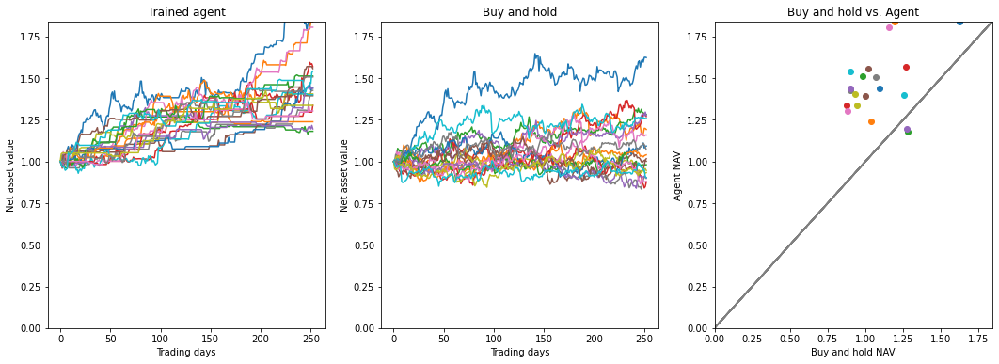

(             agent_avg  market_avg  agent_better
return        1.463570    1.080007           0.9
return_risk   1.424506    0.402058           1.0, array([1.84128864, 1.83977509, 1.1810168 , 1.56870749, 1.19553152,
       1.39439967, 1.80554163, 1.42641754, 1.4054766 , 1.40035195,
       1.44063397, 1.23813735, 1.5125789 , 1.33637853, 1.43874592,
       1.55740917, 1.3030938 , 1.50719255, 1.33665959, 1.54206034]), array([1.62341458, 1.1924289 , 1.2818434 , 1.2699456 , 1.27568774,
       1.00159771, 1.15873238, 0.90247809, 0.93278057, 1.25854632,
       1.09278688, 1.03975467, 0.98039613, 0.87651728, 0.89837168,
       1.01616667, 0.8795948 , 1.07027004, 0.94592859, 0.90290231]))


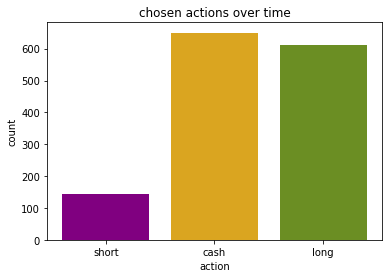

{'short': 143, 'cash': 650, 'long': 611}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x28dc9f130>,
 <stable_baselines3.a2c.a2c.A2C at 0x28ed62ac0>)

In [ ]:
most_corr_indicators = generate_indicators(tickers[0])
print(most_corr_indicators)
train_agent(tickers[0] , most_corr_indicators)


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


['BBP_5_2.0', 'BBB_5_2.0', 'CDL_EVENINGDOJISTAR', 'CDL_SEPARATINGLINES', 'CDL_ADVANCEBLOCK', 'INC_1', 'DEC_1', 'STOCHRSIk_14_14_3_3', 'TTM_TRND_6', 'PGO_14', 'PCTRET_1', 'SMIo_5_20_5', 'returns', 'LOGRET_1', 'J_9_3', 'WILLR_14', 'close_Z_30_1', 'ZS_30', 'CCI_14_0.015', 'RVI_14']


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


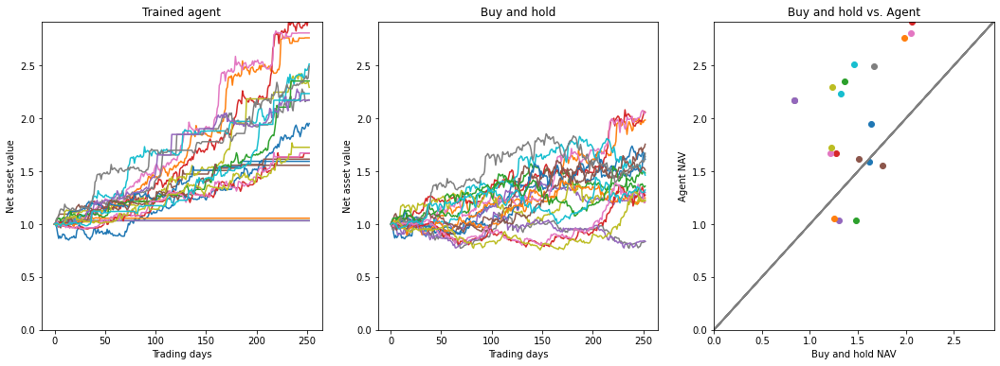

(             agent_avg  market_avg  agent_better
return        1.981947    1.453611          0.75
return_risk   0.994287    0.735080          1.00, array([1.95263745, 2.76222886, 1.03275526, 2.91763176, 1.03275526,
       1.55677579, 2.80855723, 2.1758694 , 2.29376985, 2.51469381,
       1.59420642, 1.05602557, 2.35400747, 1.67054633, 2.17211817,
       1.61498986, 1.67328344, 2.49429518, 1.72671302, 2.23507226]), array([1.63774618, 1.98471973, 1.48375037, 2.06002218, 1.29776049,
       1.75612913, 2.05519439, 0.83641181, 1.23004136, 1.46375654,
       1.61332275, 1.24796081, 1.35955054, 1.27595671, 0.83674836,
       1.51136802, 1.2083149 , 1.67051682, 1.22007102, 1.32287076]))


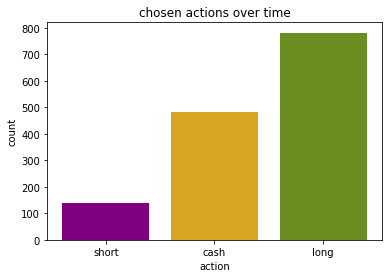

{'short': 140, 'cash': 483, 'long': 781}


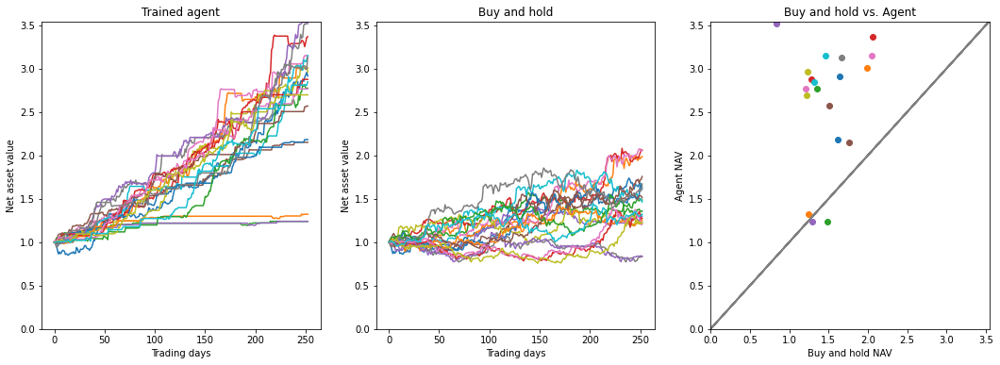

(             agent_avg  market_avg  agent_better
return        2.670387    1.453611           0.9
return_risk   1.214133    0.735080           1.0, array([2.91424049, 3.00596955, 1.24000561, 3.36769449, 1.24000561,
       2.15083663, 3.14993648, 3.54446035, 2.96105613, 3.15227887,
       2.18229477, 1.32145541, 2.77409308, 2.87577151, 3.51660699,
       2.56836693, 2.7660601 , 3.13158944, 2.69762916, 2.84739536]), array([1.63774618, 1.98471973, 1.48375037, 2.06002218, 1.29776049,
       1.75612913, 2.05519439, 0.83641181, 1.23004136, 1.46375654,
       1.61332275, 1.24796081, 1.35955054, 1.27595671, 0.83674836,
       1.51136802, 1.2083149 , 1.67051682, 1.22007102, 1.32287076]))


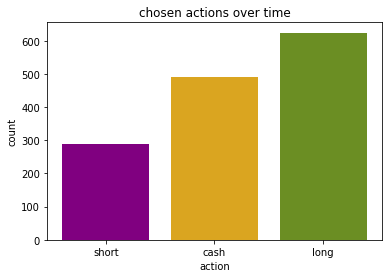

{'short': 290, 'cash': 490, 'long': 624}


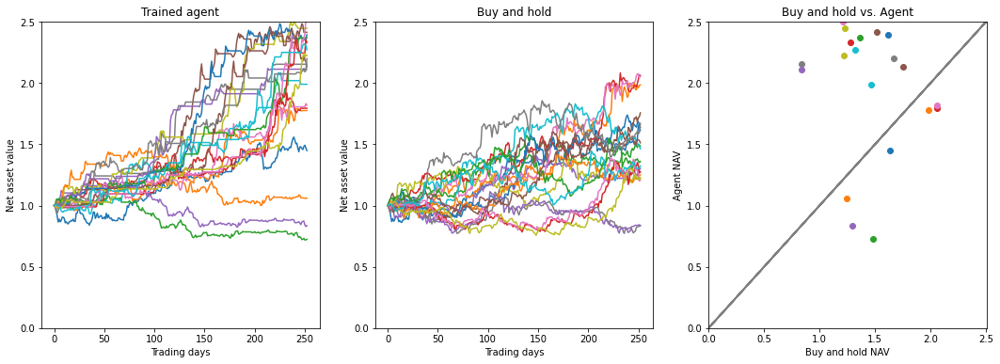

(             agent_avg  market_avg  agent_better
return        1.949518    1.453611          0.65
return_risk   0.934341    0.735080          1.00, array([1.44900919, 1.77534221, 0.72427169, 1.79381932, 0.83625597,
       2.13236512, 1.81838453, 2.15281155, 2.44614506, 1.98947425,
       2.39304826, 1.05993145, 2.367914  , 2.33039172, 2.11247577,
       2.41312225, 2.5032307 , 2.19849777, 2.22284022, 2.27103085]), array([1.63774618, 1.98471973, 1.48375037, 2.06002218, 1.29776049,
       1.75612913, 2.05519439, 0.83641181, 1.23004136, 1.46375654,
       1.61332275, 1.24796081, 1.35955054, 1.27595671, 0.83674836,
       1.51136802, 1.2083149 , 1.67051682, 1.22007102, 1.32287076]))


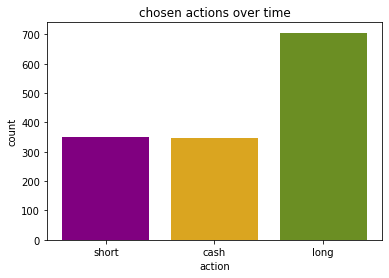

{'short': 350, 'cash': 348, 'long': 706}


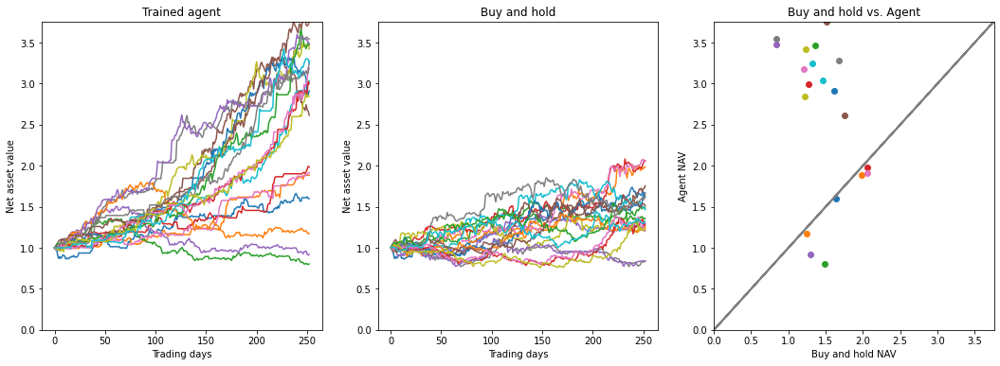

(             agent_avg  market_avg  agent_better
return        2.602924    1.453611          0.65
return_risk   0.965813    0.735080          1.00, array([1.59946102, 1.88450117, 0.80380332, 1.98464279, 0.91900122,
       2.61575733, 1.9148022 , 3.54264738, 3.420948  , 3.03415512,
       2.91202811, 1.17516477, 3.4707162 , 2.99796721, 3.48304795,
       3.75804062, 3.17443528, 3.27673852, 2.84577894, 3.24484245]), array([1.63774618, 1.98471973, 1.48375037, 2.06002218, 1.29776049,
       1.75612913, 2.05519439, 0.83641181, 1.23004136, 1.46375654,
       1.61332275, 1.24796081, 1.35955054, 1.27595671, 0.83674836,
       1.51136802, 1.2083149 , 1.67051682, 1.22007102, 1.32287076]))


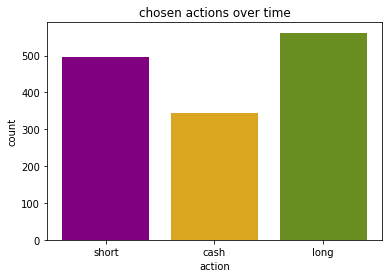

{'short': 497, 'cash': 345, 'long': 562}


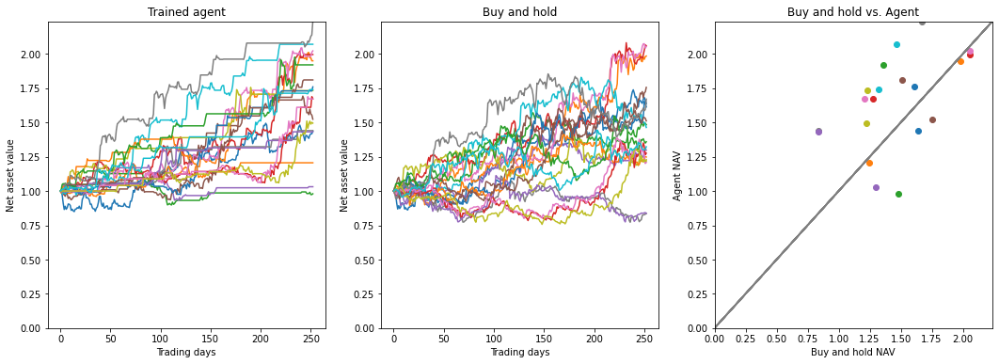

(             agent_avg  market_avg  agent_better
return        1.656591    1.453611           0.6
return_risk   0.969887    0.735080           1.0, array([1.43674938, 1.95026333, 0.98020718, 1.9960934 , 1.03128437,
       1.52388893, 2.02267292, 1.44074292, 1.732547  , 2.07077295,
       1.75985976, 1.20610405, 1.9205066 , 1.67221894, 1.43189943,
       1.81057076, 1.67221894, 2.23842394, 1.49505343, 1.7397474 ]), array([1.63774618, 1.98471973, 1.48375037, 2.06002218, 1.29776049,
       1.75612913, 2.05519439, 0.83641181, 1.23004136, 1.46375654,
       1.61332275, 1.24796081, 1.35955054, 1.27595671, 0.83674836,
       1.51136802, 1.2083149 , 1.67051682, 1.22007102, 1.32287076]))


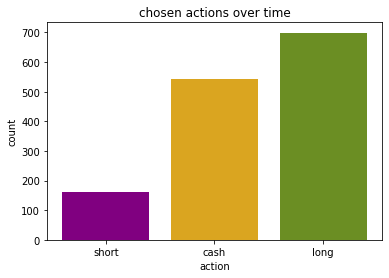

{'short': 161, 'cash': 544, 'long': 699}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x28eb587c0>,
 <stable_baselines3.a2c.a2c.A2C at 0x28eefc520>)

In [ ]:
most_corr_indicators = generate_indicators(tickers[1])
print(most_corr_indicators)
train_agent(tickers[1] , most_corr_indicators)

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


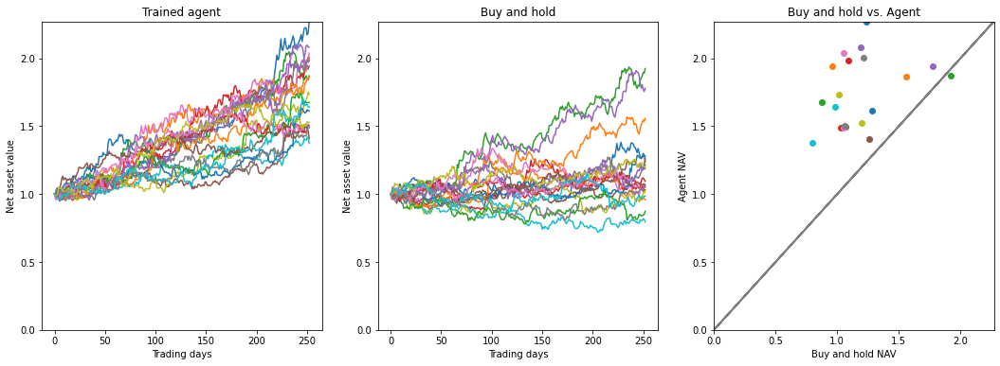

(             agent_avg  market_avg  agent_better
return        1.747728    1.180994          0.95
return_risk   1.296456    0.390001          1.00, array([2.27153989, 1.94144201, 1.87086326, 1.98096039, 1.94191613,
       1.40768109, 2.0383087 , 2.00767825, 1.73325716, 1.37500755,
       1.61346734, 1.86484813, 1.67419852, 1.49123365, 2.08267161,
       1.49831978, 1.49013896, 1.50418648, 1.52538075, 1.64145784]), array([1.24011261, 0.95910607, 1.92424459, 1.0942523 , 1.77822441,
       1.2605812 , 1.05034167, 1.21434338, 1.01254854, 0.79448029,
       1.27965476, 1.55750083, 0.87289434, 1.03059708, 1.18709358,
       1.0693625 , 1.05263799, 1.05644038, 1.19949085, 0.98597823]))


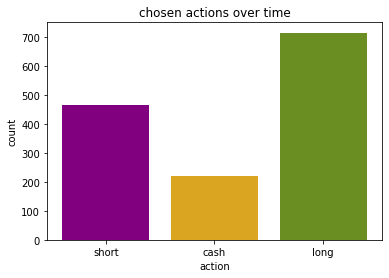

{'short': 467, 'cash': 222, 'long': 715}


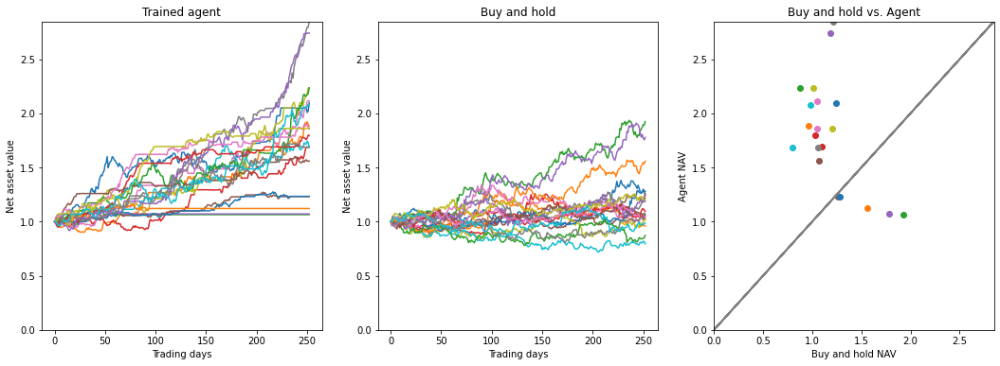

(             agent_avg  market_avg  agent_better
return        1.804509    1.180994          0.75
return_risk   1.103316    0.390001          1.00, array([2.09839366, 1.88142181, 1.06452977, 1.6895107 , 1.07107088,
       1.23123966, 2.11613079, 2.84914963, 2.2318713 , 1.68759817,
       1.23335235, 1.12125315, 2.23636527, 1.79461799, 2.74128806,
       1.55926024, 1.85462005, 1.68581404, 1.86256903, 2.08012855]), array([1.24011261, 0.95910607, 1.92424459, 1.0942523 , 1.77822441,
       1.2605812 , 1.05034167, 1.21434338, 1.01254854, 0.79448029,
       1.27965476, 1.55750083, 0.87289434, 1.03059708, 1.18709358,
       1.0693625 , 1.05263799, 1.05644038, 1.19949085, 0.98597823]))


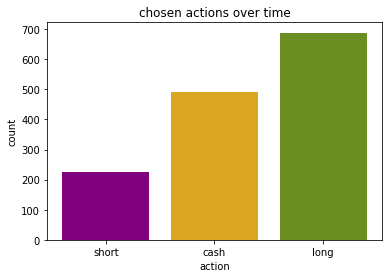

{'short': 224, 'cash': 492, 'long': 688}


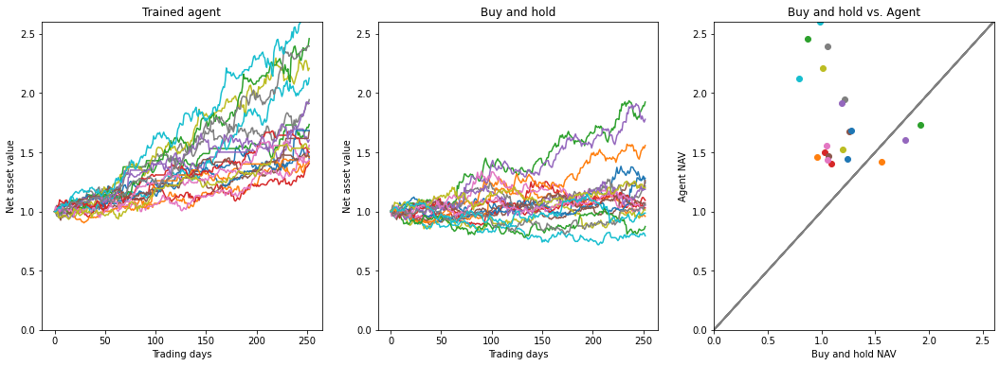

(             agent_avg  market_avg  agent_better
return        1.778903    1.180994          0.85
return_risk   1.120398    0.390001          1.00, array([1.44500628, 1.45640475, 1.73539596, 1.40509461, 1.60370644,
       1.67929568, 1.55954665, 1.94410352, 2.20871668, 2.12688834,
       1.68400153, 1.4236732 , 2.46021451, 1.50080144, 1.91305805,
       1.46532865, 1.43743787, 2.39605444, 1.52787849, 2.60545912]), array([1.24011261, 0.95910607, 1.92424459, 1.0942523 , 1.77822441,
       1.2605812 , 1.05034167, 1.21434338, 1.01254854, 0.79448029,
       1.27965476, 1.55750083, 0.87289434, 1.03059708, 1.18709358,
       1.0693625 , 1.05263799, 1.05644038, 1.19949085, 0.98597823]))


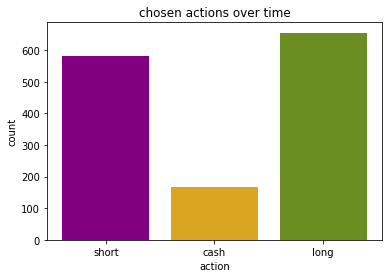

{'short': 581, 'cash': 168, 'long': 655}


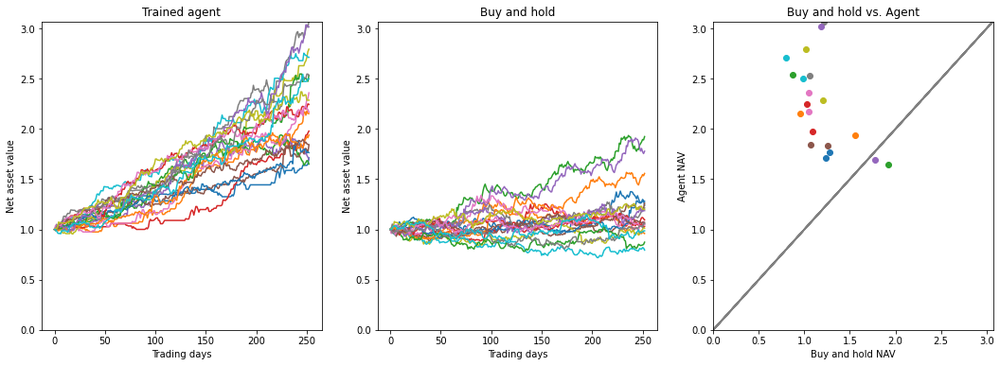

(             agent_avg  market_avg  agent_better
return        2.239907    1.180994           0.9
return_risk   1.328576    0.390001           1.0, array([1.71240281, 2.15367914, 1.65019076, 1.97914587, 1.69542403,
       1.83589631, 2.35983529, 3.07092403, 2.7945723 , 2.71368891,
       1.76493824, 1.93975996, 2.53563481, 2.24512452, 3.01670793,
       1.84410426, 2.16884551, 2.53187273, 2.28679624, 2.49859306]), array([1.24011261, 0.95910607, 1.92424459, 1.0942523 , 1.77822441,
       1.2605812 , 1.05034167, 1.21434338, 1.01254854, 0.79448029,
       1.27965476, 1.55750083, 0.87289434, 1.03059708, 1.18709358,
       1.0693625 , 1.05263799, 1.05644038, 1.19949085, 0.98597823]))


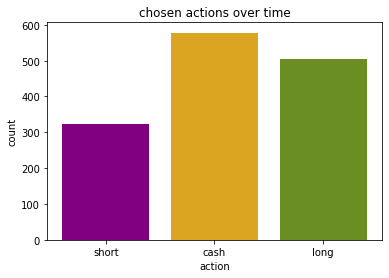

{'short': 322, 'cash': 578, 'long': 504}


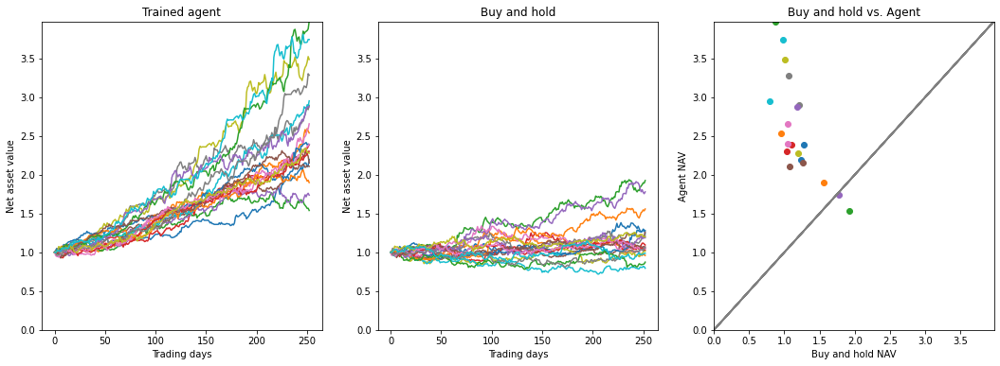

(             agent_avg  market_avg  agent_better
return        2.588502    1.180994           0.9
return_risk   1.201410    0.390001           1.0, array([2.19673238, 2.5375804 , 1.53879927, 2.38462328, 1.73619629,
       2.15158136, 2.6553227 , 2.89345429, 3.48449075, 2.95112976,
       2.38783378, 1.89837697, 3.97531004, 2.30058318, 2.87679298,
       2.10698296, 2.393005  , 3.2818676 , 2.27709251, 3.74228301]), array([1.24011261, 0.95910607, 1.92424459, 1.0942523 , 1.77822441,
       1.2605812 , 1.05034167, 1.21434338, 1.01254854, 0.79448029,
       1.27965476, 1.55750083, 0.87289434, 1.03059708, 1.18709358,
       1.0693625 , 1.05263799, 1.05644038, 1.19949085, 0.98597823]))


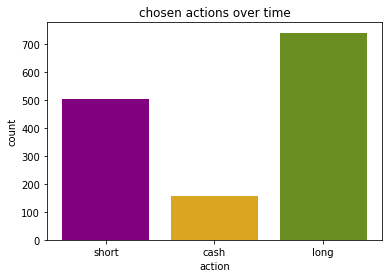

{'short': 505, 'cash': 157, 'long': 742}


(<aif_course.aif_environment.TradingEnvironmentNew at 0x28f07ae20>,
 <stable_baselines3.a2c.a2c.A2C at 0x28c863fa0>)

In [ ]:
most_corr_indicators = generate_indicators(tickers[2])
most_corr_indicators
train_agent(tickers[2] , most_corr_indicators)

## 5. Training an agent for one company for different time periods and evaluating the performance for test periods


##### Observations

*- Overall for all the companies I would say the agent is doing similar to overfitting like kind of overlearning since it's doing its best while training over different periods but nearly worst while testing over the unseen data which is not at all a promising performance.*

*- and when more data is being used for training, the most actions taken matched for training and testing agents.*


In [ ]:
train_start_dates = ['2011-01-01','2011-06-01','2012-01-01','2012-06-01','2013-01-01']
train_end_dates = ['2015-01-01','2016-01-01','2017-01-01','2017-01-01','2017-06-01']

test_start_dates = ['2017-01-01','2017-06-01','2018-01-01','2018-06-01','2019-01-01']
test_end_dates = ['2020-01-01','2021-01-01','2021-06-01','2022-01-01','2022-06-01']

**** 
Training agent 5 times with time periods 2011-01-01 till 2015-01-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


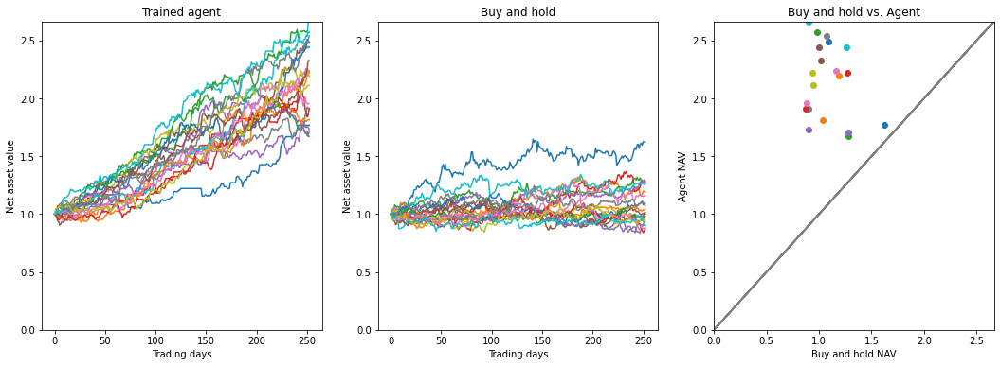

(             agent_avg  market_avg  agent_better
return        2.146000    1.080007           1.0
return_risk   1.352793    0.402058           1.0, array([1.76787625, 2.19270149, 1.67088795, 2.21813025, 1.70731704,
       2.4448979 , 2.23537372, 1.91137792, 2.21785745, 2.44122202,
       2.48758836, 1.8158374 , 2.56823195, 1.91286386, 1.72969458,
       2.32680687, 1.95546668, 2.53962788, 2.11141758, 2.66482146]), array([1.62341484, 1.19242915, 1.2818438 , 1.26994629, 1.27568749,
       1.00159816, 1.15873191, 0.90247808, 0.93278066, 1.25854584,
       1.09278712, 1.03975456, 0.98039592, 0.87651757, 0.89837127,
       1.01616678, 0.87959432, 1.07027054, 0.9459288 , 0.90290183]))


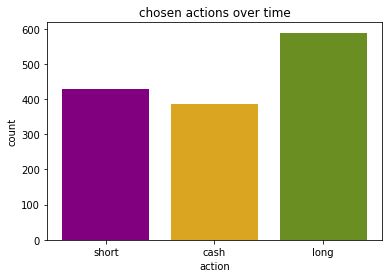

{'short': 430, 'cash': 385, 'long': 589}


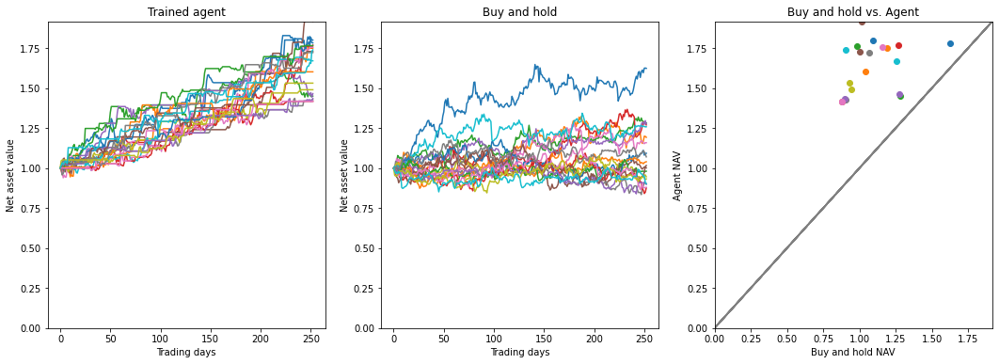

(             agent_avg  market_avg  agent_better
return        1.631794    1.080007           1.0
return_risk   1.529325    0.402058           1.0, array([1.78215799, 1.74955775, 1.44931193, 1.76824552, 1.46553356,
       1.72925488, 1.75531467, 1.42861309, 1.53106929, 1.67061473,
       1.80032831, 1.60173699, 1.76531539, 1.41761275, 1.43514385,
       1.9176206 , 1.41761275, 1.72207323, 1.48976944, 1.73898757]), array([1.62341484, 1.19242915, 1.2818438 , 1.26994629, 1.27568749,
       1.00159816, 1.15873191, 0.90247808, 0.93278066, 1.25854584,
       1.09278712, 1.03975456, 0.98039592, 0.87651757, 0.89837127,
       1.01616678, 0.87959432, 1.07027054, 0.9459288 , 0.90290183]))


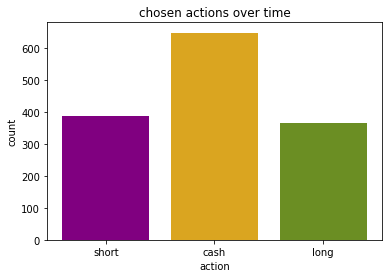

{'short': 389, 'cash': 649, 'long': 366}


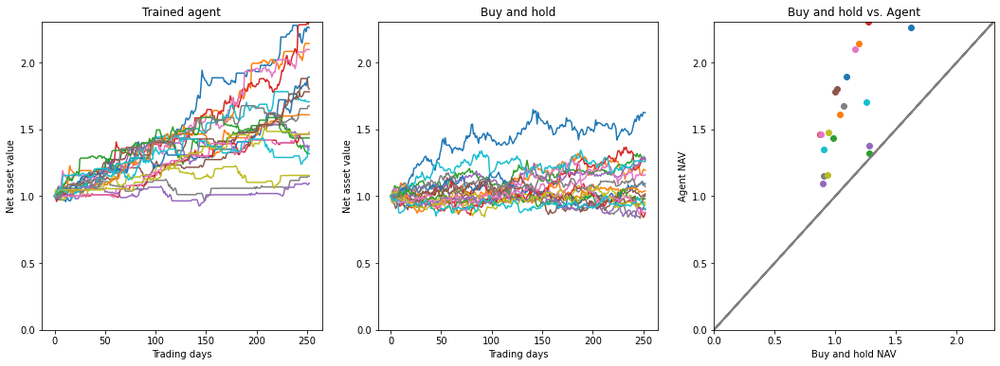

(             agent_avg  market_avg  agent_better
return        1.627452    1.080007           1.0
return_risk   1.272303    0.402058           1.0, array([2.25914895, 2.14173976, 1.3175857 , 2.30617464, 1.37525231,
       1.77996593, 2.09652862, 1.14888906, 1.15492739, 1.70568434,
       1.89032412, 1.60810152, 1.43478213, 1.46461781, 1.09749188,
       1.80000282, 1.46461781, 1.67470758, 1.47932394, 1.34916521]), array([1.62341484, 1.19242915, 1.2818438 , 1.26994629, 1.27568749,
       1.00159816, 1.15873191, 0.90247808, 0.93278066, 1.25854584,
       1.09278712, 1.03975456, 0.98039592, 0.87651757, 0.89837127,
       1.01616678, 0.87959432, 1.07027054, 0.9459288 , 0.90290183]))


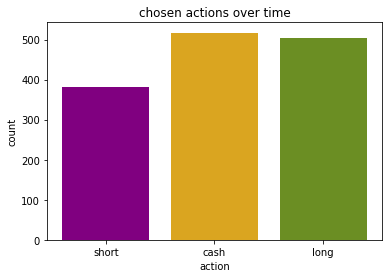

{'short': 382, 'cash': 517, 'long': 505}


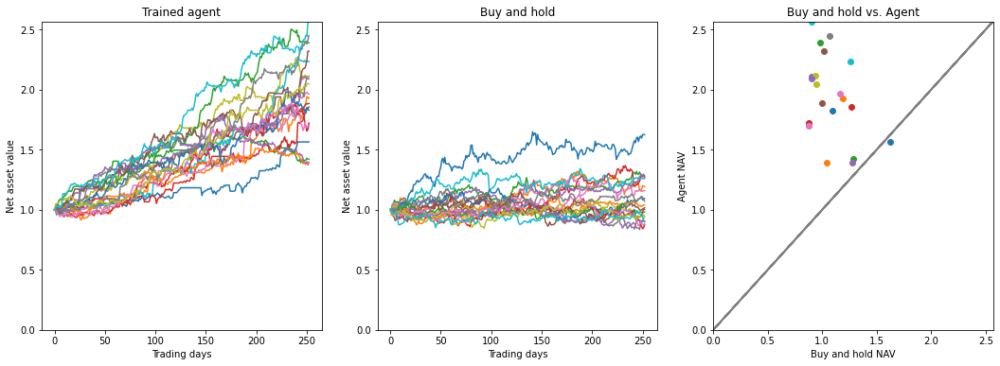

(             agent_avg  market_avg  agent_better
return        1.947424    1.080007          0.95
return_risk   1.311851    0.402058          1.00, array([1.56404849, 1.92551525, 1.42008594, 1.85419133, 1.39449905,
       1.88492458, 1.96298776, 2.1070126 , 2.11178174, 2.23179628,
       1.82727909, 1.38865651, 2.38878228, 1.72078318, 2.08918421,
       2.31893488, 1.69515199, 2.44876452, 2.0474886 , 2.56661541]), array([1.62341484, 1.19242915, 1.2818438 , 1.26994629, 1.27568749,
       1.00159816, 1.15873191, 0.90247808, 0.93278066, 1.25854584,
       1.09278712, 1.03975456, 0.98039592, 0.87651757, 0.89837127,
       1.01616678, 0.87959432, 1.07027054, 0.9459288 , 0.90290183]))


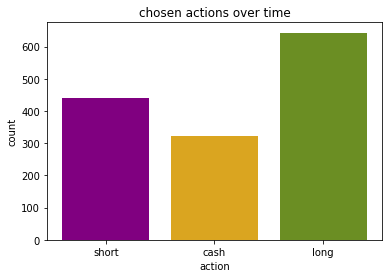

{'short': 439, 'cash': 322, 'long': 643}


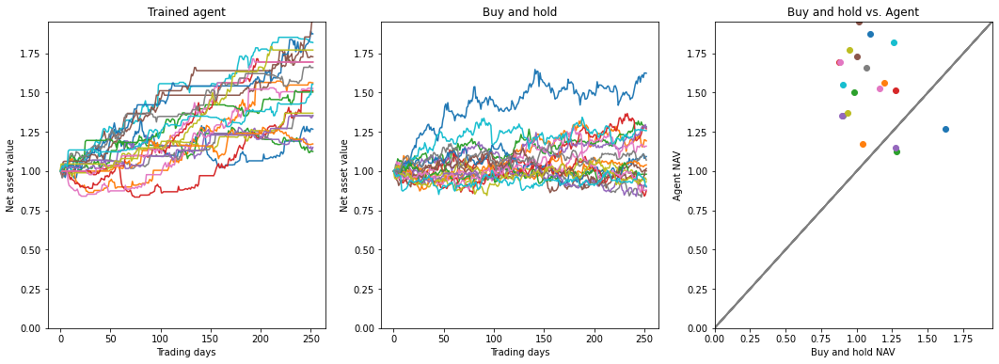

(             agent_avg  market_avg  agent_better
return        1.532407    1.080007          0.85
return_risk   1.125490    0.402058          1.00, array([1.26685238, 1.56223559, 1.12505739, 1.51195995, 1.15129249,
       1.7286465 , 1.52635691, 1.3529693 , 1.36900624, 1.81917816,
       1.8750174 , 1.17323649, 1.50353011, 1.69485415, 1.35387158,
       1.95455851, 1.69485415, 1.65968009, 1.77145461, 1.55351953]), array([1.62341484, 1.19242915, 1.2818438 , 1.26994629, 1.27568749,
       1.00159816, 1.15873191, 0.90247808, 0.93278066, 1.25854584,
       1.09278712, 1.03975456, 0.98039592, 0.87651757, 0.89837127,
       1.01616678, 0.87959432, 1.07027054, 0.9459288 , 0.90290183]))


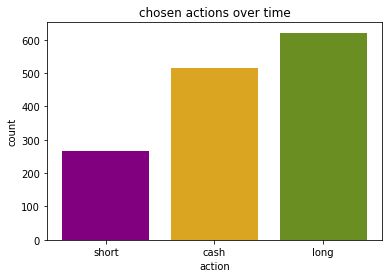

{'short': 267, 'cash': 516, 'long': 621}
**** 
Testing trained agent with time periods 2017-01-01 till 2020-01-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 9.63% of the data
Time period used for training or testing starts at:2018-04-23 00:00:00 and ends at: 2019-12-31 00:00:00


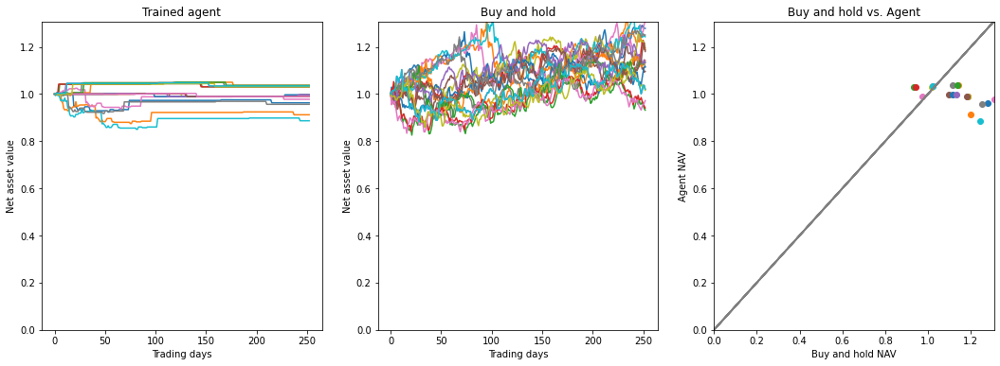

(             agent_avg  market_avg  agent_better
return        0.995676    1.123562           0.3
return_risk  -0.008010    0.667915           0.0, array([0.96280006, 0.91211654, 1.03079795, 0.98942242, 1.03413044,
       0.9966907 , 0.97791862, 1.03635417, 0.98942242, 0.88670619,
       0.9966907 , 1.03635417, 1.03635417, 1.03079795, 0.9966907 ,
       0.98942242, 0.98942242, 0.95645591, 1.0308368 , 1.03413044]), array([1.27830516, 1.19759953, 0.93166309, 1.18685205, 1.0208027 ,
       1.09650499, 1.30796276, 1.11415074, 1.18716342, 1.24301776,
       1.11566132, 1.14299779, 1.1351641 , 0.9411795 , 1.13228383,
       1.18061502, 0.97185861, 1.25044193, 1.01622036, 1.0208027 ]))


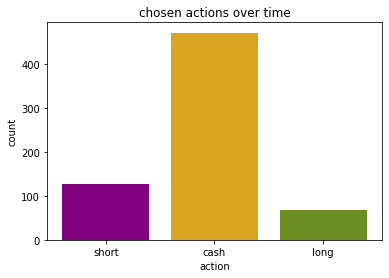

**** 
Training agent 5 times with time periods 2011-06-01 till 2016-01-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


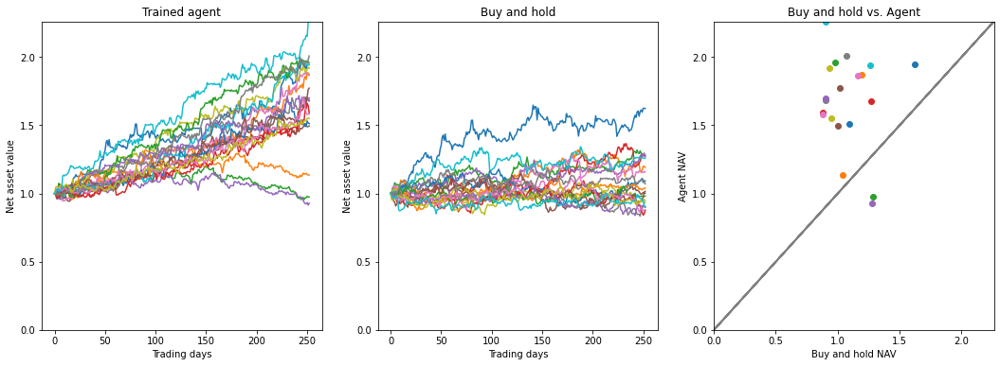

(             agent_avg  market_avg  agent_better
return        1.668813    1.080007           0.9
return_risk   1.220080    0.402058           1.0, array([1.94478108, 1.87184802, 0.97416745, 1.67825193, 0.9288289 ,
       1.49492693, 1.86532351, 1.68063637, 1.91794244, 1.94245574,
       1.51203934, 1.13601126, 1.95937453, 1.5919483 , 1.6998645 ,
       1.77282584, 1.58302796, 2.00866095, 1.55152978, 2.26180576]), array([1.62341478, 1.19242842, 1.28184373, 1.2699458 , 1.2756879 ,
       1.00159771, 1.15873283, 0.90247806, 0.93278058, 1.25854548,
       1.0927875 , 1.03975467, 0.98039592, 0.87651723, 0.89837188,
       1.01616701, 0.87959475, 1.0702705 , 0.94592891, 0.90290203]))


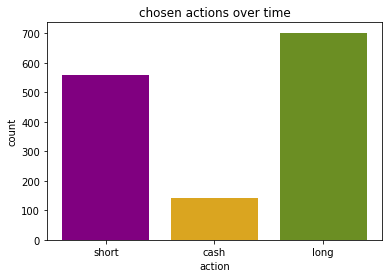

{'short': 560, 'cash': 142, 'long': 702}


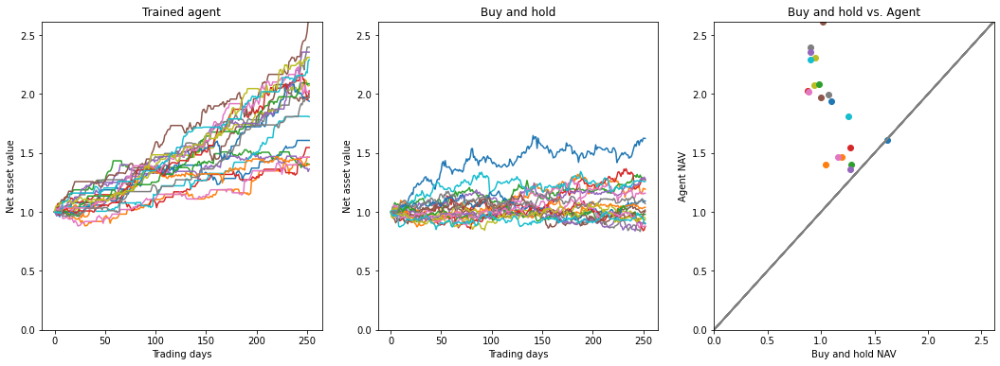

(             agent_avg  market_avg  agent_better
return        1.907375    1.080007          0.95
return_risk   1.259950    0.402058          1.00, array([1.60699321, 1.46436765, 1.40477641, 1.5467384 , 1.36389057,
       1.97181866, 1.46436765, 2.39766981, 2.0735258 , 1.80806712,
       1.93929661, 1.40197469, 2.08713844, 2.02772508, 2.35587533,
       2.61638847, 2.01929271, 1.99505385, 2.31108011, 2.29144963]), array([1.62341478, 1.19242842, 1.28184373, 1.2699458 , 1.2756879 ,
       1.00159771, 1.15873283, 0.90247806, 0.93278058, 1.25854548,
       1.0927875 , 1.03975467, 0.98039592, 0.87651723, 0.89837188,
       1.01616701, 0.87959475, 1.0702705 , 0.94592891, 0.90290203]))


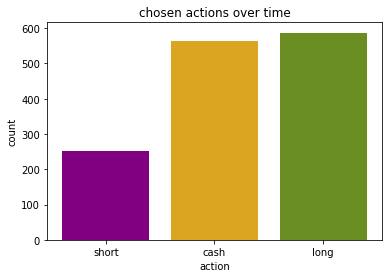

{'short': 253, 'cash': 564, 'long': 587}


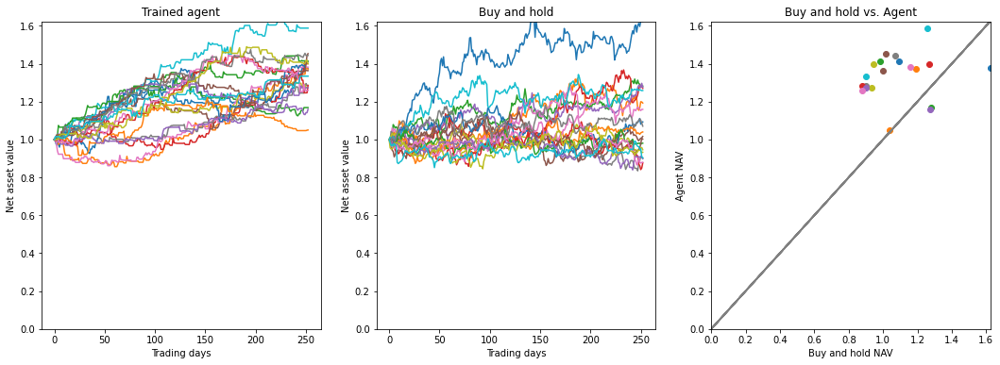

(             agent_avg  market_avg  agent_better
return        1.334426    1.080007          0.85
return_risk   1.231768    0.402058          1.00, array([1.37664028, 1.37072787, 1.16834295, 1.3998673 , 1.15907619,
       1.36332306, 1.38182927, 1.28553255, 1.27329778, 1.58768566,
       1.41150578, 1.05009652, 1.41314855, 1.28509598, 1.27291216,
       1.45295421, 1.2590989 , 1.44330724, 1.3999126 , 1.33416174]), array([1.62341478, 1.19242842, 1.28184373, 1.2699458 , 1.2756879 ,
       1.00159771, 1.15873283, 0.90247806, 0.93278058, 1.25854548,
       1.0927875 , 1.03975467, 0.98039592, 0.87651723, 0.89837188,
       1.01616701, 0.87959475, 1.0702705 , 0.94592891, 0.90290203]))


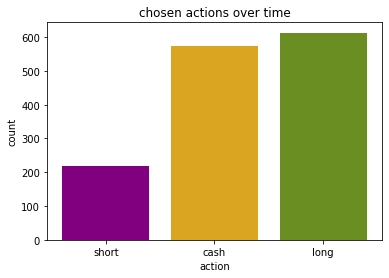

{'short': 218, 'cash': 573, 'long': 613}


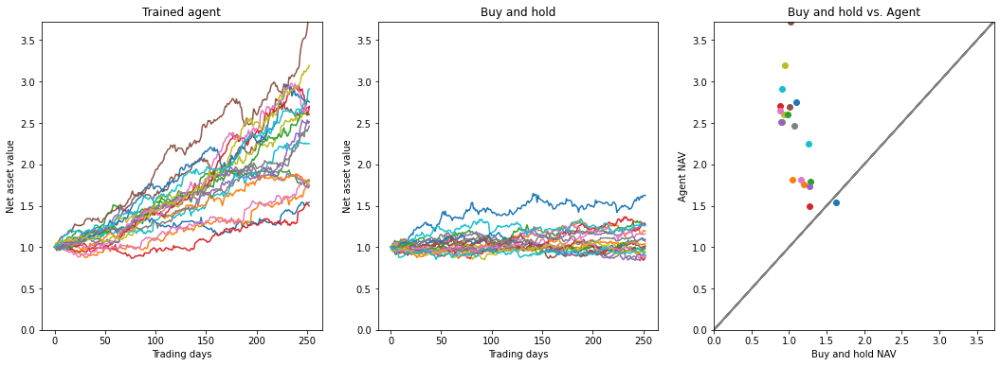

(             agent_avg  market_avg  agent_better
return        2.375556    1.080007          0.95
return_risk   1.152184    0.402058          1.00, array([1.53832224, 1.75476048, 1.79046607, 1.4967098 , 1.73835478,
       2.6883322 , 1.81189272, 2.51012256, 2.60498531, 2.24881383,
       2.75259132, 1.81187634, 2.60242936, 2.70123672, 2.51678268,
       3.72633358, 2.65103477, 2.4615727 , 3.19444356, 2.91005195]), array([1.62341478, 1.19242842, 1.28184373, 1.2699458 , 1.2756879 ,
       1.00159771, 1.15873283, 0.90247806, 0.93278058, 1.25854548,
       1.0927875 , 1.03975467, 0.98039592, 0.87651723, 0.89837188,
       1.01616701, 0.87959475, 1.0702705 , 0.94592891, 0.90290203]))


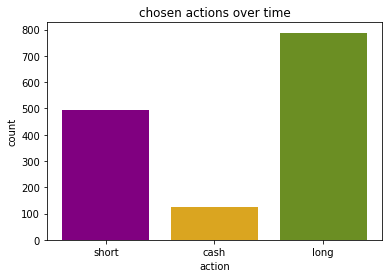

{'short': 493, 'cash': 123, 'long': 788}


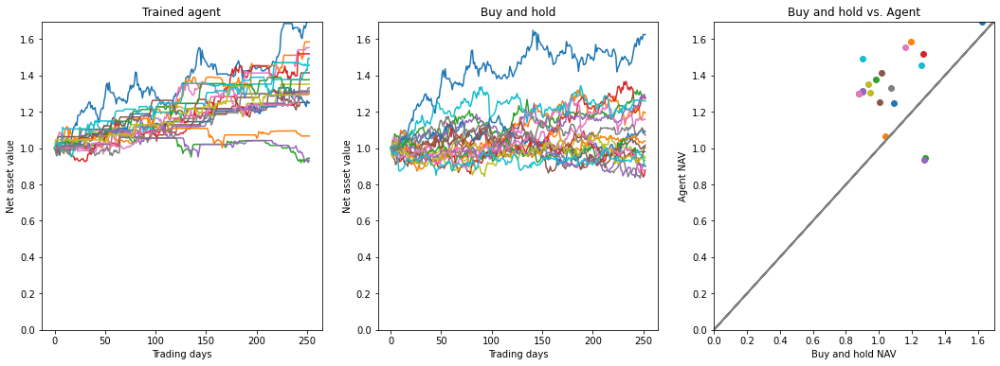

(             agent_avg  market_avg  agent_better
return        1.337182    1.080007           0.9
return_risk   1.264118    0.402058           1.0, array([1.69660217, 1.58420511, 0.94398811, 1.51847186, 0.93416363,
       1.25090456, 1.55202417, 1.31050076, 1.35100818, 1.4546931 ,
       1.24806424, 1.06628353, 1.37554797, 1.29876306, 1.31576468,
       1.41390765, 1.29876306, 1.33066507, 1.3065086 , 1.49280212]), array([1.62341478, 1.19242842, 1.28184373, 1.2699458 , 1.2756879 ,
       1.00159771, 1.15873283, 0.90247806, 0.93278058, 1.25854548,
       1.0927875 , 1.03975467, 0.98039592, 0.87651723, 0.89837188,
       1.01616701, 0.87959475, 1.0702705 , 0.94592891, 0.90290203]))


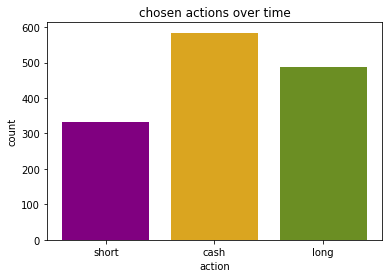

{'short': 333, 'cash': 584, 'long': 487}
**** 
Testing trained agent with time periods 2017-06-01 till 2021-01-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.01% of the data
Time period used for training or testing starts at:2018-09-18 00:00:00 and ends at: 2020-12-31 00:00:00


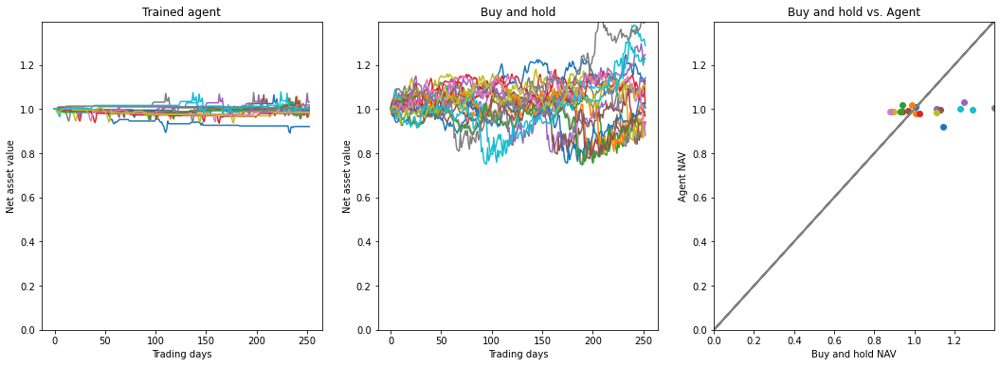

(             agent_avg  market_avg  agent_better
return        0.992974    1.052113           0.5
return_risk  -0.443193    0.292380           0.0, array([0.92076962, 0.98034328, 1.01693665, 0.98665758, 1.00272239,
       0.99508616, 0.98980865, 0.98665758, 0.98665758, 0.99610621,
       1.00991514, 1.01693665, 0.98980865, 0.97976834, 1.03084748,
       0.99288104, 0.98665758, 1.00725969, 0.98180225, 1.00185307]), array([1.14082278, 1.00529755, 0.94178811, 0.93930092, 1.11054217,
       1.1291725 , 0.93184182, 0.88267736, 0.89500658, 1.28748429,
       1.00476648, 0.98749567, 0.93186869, 1.02627144, 1.24584672,
       0.96892592, 0.87815241, 1.39639685, 1.11001417, 1.22858079]))


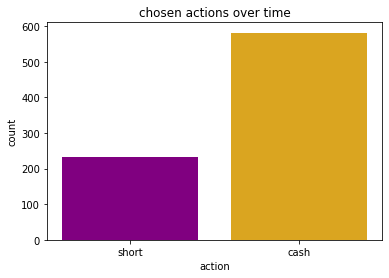

**** 
Training agent 5 times with time periods 2012-01-01 till 2017-01-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


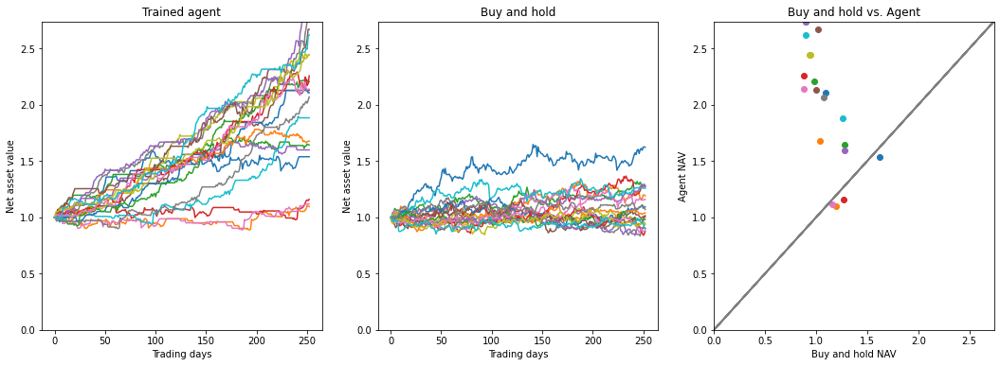

(             agent_avg  market_avg  agent_better
return        2.014709    1.080007           0.8
return_risk   1.088760    0.402058           1.0, array([1.53883479, 1.09552262, 1.64349576, 1.15984172, 1.59954709,
       2.1297953 , 1.1193362 , 2.74157793, 2.44638385, 1.88467404,
       2.107282  , 1.67851574, 2.2054324 , 2.25823584, 2.74157793,
       2.67104879, 2.13950627, 2.07015309, 2.44167214, 2.62175255]), array([1.62341474, 1.19242939, 1.2818439 , 1.26994592, 1.27568777,
       1.00159748, 1.15873287, 0.90247766, 0.93278004, 1.25854606,
       1.09278716, 1.03975513, 0.98039624, 0.87651738, 0.89837129,
       1.01616678, 0.87959439, 1.07027018, 0.94592859, 0.90290155]))


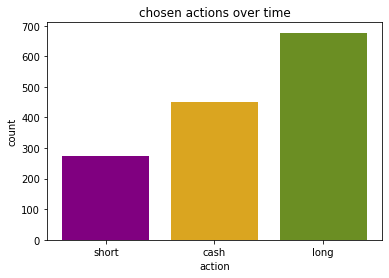

{'short': 275, 'cash': 452, 'long': 677}


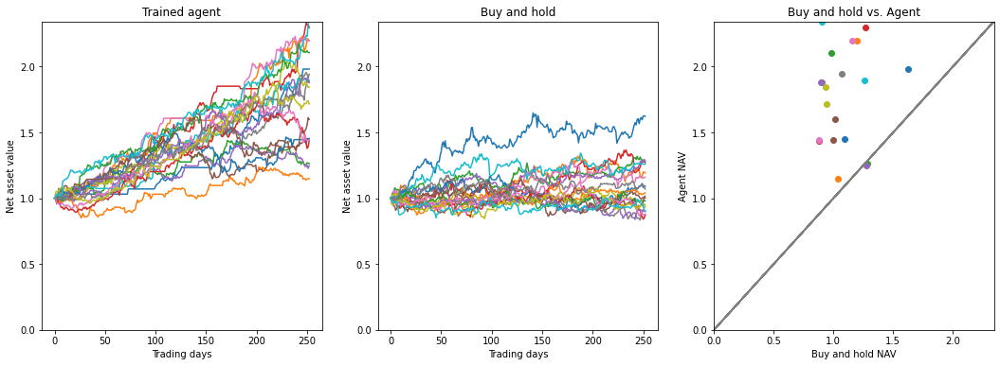

(             agent_avg  market_avg  agent_better
return        1.764865    1.080007           0.9
return_risk   1.268670    0.402058           1.0, array([1.98136057, 2.19627531, 1.26319121, 2.29420942, 1.24603483,
       1.43910012, 2.19461904, 1.87769901, 1.84528955, 1.89506873,
       1.45327376, 1.1494363 , 2.10589491, 1.43477312, 1.88015792,
       1.59896538, 1.4398099 , 1.94196391, 1.71688508, 2.34328517]), array([1.62341474, 1.19242939, 1.2818439 , 1.26994592, 1.27568777,
       1.00159748, 1.15873287, 0.90247766, 0.93278004, 1.25854606,
       1.09278716, 1.03975513, 0.98039624, 0.87651738, 0.89837129,
       1.01616678, 0.87959439, 1.07027018, 0.94592859, 0.90290155]))


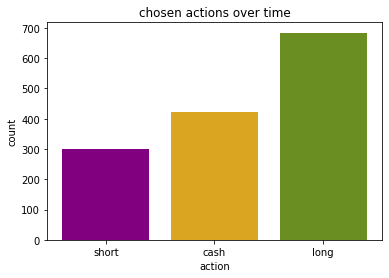

{'short': 299, 'cash': 421, 'long': 684}


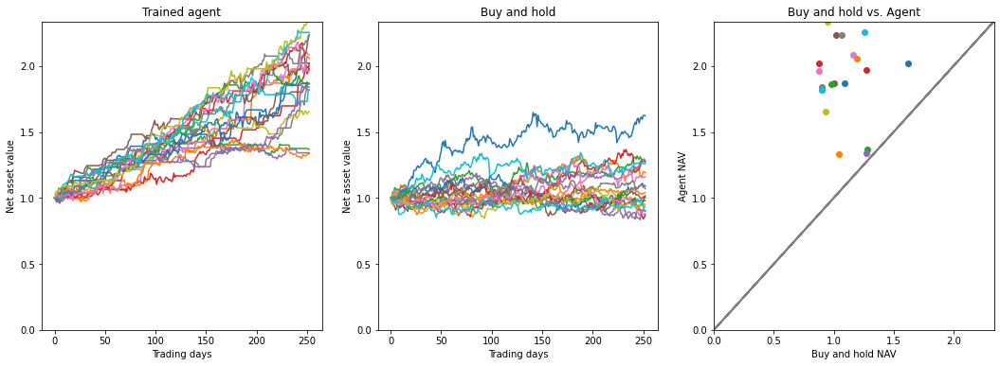

(             agent_avg  market_avg  agent_better
return        1.898062    1.080007           1.0
return_risk   1.442858    0.402058           1.0, array([2.02226753, 2.05742218, 1.36781917, 1.97202825, 1.34197518,
       1.86668375, 2.08599455, 1.83932821, 1.65352806, 2.25434459,
       1.86723985, 1.33479354, 1.86551681, 2.01954665, 1.81666195,
       2.23746221, 1.96572415, 2.23566695, 2.33783598, 1.81940761]), array([1.62341474, 1.19242939, 1.2818439 , 1.26994592, 1.27568777,
       1.00159748, 1.15873287, 0.90247766, 0.93278004, 1.25854606,
       1.09278716, 1.03975513, 0.98039624, 0.87651738, 0.89837129,
       1.01616678, 0.87959439, 1.07027018, 0.94592859, 0.90290155]))


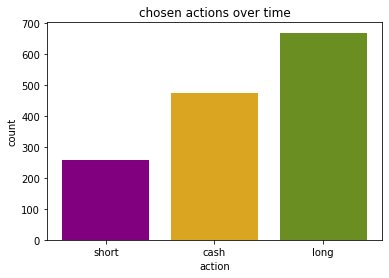

{'short': 258, 'cash': 476, 'long': 670}


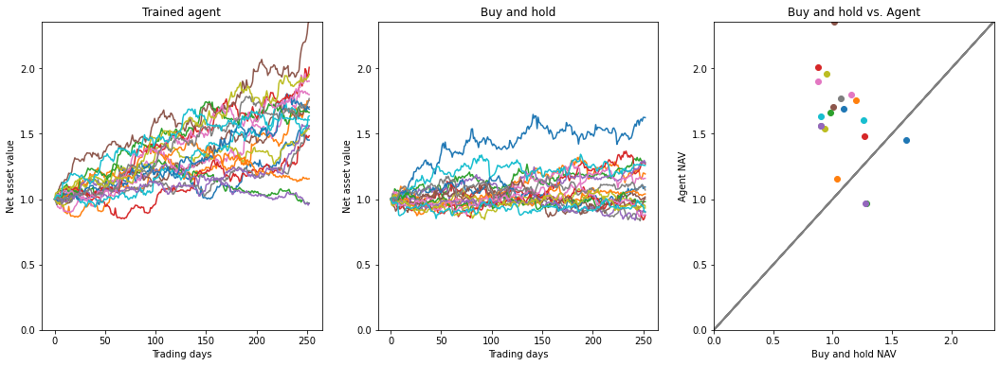

(             agent_avg  market_avg  agent_better
return        1.626591    1.080007          0.85
return_risk   1.192176    0.402058          1.00, array([1.45199581, 1.75456669, 0.9693327 , 1.48429695, 0.96867713,
       1.70510467, 1.79978516, 1.56012767, 1.53625344, 1.60543817,
       1.68858014, 1.15615728, 1.66285103, 2.0075837 , 1.55888718,
       2.35919237, 1.90203248, 1.76894096, 1.95555607, 1.63645462]), array([1.62341474, 1.19242939, 1.2818439 , 1.26994592, 1.27568777,
       1.00159748, 1.15873287, 0.90247766, 0.93278004, 1.25854606,
       1.09278716, 1.03975513, 0.98039624, 0.87651738, 0.89837129,
       1.01616678, 0.87959439, 1.07027018, 0.94592859, 0.90290155]))


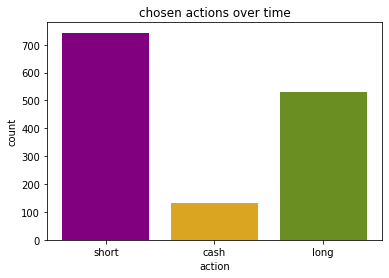

{'short': 743, 'cash': 131, 'long': 530}


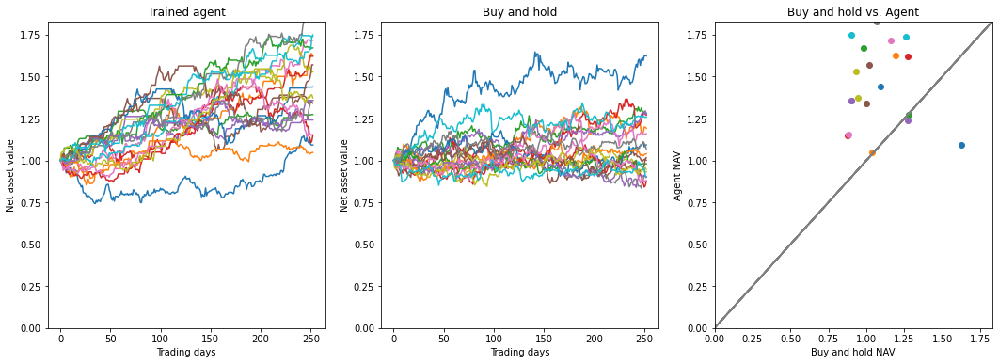

(             agent_avg  market_avg  agent_better
return        1.444161    1.080007          0.85
return_risk   1.091109    0.402058          1.00, array([1.09232135, 1.62598483, 1.27351537, 1.62136891, 1.24172954,
       1.34175868, 1.71669322, 1.35822538, 1.5289226 , 1.73960938,
       1.43891062, 1.04755135, 1.67134725, 1.14993435, 1.35822538,
       1.57043672, 1.1539712 , 1.8301996 , 1.3735146 , 1.74900134]), array([1.62341474, 1.19242939, 1.2818439 , 1.26994592, 1.27568777,
       1.00159748, 1.15873287, 0.90247766, 0.93278004, 1.25854606,
       1.09278716, 1.03975513, 0.98039624, 0.87651738, 0.89837129,
       1.01616678, 0.87959439, 1.07027018, 0.94592859, 0.90290155]))


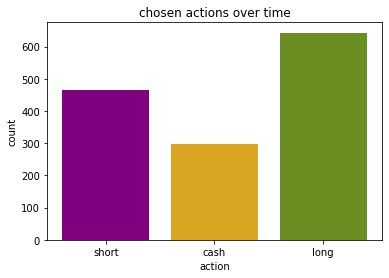

{'short': 465, 'cash': 296, 'long': 643}
**** 
Testing trained agent with time periods 2018-01-01 till 2021-06-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.45% of the data
Time period used for training or testing starts at:2019-04-26 00:00:00 and ends at: 2021-05-31 00:00:00


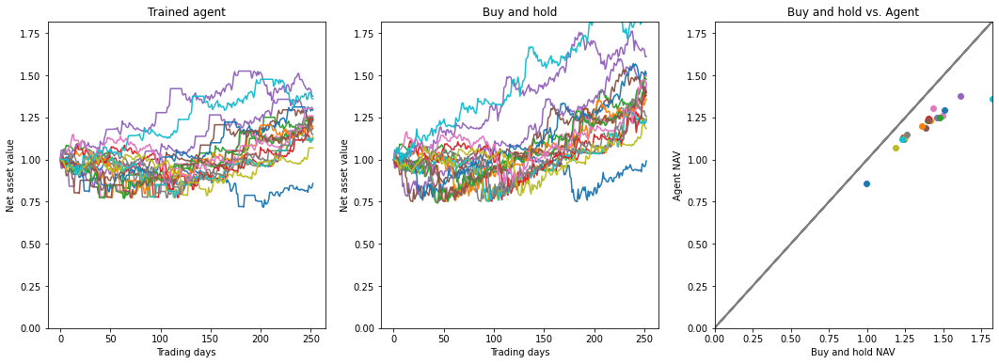

(             agent_avg  market_avg  agent_better
return        1.199852    1.377303           0.0
return_risk   0.151722    0.416891           0.0, array([0.85846463, 1.23315271, 1.23042301, 1.12968467, 1.24832579,
       1.18628075, 1.25907963, 1.1185371 , 1.13425899, 1.12163312,
       1.29391628, 1.19843477, 1.24902015, 1.24132839, 1.37677169,
       1.23449863, 1.30432676, 1.14817058, 1.06912555, 1.36159717]), array([0.99250846, 1.41320345, 1.39639689, 1.23740005, 1.45467898,
       1.38237765, 1.49602215, 1.2388532 , 1.24759326, 1.22858079,
       1.50780576, 1.36009371, 1.47726733, 1.40023803, 1.61184365,
       1.40467074, 1.43382398, 1.25764859, 1.18387704, 1.82118379]))


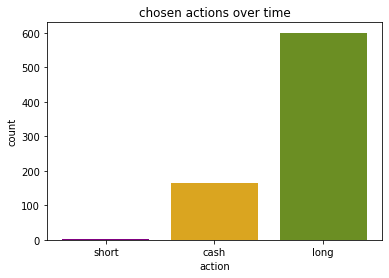

**** 
Training agent 5 times with time periods 2012-06-01 till 2017-01-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


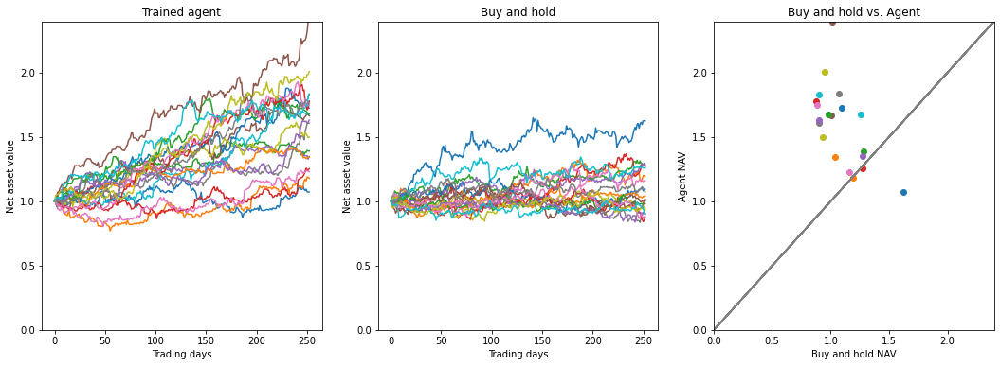

(             agent_avg  market_avg  agent_better
return        1.593849    1.080007          0.85
return_risk   1.018025    0.402058          1.00, array([1.07144242, 1.17860282, 1.38957587, 1.25209665, 1.34748206,
       1.66395063, 1.22918475, 1.60625614, 1.49711844, 1.67598084,
       1.72410011, 1.34235998, 1.6773822 , 1.77816792, 1.62959554,
       2.39702158, 1.74512119, 1.83321963, 2.00778379, 1.83054423]), array([1.62341507, 1.19242907, 1.28184319, 1.26994578, 1.27568786,
       1.00159748, 1.15873264, 0.90247808, 0.93278066, 1.25854616,
       1.09278701, 1.03975444, 0.98039603, 0.87651706, 0.89837168,
       1.01616655, 0.87959428, 1.07027006, 0.94592879, 0.90290156]))


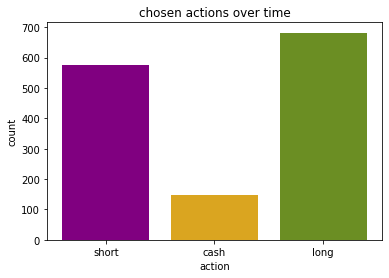

{'short': 576, 'cash': 146, 'long': 682}


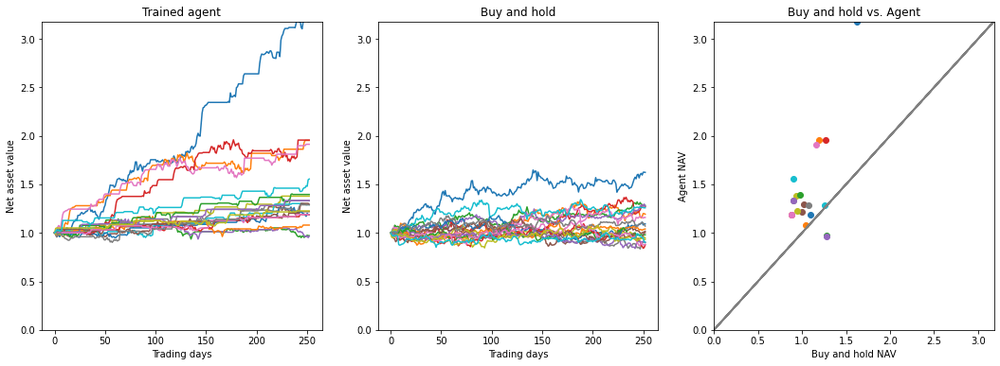

(             agent_avg  market_avg  agent_better
return        1.444705    1.080007           0.9
return_risk   0.737934    0.402058           1.0, array([3.17947677, 1.95267242, 0.97042342, 1.9563236 , 0.96523408,
       1.21882148, 1.9130048 , 1.33357134, 1.37876813, 1.28959019,
       1.18615772, 1.08010078, 1.39562029, 1.18892791, 1.33242788,
       1.29359963, 1.18892791, 1.28903859, 1.22623937, 1.55517611]), array([1.62341507, 1.19242907, 1.28184319, 1.26994578, 1.27568786,
       1.00159748, 1.15873264, 0.90247808, 0.93278066, 1.25854616,
       1.09278701, 1.03975444, 0.98039603, 0.87651706, 0.89837168,
       1.01616655, 0.87959428, 1.07027006, 0.94592879, 0.90290156]))


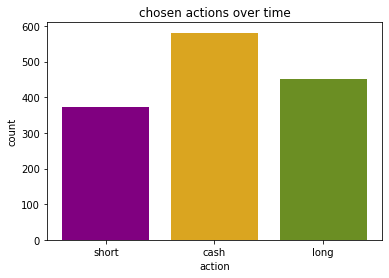

{'short': 372, 'cash': 581, 'long': 451}


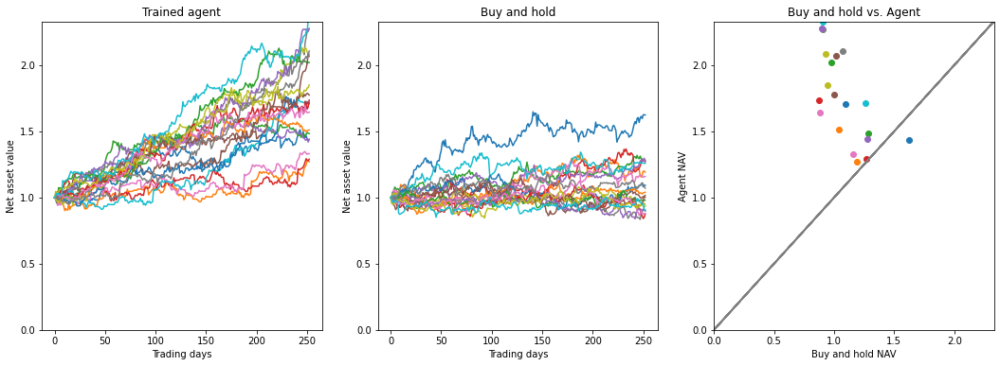

(             agent_avg  market_avg  agent_better
return        1.767350    1.080007          0.95
return_risk   1.234018    0.402058          1.00, array([1.43726625, 1.27016448, 1.48377843, 1.28929236, 1.44059268,
       1.77434183, 1.33080738, 2.27343312, 2.08313141, 1.7160186 ,
       1.70829554, 1.510046  , 2.01984142, 1.73545068, 2.27620339,
       2.06714817, 1.64420721, 2.10634921, 1.85020676, 2.33041677]), array([1.62341507, 1.19242907, 1.28184319, 1.26994578, 1.27568786,
       1.00159748, 1.15873264, 0.90247808, 0.93278066, 1.25854616,
       1.09278701, 1.03975444, 0.98039603, 0.87651706, 0.89837168,
       1.01616655, 0.87959428, 1.07027006, 0.94592879, 0.90290156]))


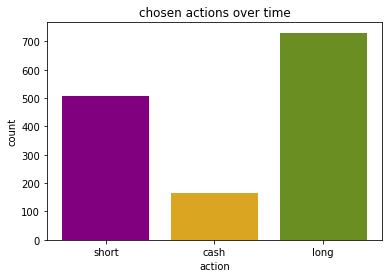

{'short': 507, 'cash': 166, 'long': 731}


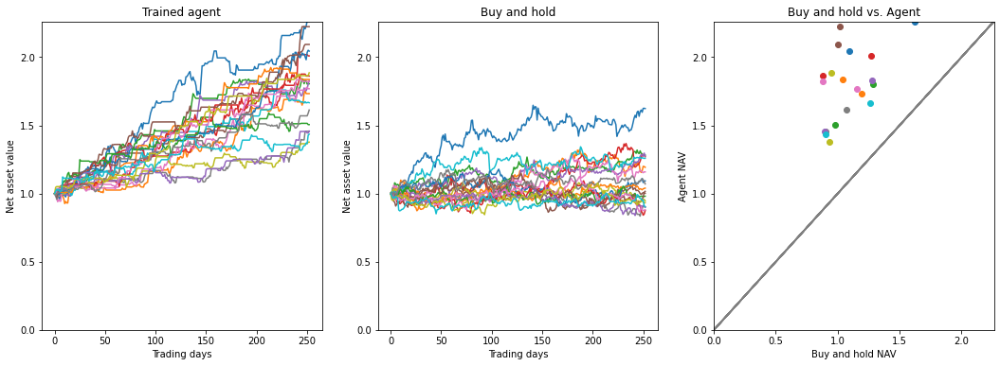

(             agent_avg  market_avg  agent_better
return        1.784388    1.080007           1.0
return_risk   1.412059    0.402058           1.0, array([2.26254923, 1.73296197, 1.80494475, 2.009731  , 1.82889344,
       2.09370418, 1.7687738 , 1.45654899, 1.3771029 , 1.66616059,
       2.04496295, 1.83668127, 1.50562307, 1.86168296, 1.45832385,
       2.22410621, 1.82125453, 1.61267082, 1.88560299, 1.43547564]), array([1.62341507, 1.19242907, 1.28184319, 1.26994578, 1.27568786,
       1.00159748, 1.15873264, 0.90247808, 0.93278066, 1.25854616,
       1.09278701, 1.03975444, 0.98039603, 0.87651706, 0.89837168,
       1.01616655, 0.87959428, 1.07027006, 0.94592879, 0.90290156]))


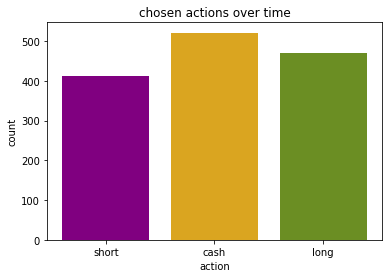

{'short': 412, 'cash': 521, 'long': 471}


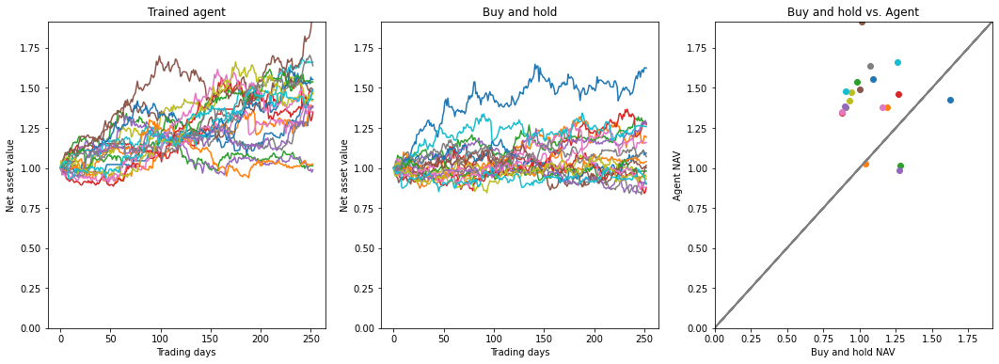

(             agent_avg  market_avg  agent_better
return        1.415484    1.080007           0.8
return_risk   1.193507    0.402058           1.0, array([1.42774769, 1.38054393, 1.01355001, 1.46364762, 0.98813849,
       1.48906003, 1.3795033 , 1.38088759, 1.42264611, 1.66035367,
       1.55271838, 1.02395637, 1.53696413, 1.34673495, 1.38719954,
       1.91570363, 1.35146298, 1.63846855, 1.47083277, 1.47955595]), array([1.62341507, 1.19242907, 1.28184319, 1.26994578, 1.27568786,
       1.00159748, 1.15873264, 0.90247808, 0.93278066, 1.25854616,
       1.09278701, 1.03975444, 0.98039603, 0.87651706, 0.89837168,
       1.01616655, 0.87959428, 1.07027006, 0.94592879, 0.90290156]))


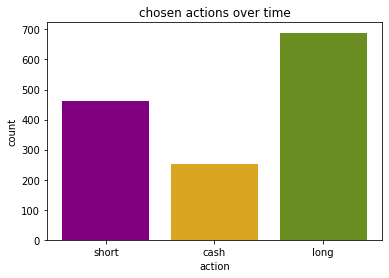

{'short': 462, 'cash': 253, 'long': 689}
**** 
Testing trained agent with time periods 2018-06-01 till 2022-01-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.02% of the data
Time period used for training or testing starts at:2019-09-27 00:00:00 and ends at: 2021-12-31 00:00:00


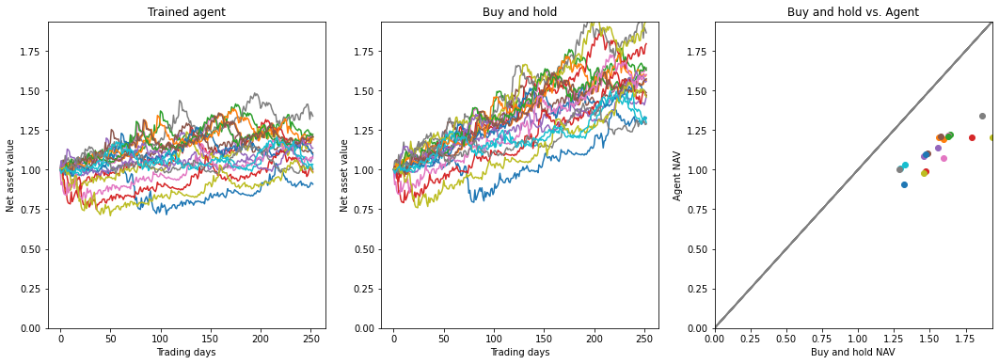

(             agent_avg  market_avg  agent_better
return        1.120288    1.548350           0.0
return_risk   0.650760    1.324131           0.0, array([0.90816743, 1.20106597, 1.22306729, 1.20596363, 1.08605814,
       1.10484285, 1.21328775, 1.33798966, 1.20112664, 1.00651255,
       1.0961728 , 1.19079855, 1.21011511, 0.98819166, 1.13602739,
       1.20745197, 1.07443811, 1.00121897, 0.98045772, 1.03280493]), array([1.32263086, 1.56535252, 1.64217958, 1.79461429, 1.46023191,
       1.4854884 , 1.63168614, 1.8634842 , 1.93631655, 1.29497505,
       1.46790405, 1.59885321, 1.62741942, 1.47054425, 1.55721212,
       1.57322025, 1.598889  , 1.28816436, 1.45903525, 1.32880273]))


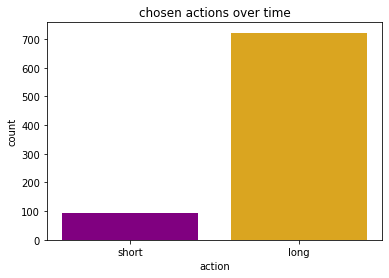

**** 
Training agent 5 times with time periods 2013-01-01 till 2017-06-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


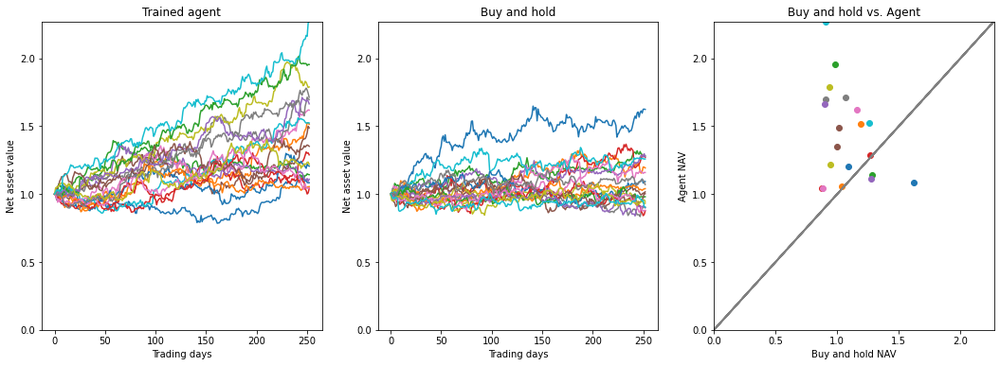

(             agent_avg  market_avg  agent_better
return        1.438478    1.080007          0.85
return_risk   0.863538    0.402058          1.00, array([1.08330637, 1.51412526, 1.14294418, 1.28882434, 1.10967866,
       1.35144493, 1.61799946, 1.69594046, 1.7886285 , 1.52311573,
       1.20552097, 1.05428422, 1.95379123, 1.04075395, 1.66438828,
       1.4874193 , 1.04440808, 1.71255131, 1.21909688, 2.27133261]), array([1.62341431, 1.19242855, 1.28184386, 1.26994638, 1.2756877 ,
       1.00159748, 1.15873324, 0.90247816, 0.93278034, 1.25854616,
       1.09278725, 1.03975466, 0.98039593, 0.87651731, 0.89837179,
       1.01616667, 0.8795948 , 1.07027035, 0.94592901, 0.90290214]))


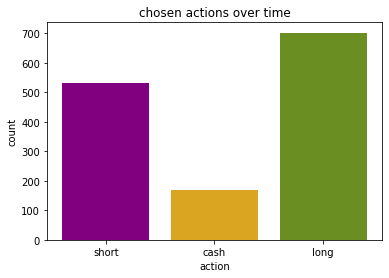

{'short': 533, 'cash': 169, 'long': 702}


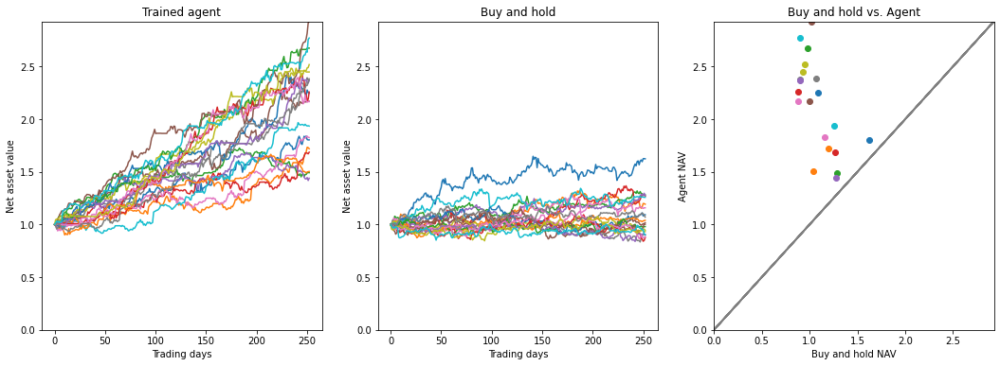

(             agent_avg  market_avg  agent_better
return        2.135233    1.080007           1.0
return_risk   1.308144    0.402058           1.0, array([1.80337198, 1.71957898, 1.49198789, 1.68620299, 1.43960809,
       2.16913823, 1.82525961, 2.37540451, 2.44762709, 1.93433507,
       2.24707359, 1.50305429, 2.67385808, 2.25765841, 2.36562519,
       2.92759332, 2.16656538, 2.38290744, 2.51770054, 2.77009995]), array([1.62341431, 1.19242855, 1.28184386, 1.26994638, 1.2756877 ,
       1.00159748, 1.15873324, 0.90247816, 0.93278034, 1.25854616,
       1.09278725, 1.03975466, 0.98039593, 0.87651731, 0.89837179,
       1.01616667, 0.8795948 , 1.07027035, 0.94592901, 0.90290214]))


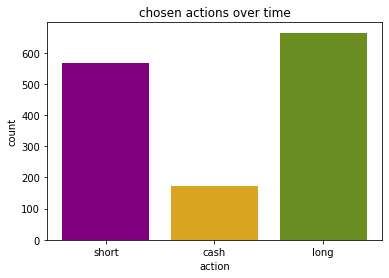

{'short': 567, 'cash': 173, 'long': 664}


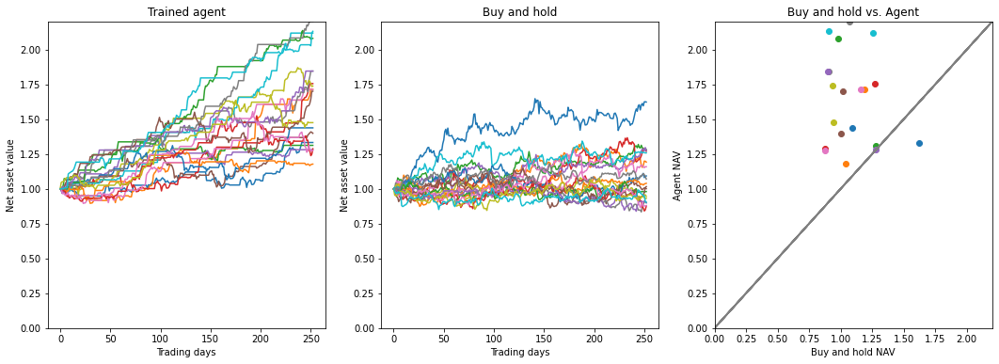

(             agent_avg  market_avg  agent_better
return        1.641402    1.080007          0.95
return_risk   1.159376    0.402058          1.00, array([1.33276302, 1.71373038, 1.31242431, 1.75582315, 1.28107612,
       1.3989974 , 1.71373038, 1.84570701, 1.73855502, 2.11869603,
       1.43802528, 1.17769776, 2.08059397, 1.28782234, 1.84570701,
       1.70116844, 1.27548387, 2.20334947, 1.47549245, 2.13119925]), array([1.62341431, 1.19242855, 1.28184386, 1.26994638, 1.2756877 ,
       1.00159748, 1.15873324, 0.90247816, 0.93278034, 1.25854616,
       1.09278725, 1.03975466, 0.98039593, 0.87651731, 0.89837179,
       1.01616667, 0.8795948 , 1.07027035, 0.94592901, 0.90290214]))


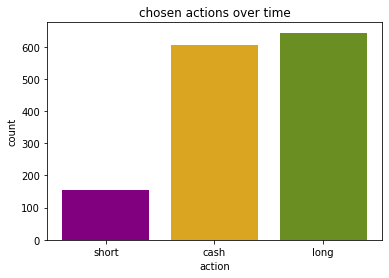

{'short': 154, 'cash': 606, 'long': 644}


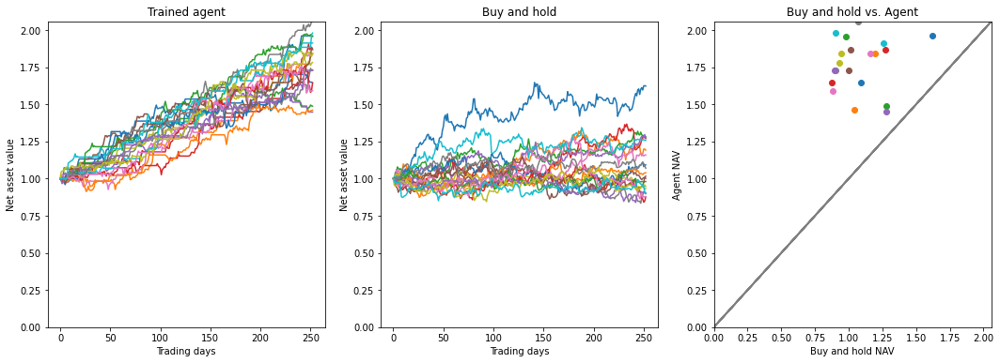

(             agent_avg  market_avg  agent_better
return        1.769162    1.080007           1.0
return_risk   1.482022    0.402058           1.0, array([1.96086277, 1.83949856, 1.48785926, 1.86994268, 1.44807229,
       1.73139181, 1.84198603, 1.72926811, 1.78152845, 1.91282376,
       1.64493166, 1.46085904, 1.95658318, 1.64372296, 1.72926811,
       1.87010046, 1.59187203, 2.05947771, 1.84302879, 1.98015933]), array([1.62341431, 1.19242855, 1.28184386, 1.26994638, 1.2756877 ,
       1.00159748, 1.15873324, 0.90247816, 0.93278034, 1.25854616,
       1.09278725, 1.03975466, 0.98039593, 0.87651731, 0.89837179,
       1.01616667, 0.8795948 , 1.07027035, 0.94592901, 0.90290214]))


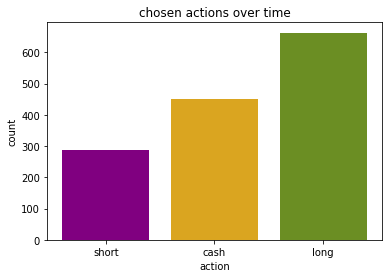

{'short': 289, 'cash': 452, 'long': 663}


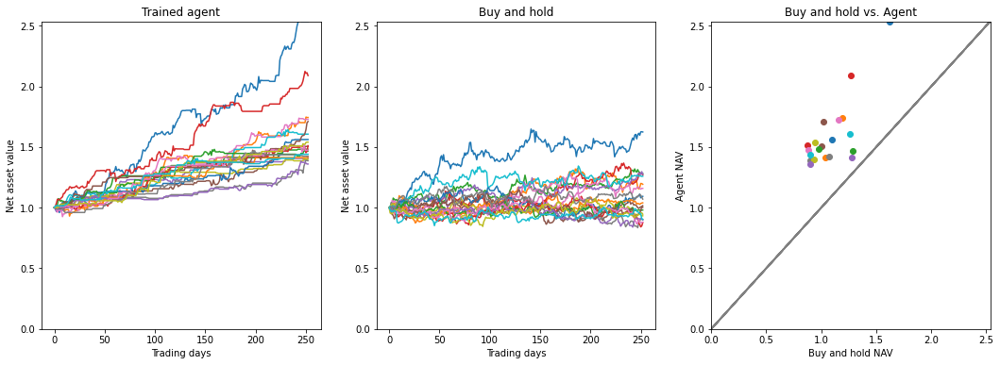

(             agent_avg  market_avg  agent_better
return        1.589254    1.080007           1.0
return_risk   1.295247    0.402058           1.0, array([2.53525117, 1.74281213, 1.46706947, 2.08824116, 1.41292464,
       1.50447394, 1.72721529, 1.38692126, 1.39991515, 1.60570686,
       1.56124199, 1.415177  , 1.48061094, 1.51051079, 1.35944171,
       1.7097396 , 1.47402551, 1.4241919 , 1.53979659, 1.43981366]), array([1.62341431, 1.19242855, 1.28184386, 1.26994638, 1.2756877 ,
       1.00159748, 1.15873324, 0.90247816, 0.93278034, 1.25854616,
       1.09278725, 1.03975466, 0.98039593, 0.87651731, 0.89837179,
       1.01616667, 0.8795948 , 1.07027035, 0.94592901, 0.90290214]))


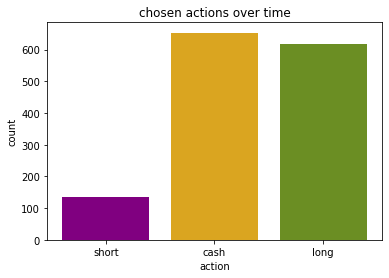

{'short': 135, 'cash': 653, 'long': 616}
**** 
Testing trained agent with time periods 2019-01-01 till 2022-06-01 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.42% of the data
Time period used for training or testing starts at:2020-04-30 00:00:00 and ends at: 2022-05-31 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_analysis.py:57: RuntimeWarning: invalid value encountered in double_scalars
  f_retrisk = [(np.mean(final_navs) - 1) / np.std(final_navs, ddof = 1)]


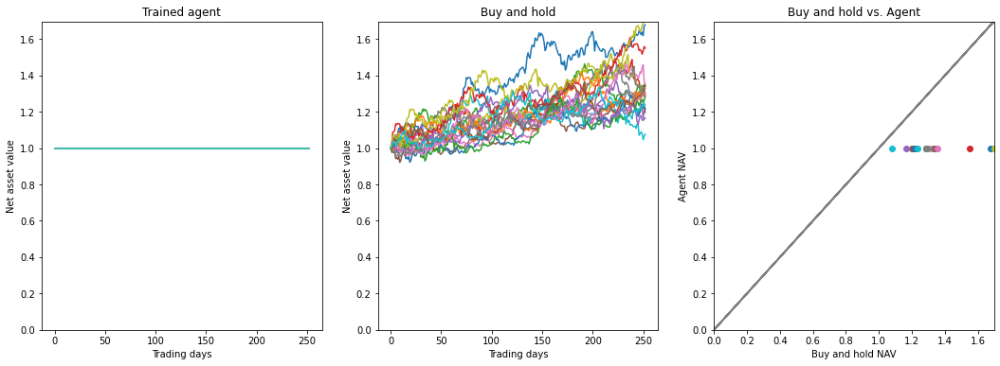

(             agent_avg  market_avg  agent_better
return             1.0    1.326362           0.0
return_risk        NaN    1.370146           0.0, array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.,
       1., 1., 1.]), array([1.67759429, 1.34012554, 1.33787795, 1.2949753 , 1.21433505,
       1.19736038, 1.29930479, 1.32676975, 1.34636747, 1.07697372,
       1.21674075, 1.28816436, 1.28538239, 1.54941061, 1.1651308 ,
       1.34162095, 1.35289164, 1.28539218, 1.69668408, 1.23413584]))


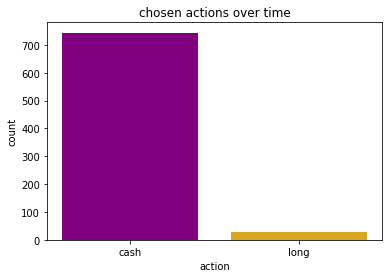

In [ ]:
for i in range (0,5):
    print('**** \nTraining agent 5 times with time periods '+ train_start_dates[i]+' till '+train_end_dates[i]+' \n****')
    env_train, model = train_agent(ticker_name = tickers[0] ,
                        ta_indicators_used = [],
                        start_date = train_start_dates[i],
                        end_date = train_end_dates[i])

    print('**** \nTesting trained agent with time periods '+ test_start_dates[i]+ ' till ' + test_end_dates[i]+' \n****')
    env_test = TradingEnvironmentNew(ticker = tickers[0],
        use_variables = env_train.data_source.df.columns[1:].to_list(),
        scaler = env_train.data_source.scaler,
        start_date = test_start_dates[i],
        end_date = test_end_dates[i]
        )
    res_test = ai_trade_performance(env_test, model, seeds = seed )
    print(res_test)
    actions_test = analyze_actions_taken(env_test, model, plot_actions = True ,environment_new = True)

**** 
Training agent 5 times with time periods 2011-01-01 till 2015-01-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


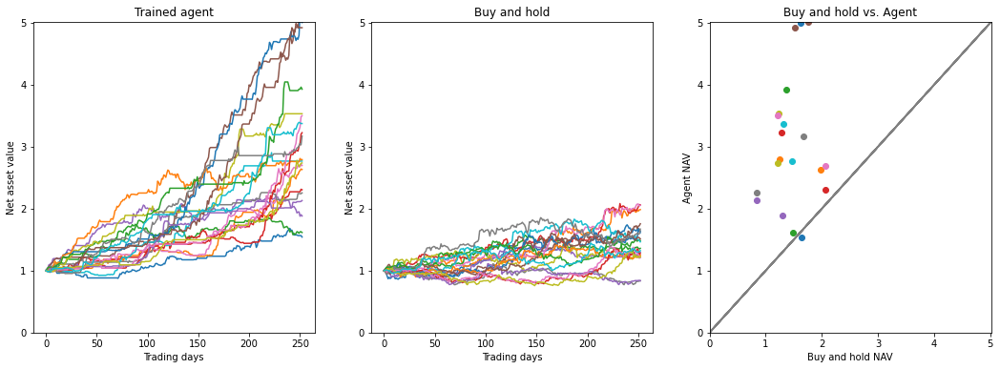

(             agent_avg  market_avg  agent_better
return        3.051177    1.453611          0.95
return_risk   1.027324    0.735080          1.00, array([1.5417682 , 2.63137461, 1.61458103, 2.30416883, 1.88198027,
       5.01883508, 2.69643305, 2.25422511, 3.53153418, 2.76746164,
       5.00368208, 2.79119691, 3.92808483, 3.2255066 , 2.1304846 ,
       4.92028378, 3.49992758, 3.17094472, 2.73743373, 3.37363621]), array([1.6377468 , 1.98471911, 1.48375074, 2.06002193, 1.29776034,
       1.75612902, 2.05519525, 0.83641154, 1.23004099, 1.4637562 ,
       1.61332324, 1.24796073, 1.35955   , 1.27595659, 0.83674825,
       1.51136837, 1.20831539, 1.67051703, 1.22007109, 1.32287076]))


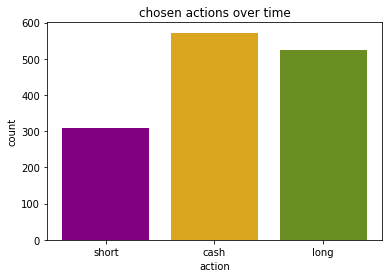

{'short': 309, 'cash': 572, 'long': 523}


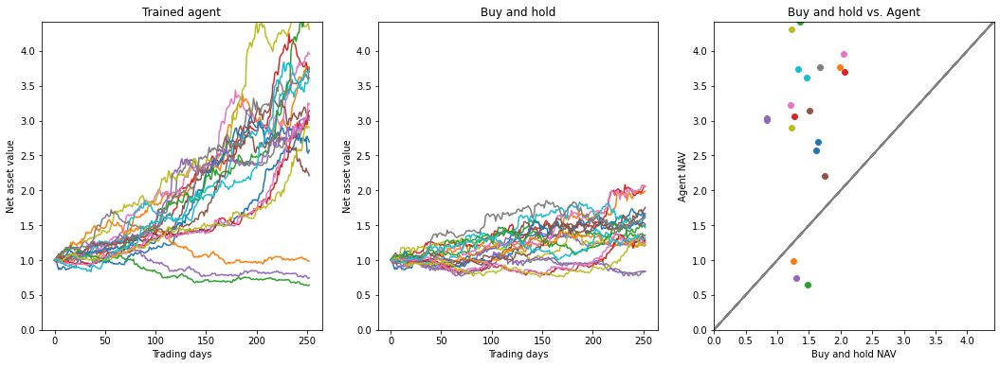

(             agent_avg  market_avg  agent_better
return        2.975509    1.453611          0.85
return_risk   0.927732    0.735080          1.00, array([2.6965702 , 3.7670842 , 0.64173912, 3.7042885 , 0.74529952,
       2.2099317 , 3.95301295, 3.03705989, 4.30807165, 3.61514538,
       2.57684703, 0.98701774, 4.42258802, 3.05930801, 3.00363967,
       3.1443075 , 3.23056731, 3.76479851, 2.90461257, 3.7382928 ]), array([1.6377468 , 1.98471911, 1.48375074, 2.06002193, 1.29776034,
       1.75612902, 2.05519525, 0.83641154, 1.23004099, 1.4637562 ,
       1.61332324, 1.24796073, 1.35955   , 1.27595659, 0.83674825,
       1.51136837, 1.20831539, 1.67051703, 1.22007109, 1.32287076]))


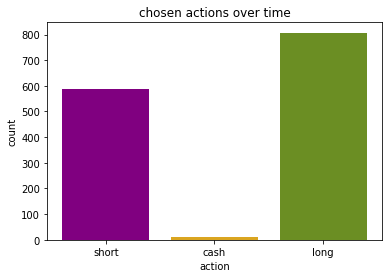

{'short': 588, 'cash': 9, 'long': 807}


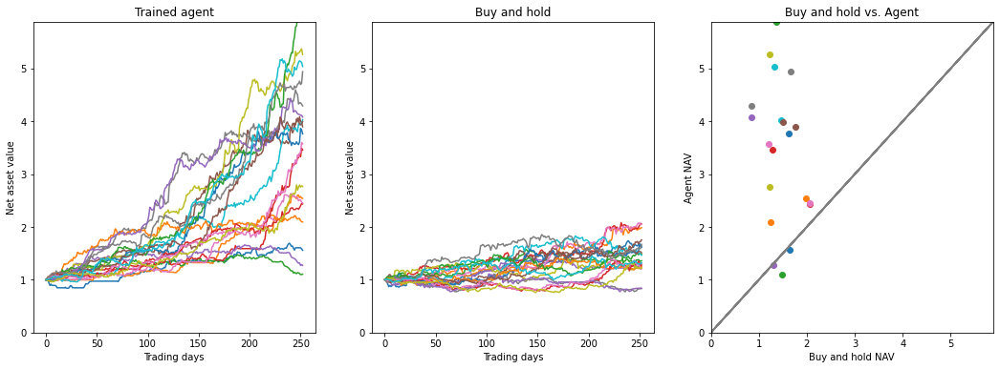

(             agent_avg  market_avg  agent_better
return        3.421866    1.453611          0.85
return_risk   0.970714    0.735080          1.00, array([1.55910609, 2.53954879, 1.10629368, 2.43423543, 1.27263603,
       3.89794202, 2.45101606, 4.29259006, 5.26255948, 4.03016226,
       3.76214682, 2.09374691, 5.88820534, 3.45555082, 4.07974313,
       3.99433132, 3.57255209, 4.93985005, 2.76597538, 5.0391226 ]), array([1.6377468 , 1.98471911, 1.48375074, 2.06002193, 1.29776034,
       1.75612902, 2.05519525, 0.83641154, 1.23004099, 1.4637562 ,
       1.61332324, 1.24796073, 1.35955   , 1.27595659, 0.83674825,
       1.51136837, 1.20831539, 1.67051703, 1.22007109, 1.32287076]))


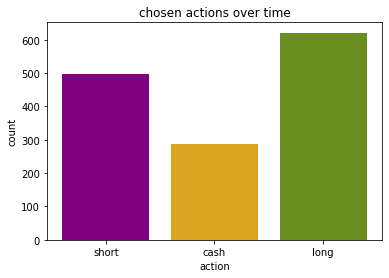

{'short': 496, 'cash': 287, 'long': 621}


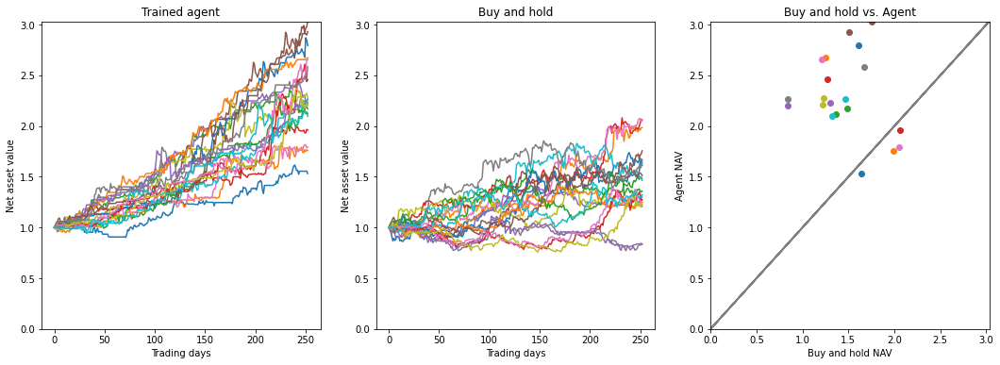

(             agent_avg  market_avg  agent_better
return        2.300182    1.453611           0.8
return_risk   1.214692    0.735080           1.0, array([1.53166917, 1.75956053, 2.17022988, 1.96018961, 2.22656677,
       3.03225006, 1.79404986, 2.2640917 , 2.27449801, 2.26496083,
       2.79363398, 2.67257915, 2.1216177 , 2.45725394, 2.20353123,
       2.93083029, 2.6533551 , 2.5840054 , 2.21220662, 2.09656531]), array([1.6377468 , 1.98471911, 1.48375074, 2.06002193, 1.29776034,
       1.75612902, 2.05519525, 0.83641154, 1.23004099, 1.4637562 ,
       1.61332324, 1.24796073, 1.35955   , 1.27595659, 0.83674825,
       1.51136837, 1.20831539, 1.67051703, 1.22007109, 1.32287076]))


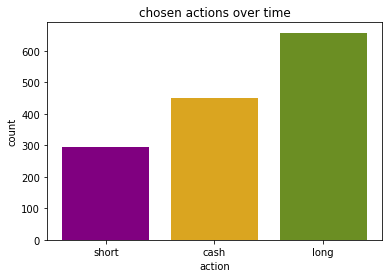

{'short': 296, 'cash': 451, 'long': 657}


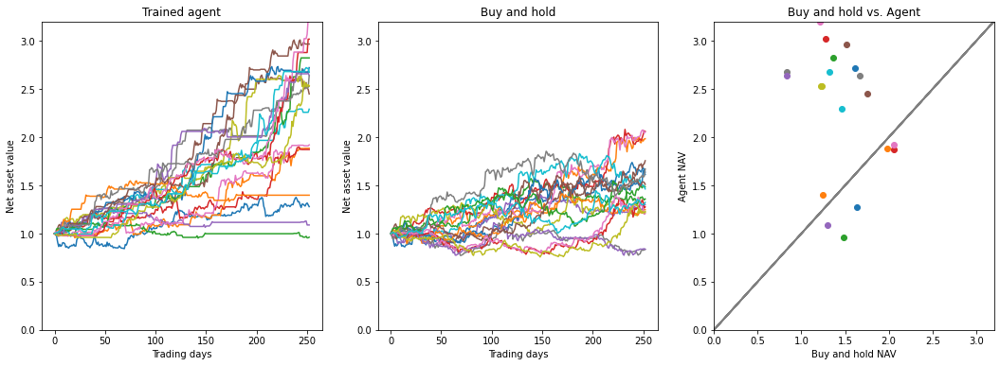

(             agent_avg  market_avg  agent_better
return        2.279044    1.453611           0.7
return_risk   1.037046    0.735080           1.0, array([1.27938297, 1.88563931, 0.96230099, 1.87245925, 1.08931264,
       2.44950463, 1.92110853, 2.67577264, 2.52869084, 2.29177417,
       2.72307805, 1.39842911, 2.82401812, 3.01892587, 2.64300847,
       2.96801767, 3.20294963, 2.63657008, 2.53532621, 2.67461818]), array([1.6377468 , 1.98471911, 1.48375074, 2.06002193, 1.29776034,
       1.75612902, 2.05519525, 0.83641154, 1.23004099, 1.4637562 ,
       1.61332324, 1.24796073, 1.35955   , 1.27595659, 0.83674825,
       1.51136837, 1.20831539, 1.67051703, 1.22007109, 1.32287076]))


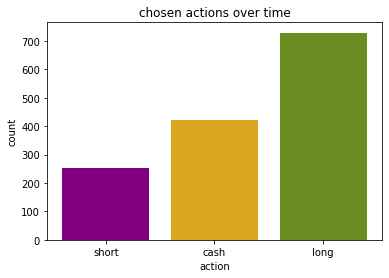

{'short': 252, 'cash': 423, 'long': 729}
**** 
Testing trained agent with time periods 2017-01-01 till 2020-01-01 
-****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 9.63% of the data
Time period used for training or testing starts at:2018-04-23 00:00:00 and ends at: 2019-12-31 00:00:00


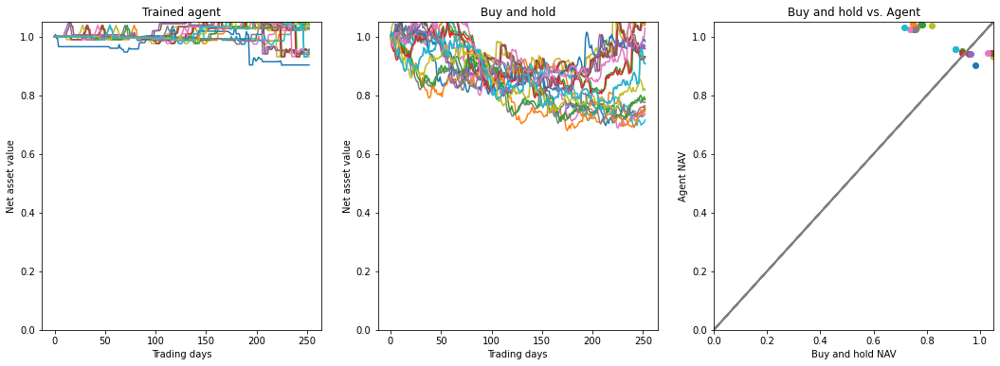

(             agent_avg  market_avg  agent_better
return        0.982554    0.880098          0.65
return_risk   0.216378   -1.187679          1.00, array([1.02574887, 1.03086969, 0.95191892, 0.94251357, 0.95629786,
       0.94091766, 1.02574887, 1.03972222, 0.93020696, 1.03086969,
       0.90310686, 1.04473758, 1.04037825, 0.94251357, 0.94091766,
       0.94251357, 0.94251357, 1.02574887, 1.03754345, 0.95629786]), array([0.75095771, 0.76329463, 0.93100031, 1.04105226, 0.90744847,
       0.95829206, 0.73671094, 0.77566775, 1.05155259, 0.71535118,
       0.9833666 , 0.74658186, 0.7846424 , 0.93173198, 0.96481714,
       1.04727655, 1.02906362, 0.75726419, 0.8184487 , 0.90744847]))


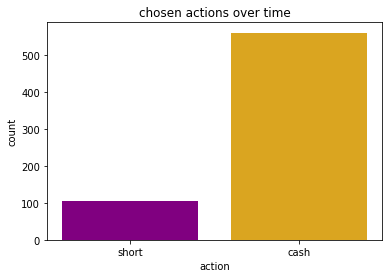

**** 
Training agent 5 times with time periods 2011-06-01 till 2016-01-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


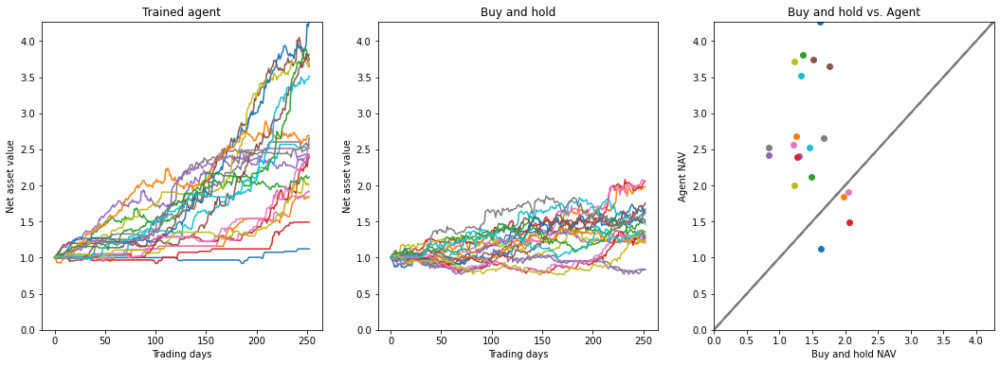

(             agent_avg  market_avg  agent_better
return        2.667135    1.453611           0.8
return_risk   0.954232    0.735080           1.0, array([1.12199547, 1.84333026, 2.11515555, 1.49132638, 2.40478325,
       3.64485508, 1.91097427, 2.5215049 , 3.72040221, 2.51821738,
       4.27082034, 2.68556393, 3.81420392, 2.38742526, 2.41435014,
       3.74307218, 2.56029955, 2.65774605, 2.00307932, 3.51359312]), array([1.63774663, 1.98471891, 1.48375066, 2.06002206, 1.29776068,
       1.75612936, 2.05519439, 0.8364117 , 1.23004121, 1.46375709,
       1.61332335, 1.247961  , 1.35955014, 1.27595671, 0.83674835,
       1.51136849, 1.20831541, 1.6705168 , 1.22007088, 1.32287081]))


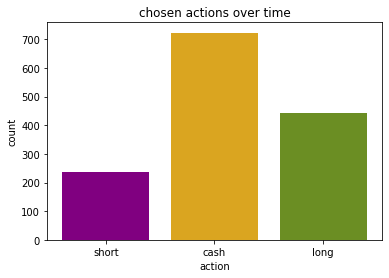

{'short': 237, 'cash': 723, 'long': 444}


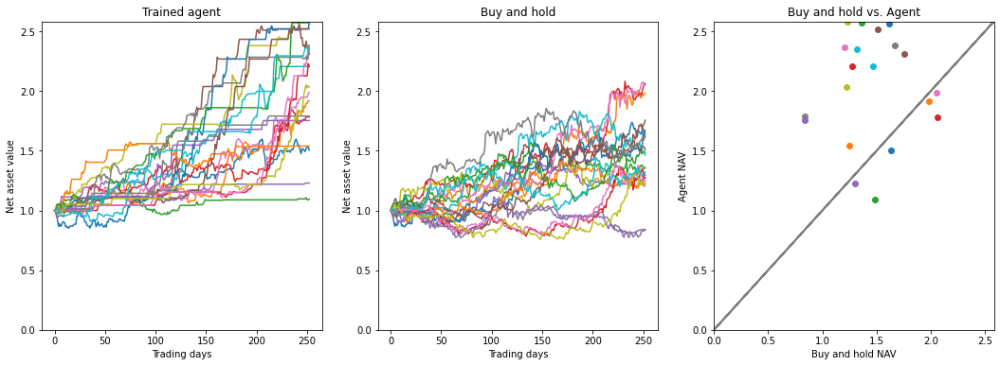

(             agent_avg  market_avg  agent_better
return        2.035136    1.453611           0.7
return_risk   0.995781    0.735080           1.0, array([1.50697628, 1.91648892, 1.09540226, 1.78422289, 1.22959991,
       2.30786387, 1.98764413, 1.7908252 , 2.58353184, 2.20614912,
       2.56348357, 1.53932677, 2.57233816, 2.20864053, 1.75340176,
       2.52067634, 2.36856894, 2.37934695, 2.03521065, 2.35302365]), array([1.63774663, 1.98471891, 1.48375066, 2.06002206, 1.29776068,
       1.75612936, 2.05519439, 0.8364117 , 1.23004121, 1.46375709,
       1.61332335, 1.247961  , 1.35955014, 1.27595671, 0.83674835,
       1.51136849, 1.20831541, 1.6705168 , 1.22007088, 1.32287081]))


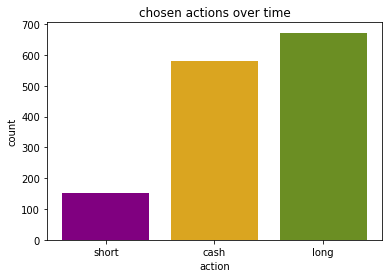

{'short': 151, 'cash': 581, 'long': 672}


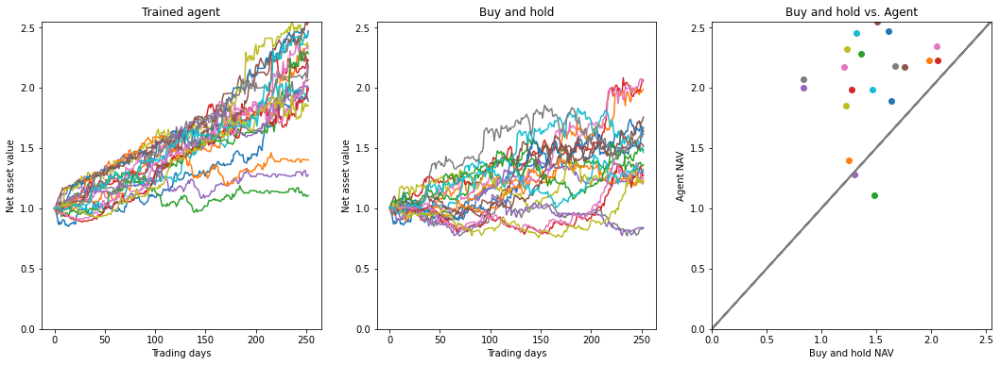

(             agent_avg  market_avg  agent_better
return        2.047497    1.453611           0.9
return_risk   1.264468    0.735080           1.0, array([1.88904674, 2.22939422, 1.106318  , 2.22435734, 1.27737325,
       2.16863803, 2.34145126, 2.06730962, 2.32293777, 1.98351384,
       2.46935048, 1.40107625, 2.28200393, 1.98237604, 1.99983129,
       2.54943697, 2.17041417, 2.17967198, 1.8507022 , 2.45473368]), array([1.63774663, 1.98471891, 1.48375066, 2.06002206, 1.29776068,
       1.75612936, 2.05519439, 0.8364117 , 1.23004121, 1.46375709,
       1.61332335, 1.247961  , 1.35955014, 1.27595671, 0.83674835,
       1.51136849, 1.20831541, 1.6705168 , 1.22007088, 1.32287081]))


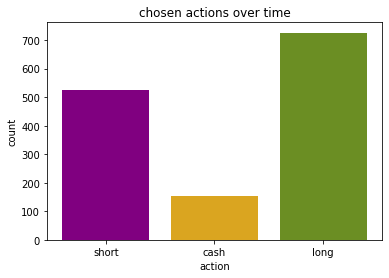

{'short': 526, 'cash': 152, 'long': 726}


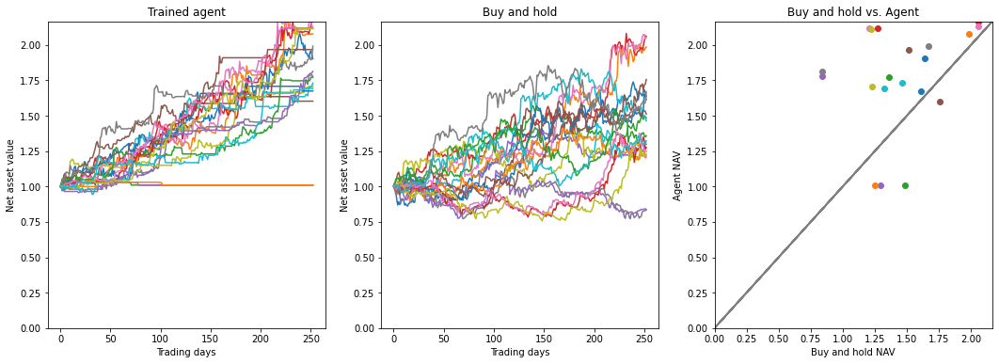

(             agent_avg  market_avg  agent_better
return        1.769447    1.453611           0.8
return_risk   1.144970    0.735080           1.0, array([1.90252041, 2.07917014, 1.01024727, 2.1672922 , 1.01024727,
       1.60307207, 2.13060845, 1.81368859, 1.70553612, 1.73136702,
       1.67478167, 1.01024727, 1.77172075, 2.11784669, 1.77621402,
       1.96767117, 2.11784669, 1.99153892, 2.11459849, 1.69273229]), array([1.63774663, 1.98471891, 1.48375066, 2.06002206, 1.29776068,
       1.75612936, 2.05519439, 0.8364117 , 1.23004121, 1.46375709,
       1.61332335, 1.247961  , 1.35955014, 1.27595671, 0.83674835,
       1.51136849, 1.20831541, 1.6705168 , 1.22007088, 1.32287081]))


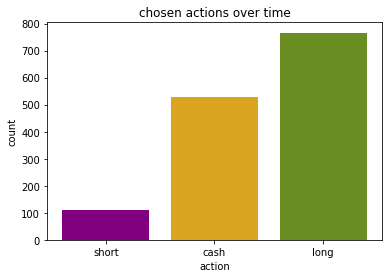

{'short': 111, 'cash': 527, 'long': 766}


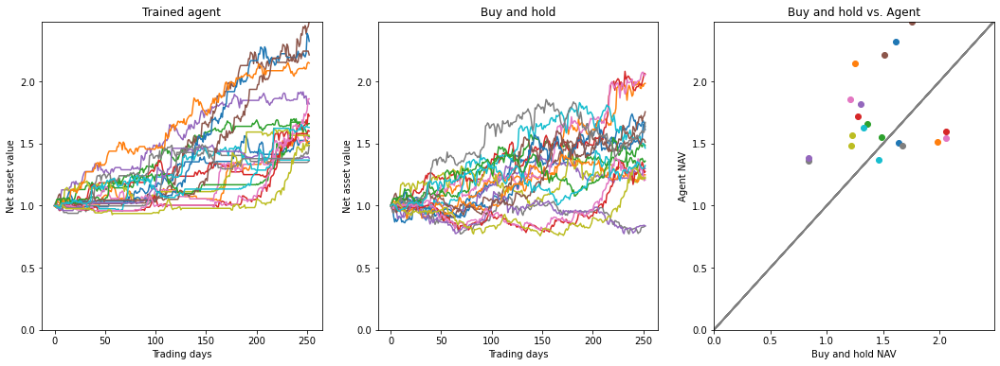

(             agent_avg  market_avg  agent_better
return        1.711672    1.453611           0.7
return_risk   0.923511    0.735080           1.0, array([1.50441071, 1.51699585, 1.55280632, 1.60080597, 1.81952888,
       2.48373215, 1.54495054, 1.36131958, 1.5660012 , 1.36765842,
       2.32359898, 2.14786961, 1.66088567, 1.72215017, 1.38239666,
       2.21440592, 1.85958606, 1.48702904, 1.48658747, 1.6307246 ]), array([1.63774663, 1.98471891, 1.48375066, 2.06002206, 1.29776068,
       1.75612936, 2.05519439, 0.8364117 , 1.23004121, 1.46375709,
       1.61332335, 1.247961  , 1.35955014, 1.27595671, 0.83674835,
       1.51136849, 1.20831541, 1.6705168 , 1.22007088, 1.32287081]))


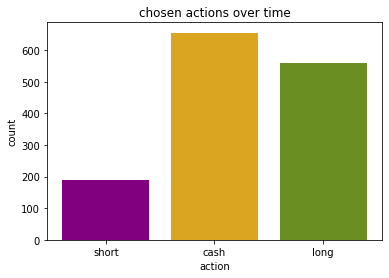

{'short': 190, 'cash': 655, 'long': 559}
**** 
Testing trained agent with time periods 2017-06-01 till 2021-01-01 
-****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.01% of the data
Time period used for training or testing starts at:2018-09-18 00:00:00 and ends at: 2020-12-31 00:00:00


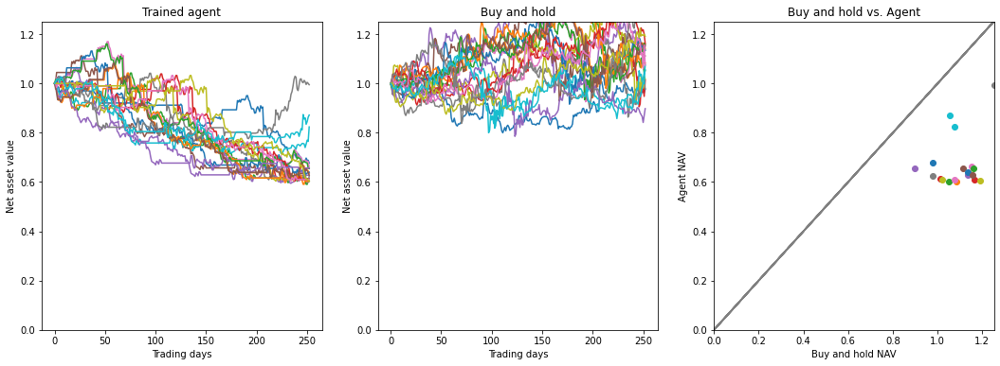

(             agent_avg  market_avg  agent_better
return        0.670393    1.091102           0.0
return_risk  -1.262619    0.552162           0.0, array([0.67708962, 0.63542075, 0.60288789, 0.61403722, 0.62778259,
       0.65582533, 0.66325031, 0.62389358, 0.60964774, 0.82361232,
       0.6398959 , 0.60310304, 0.65516011, 0.61024511, 0.65702295,
       0.62791175, 0.61024511, 0.99495891, 0.60396864, 0.87189839]), array([0.97727711, 1.14077719, 1.05123854, 1.01365034, 1.13527746,
       1.11192965, 1.15368946, 0.9779329 , 1.01878691, 1.07619606,
       1.13484578, 1.08338687, 1.15965117, 1.16249225, 0.89764162,
       1.15441937, 1.07410105, 1.25184657, 1.1915055 , 1.05539847]))


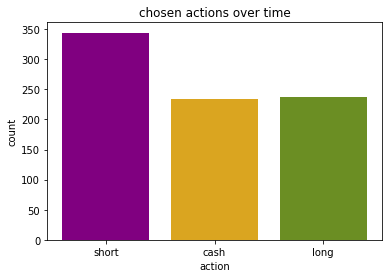

**** 
Training agent 5 times with time periods 2012-01-01 till 2017-01-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


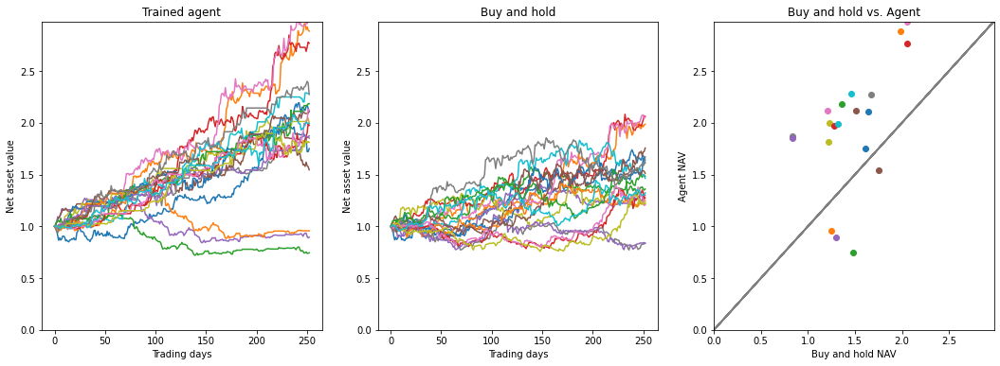

(             agent_avg  market_avg  agent_better
return        1.955416    1.453611           0.8
return_risk   1.067363    0.735080           1.0, array([2.10736079, 2.88487501, 0.74428378, 2.76845739, 0.89552775,
       1.5452332 , 2.978626  , 1.87332929, 2.0017404 , 2.28366542,
       1.74988659, 0.95680444, 2.18408007, 1.97432581, 1.85161143,
       2.11406924, 2.11728793, 2.27302241, 1.81165744, 1.99247804]), array([1.63774634, 1.98471952, 1.48375049, 2.06002193, 1.29776019,
       1.75612922, 2.05519439, 0.83641146, 1.23004149, 1.46375615,
       1.61332335, 1.24796119, 1.35955063, 1.27595678, 0.83674852,
       1.51136802, 1.20831506, 1.67051671, 1.22007133, 1.32287101]))


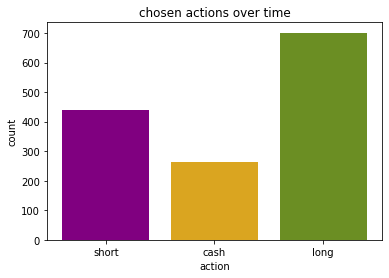

{'short': 439, 'cash': 264, 'long': 701}


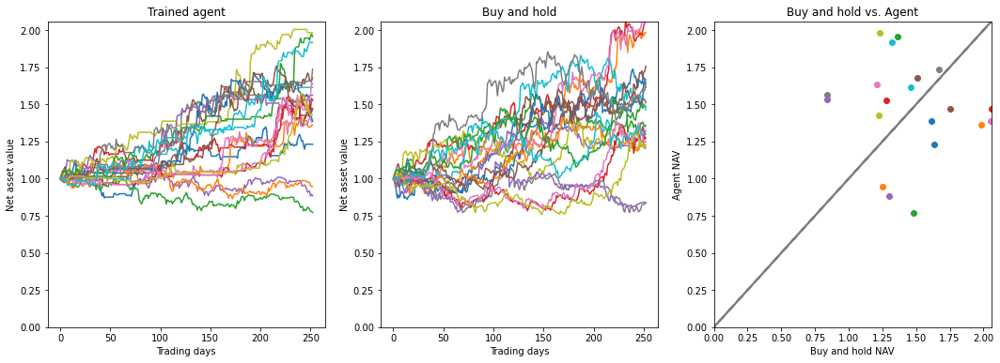

(             agent_avg  market_avg  agent_better
return        1.474001    1.453611          0.55
return_risk   0.800955    0.735080          1.00, array([1.23194104, 1.36068833, 0.77212321, 1.46773544, 0.88504629,
       1.4724975 , 1.38800345, 1.56226918, 1.98256067, 1.61432704,
       1.38572778, 0.9470612 , 1.95706511, 1.52567039, 1.53053702,
       1.67719313, 1.6361451 , 1.7372749 , 1.42879331, 1.91735674]), array([1.63774634, 1.98471952, 1.48375049, 2.06002193, 1.29776019,
       1.75612922, 2.05519439, 0.83641146, 1.23004149, 1.46375615,
       1.61332335, 1.24796119, 1.35955063, 1.27595678, 0.83674852,
       1.51136802, 1.20831506, 1.67051671, 1.22007133, 1.32287101]))


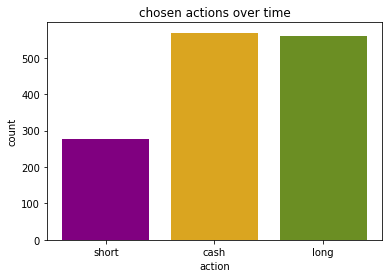

{'short': 276, 'cash': 569, 'long': 559}


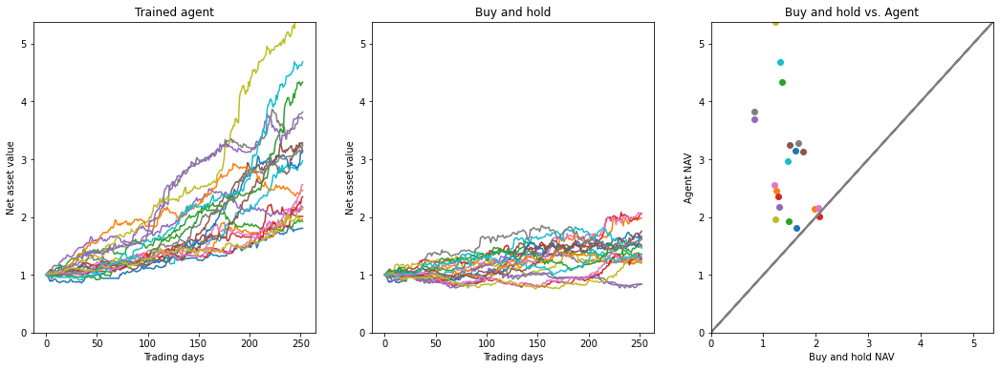

(             agent_avg  market_avg  agent_better
return        2.963019    1.453611          0.95
return_risk   0.982767    0.735080          1.00, array([1.80561478, 2.13935145, 1.92136179, 2.01103508, 2.17024924,
       3.13037126, 2.1672793 , 3.81867247, 5.3841808 , 2.97373582,
       3.15417517, 2.45943064, 4.33753582, 2.35155823, 3.69724317,
       3.24383318, 2.56278095, 3.28443958, 1.9591416 , 4.68839179]), array([1.63774634, 1.98471952, 1.48375049, 2.06002193, 1.29776019,
       1.75612922, 2.05519439, 0.83641146, 1.23004149, 1.46375615,
       1.61332335, 1.24796119, 1.35955063, 1.27595678, 0.83674852,
       1.51136802, 1.20831506, 1.67051671, 1.22007133, 1.32287101]))


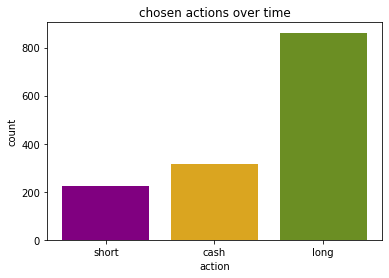

{'short': 226, 'cash': 316, 'long': 862}


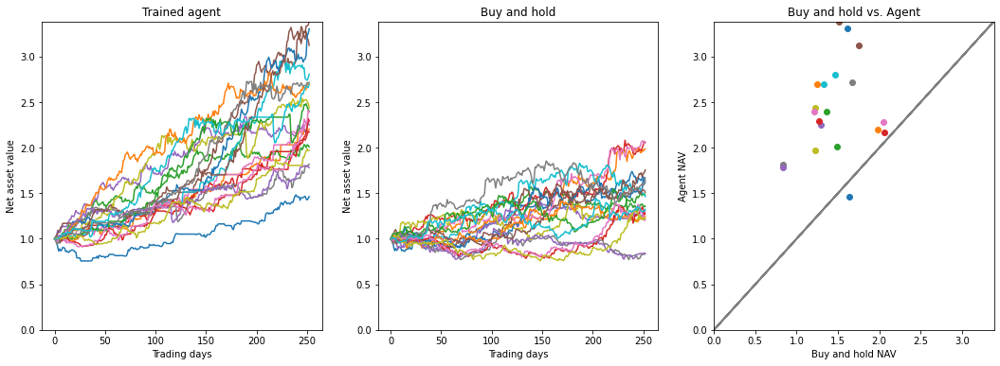

(             agent_avg  market_avg  agent_better
return        2.410019    1.453611          0.95
return_risk   1.168933    0.735080          1.00, array([1.46272112, 2.20073241, 2.0091793 , 2.17170717, 2.24943884,
       3.1239101 , 2.28149208, 1.81833787, 2.43707749, 2.80635687,
       3.30543636, 2.69719245, 2.40049788, 2.29722046, 1.77985512,
       3.38648375, 2.39196838, 2.71489092, 1.97050618, 2.69536615]), array([1.63774634, 1.98471952, 1.48375049, 2.06002193, 1.29776019,
       1.75612922, 2.05519439, 0.83641146, 1.23004149, 1.46375615,
       1.61332335, 1.24796119, 1.35955063, 1.27595678, 0.83674852,
       1.51136802, 1.20831506, 1.67051671, 1.22007133, 1.32287101]))


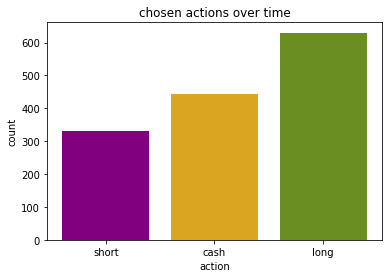

{'short': 331, 'cash': 443, 'long': 630}


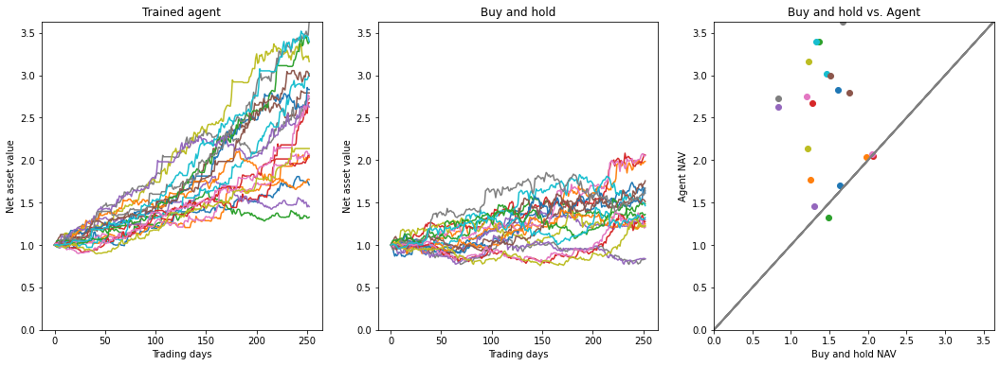

(             agent_avg  market_avg  agent_better
return        2.527063    1.453611           0.9
return_risk   1.128710    0.735080           1.0, array([1.70677838, 2.03240542, 1.32775746, 2.04854803, 1.45229198,
       2.7921676 , 2.06770571, 2.72563312, 3.16156173, 3.01875329,
       2.83244908, 1.77121011, 3.39414796, 2.67487242, 2.62592153,
       2.99060583, 2.7500582 , 3.6347653 , 2.13662739, 3.39699629]), array([1.63774634, 1.98471952, 1.48375049, 2.06002193, 1.29776019,
       1.75612922, 2.05519439, 0.83641146, 1.23004149, 1.46375615,
       1.61332335, 1.24796119, 1.35955063, 1.27595678, 0.83674852,
       1.51136802, 1.20831506, 1.67051671, 1.22007133, 1.32287101]))


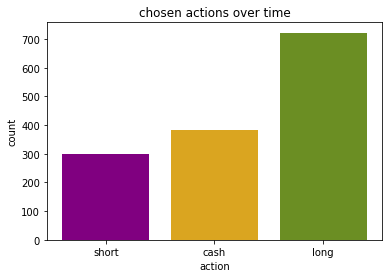

{'short': 299, 'cash': 383, 'long': 722}
**** 
Testing trained agent with time periods 2018-01-01 till 2021-06-01 
-****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.45% of the data
Time period used for training or testing starts at:2019-04-26 00:00:00 and ends at: 2021-05-31 00:00:00


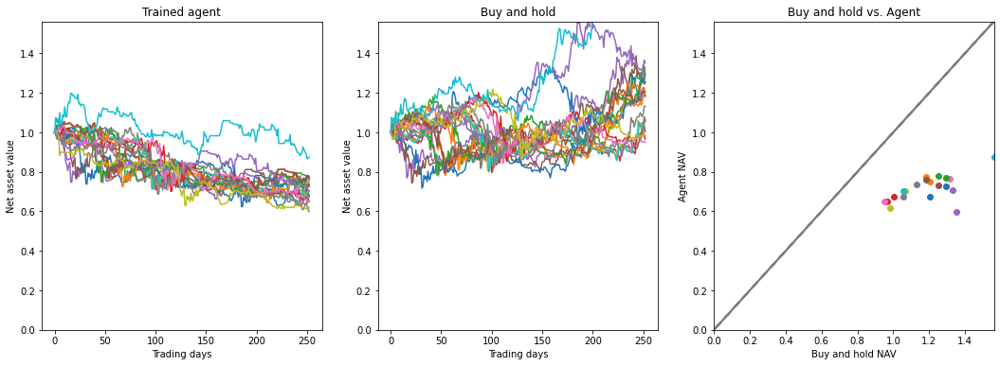

(             agent_avg  market_avg  agent_better
return        0.716031    1.182147           0.0
return_risk  -1.567645    0.163398           0.0, array([0.6747446 , 0.77630271, 0.77726341, 0.6753392 , 0.70544831,
       0.73230825, 0.76594858, 0.7371486 , 0.70143653, 0.70092336,
       0.72575152, 0.75309267, 0.77162506, 0.64904855, 0.59926408,
       0.7615465 , 0.64801633, 0.67516016, 0.61659364, 0.87365669]), array([1.20470887, 1.18473818, 1.25184645, 1.0037098 , 1.32963793,
       1.25364577, 1.3148917 , 1.13242825, 1.06584864, 1.05539859,
       1.29511555, 1.20490696, 1.29474734, 0.96628173, 1.3519508 ,
       1.18246313, 0.94864325, 1.0580102 , 0.98219657, 1.56177722]))


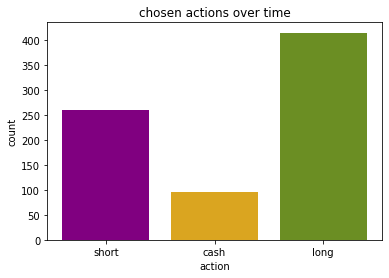

**** 
Training agent 5 times with time periods 2012-06-01 till 2017-01-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


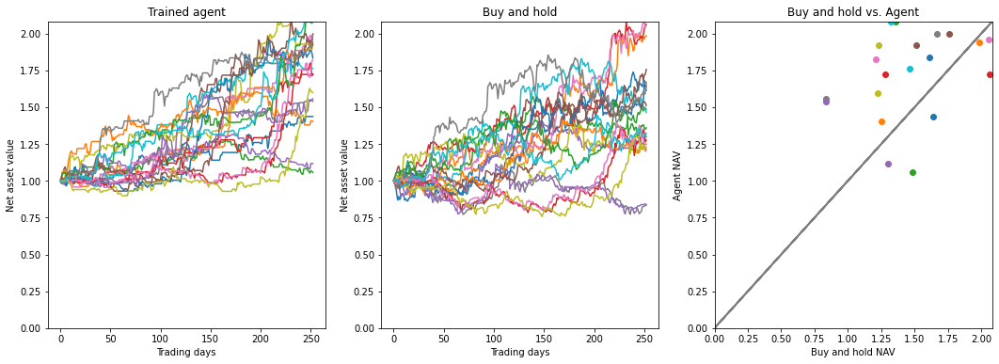

(             agent_avg  market_avg  agent_better
return        1.723744    1.453611           0.7
return_risk   0.993851    0.735080           1.0, array([1.43677358, 1.93811171, 1.05584197, 1.72205687, 1.11703082,
       1.99714869, 1.96248226, 1.55600644, 1.92231221, 1.76343582,
       1.83496927, 1.40275911, 2.08294845, 1.72515674, 1.53977082,
       1.92230748, 1.82252155, 1.99624555, 1.59843031, 2.0785774 ]), array([1.6377466 , 1.98471911, 1.48375095, 2.0600218 , 1.29776019,
       1.7561295 , 2.05519482, 0.83641146, 1.23004116, 1.46375654,
       1.61332324, 1.24796098, 1.35955058, 1.27595674, 0.83674817,
       1.51136773, 1.20831519, 1.67051682, 1.22007135, 1.32287043]))


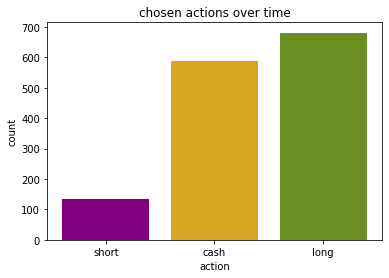

{'short': 134, 'cash': 589, 'long': 681}


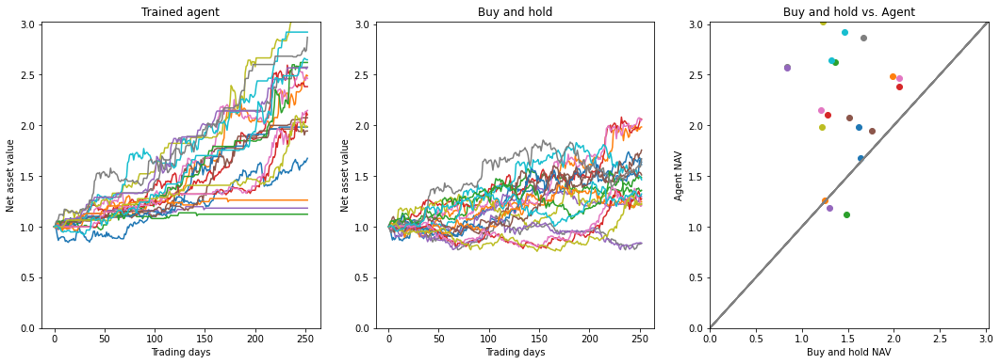

(             agent_avg  market_avg  agent_better
return        2.202485    1.453611           0.9
return_risk   1.063298    0.735080           1.0, array([1.6753362 , 2.48963687, 1.12310507, 2.3821985 , 1.18357332,
       1.94426111, 2.46208   , 2.57384622, 3.02672311, 2.92009994,
       1.98300244, 1.26233582, 2.6203642 , 2.10518817, 2.57272556,
       2.07479032, 2.14764679, 2.86899903, 1.98662456, 2.6471685 ]), array([1.6377466 , 1.98471911, 1.48375095, 2.0600218 , 1.29776019,
       1.7561295 , 2.05519482, 0.83641146, 1.23004116, 1.46375654,
       1.61332324, 1.24796098, 1.35955058, 1.27595674, 0.83674817,
       1.51136773, 1.20831519, 1.67051682, 1.22007135, 1.32287043]))


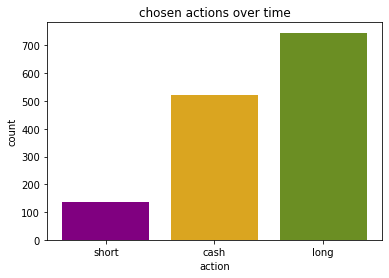

{'short': 136, 'cash': 522, 'long': 746}


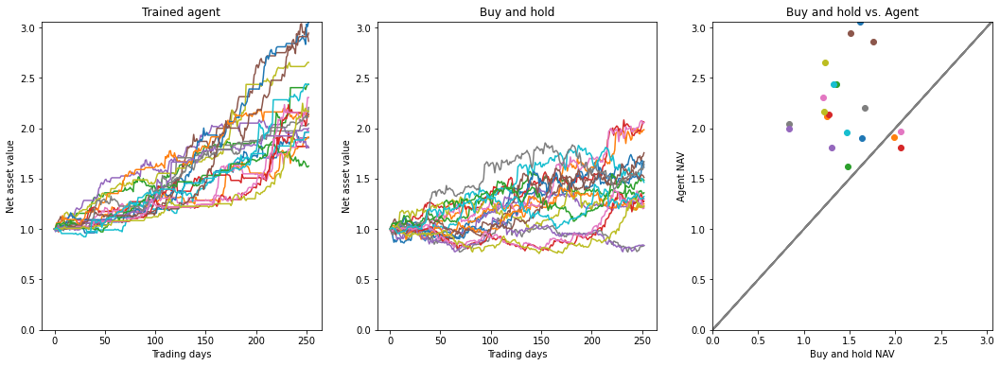

(             agent_avg  market_avg  agent_better
return        2.217417    1.453611          0.85
return_risk   1.177576    0.735080          1.00, array([1.90483066, 1.91069023, 1.62475703, 1.81211804, 1.80703772,
       2.86255981, 1.97076317, 2.04388431, 2.65239842, 1.95949137,
       3.05926253, 2.11642509, 2.43500638, 2.13407381, 1.9995567 ,
       2.94277602, 2.3043832 , 2.20637453, 2.16825681, 2.43368771]), array([1.6377466 , 1.98471911, 1.48375095, 2.0600218 , 1.29776019,
       1.7561295 , 2.05519482, 0.83641146, 1.23004116, 1.46375654,
       1.61332324, 1.24796098, 1.35955058, 1.27595674, 0.83674817,
       1.51136773, 1.20831519, 1.67051682, 1.22007135, 1.32287043]))


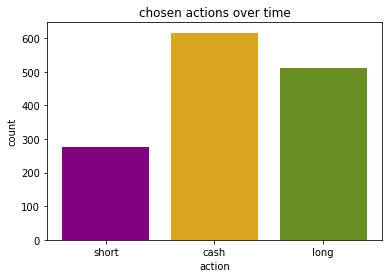

{'short': 277, 'cash': 616, 'long': 511}


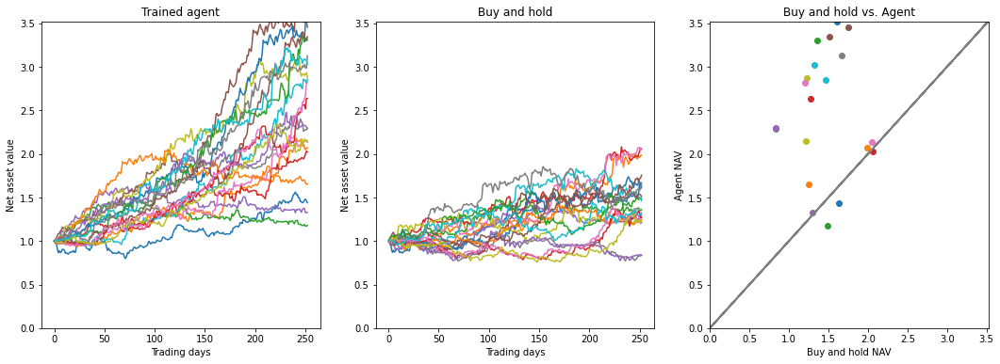

(             agent_avg  market_avg  agent_better
return        2.477198    1.453611          0.85
return_risk   1.106086    0.735080          1.00, array([1.43943612, 2.06955249, 1.17883933, 2.02416566, 1.32602562,
       3.4554084 , 2.13482834, 2.29381991, 2.87458642, 2.85551289,
       3.5240794 , 1.65482797, 3.30623083, 2.63830635, 2.29412142,
       3.3474741 , 2.8189079 , 3.12804193, 2.15128931, 3.02851424]), array([1.6377466 , 1.98471911, 1.48375095, 2.0600218 , 1.29776019,
       1.7561295 , 2.05519482, 0.83641146, 1.23004116, 1.46375654,
       1.61332324, 1.24796098, 1.35955058, 1.27595674, 0.83674817,
       1.51136773, 1.20831519, 1.67051682, 1.22007135, 1.32287043]))


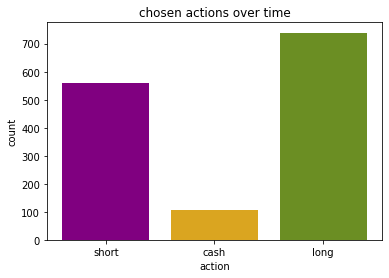

{'short': 558, 'cash': 107, 'long': 739}


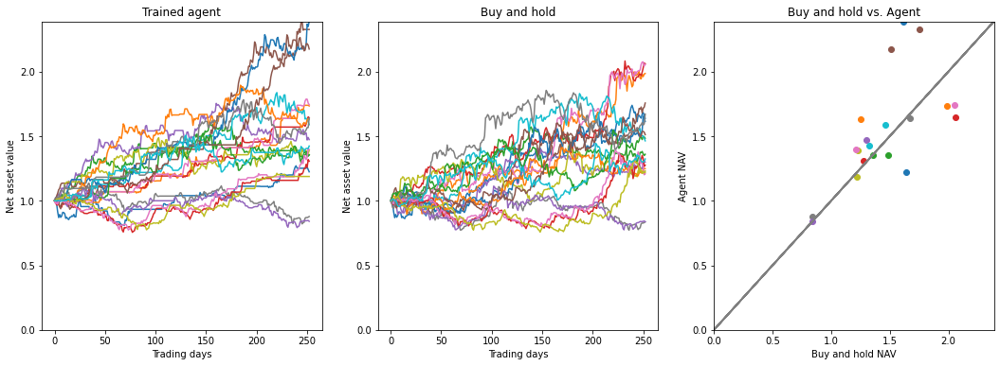

(             agent_avg  market_avg  agent_better
return        1.534758    1.453611           0.6
return_risk   0.906883    0.735080           1.0, array([1.22380893, 1.73361099, 1.35419768, 1.64268568, 1.47299971,
       2.32588955, 1.74362589, 0.87769687, 1.39022179, 1.58876003,
       2.38820187, 1.63026021, 1.35572262, 1.30594502, 0.84039755,
       2.17444927, 1.39588196, 1.6396599 , 1.18770401, 1.4234336 ]), array([1.6377466 , 1.98471911, 1.48375095, 2.0600218 , 1.29776019,
       1.7561295 , 2.05519482, 0.83641146, 1.23004116, 1.46375654,
       1.61332324, 1.24796098, 1.35955058, 1.27595674, 0.83674817,
       1.51136773, 1.20831519, 1.67051682, 1.22007135, 1.32287043]))


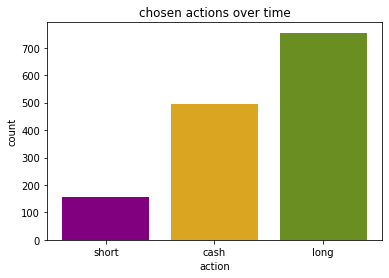

{'short': 155, 'cash': 494, 'long': 755}
**** 
Testing trained agent with time periods 2018-06-01 till 2022-01-01 
-****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.02% of the data
Time period used for training or testing starts at:2019-09-27 00:00:00 and ends at: 2021-12-31 00:00:00


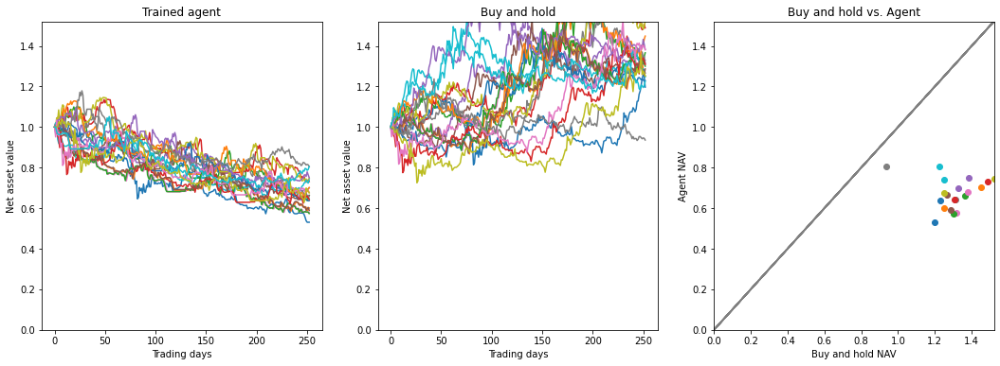

(             agent_avg  market_avg  agent_better
return        0.672884    1.302169           0.0
return_risk  -1.607686    0.868995           0.0, array([0.53063715, 0.60096738, 0.66187773, 0.73117163, 0.6997372 ,
       0.66362808, 0.57949961, 0.64485386, 0.7469026 , 0.73947767,
       0.63730614, 0.70190996, 0.57370624, 0.64240641, 0.75051292,
       0.58904441, 0.67823916, 0.80537949, 0.67541947, 0.80499773]), array([1.19698076, 1.25087349, 1.36587526, 1.48880965, 1.32943978,
       1.26628733, 1.31465612, 1.31304965, 1.520841  , 1.24759172,
       1.22934813, 1.44848723, 1.30021407, 1.30806615, 1.38278804,
       1.28619366, 1.38102871, 0.93601846, 1.25181662, 1.22501615]))


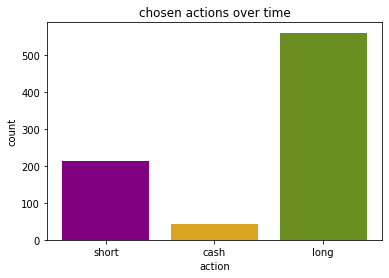

**** 
Training agent 5 times with time periods 2013-01-01 till 2017-06-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


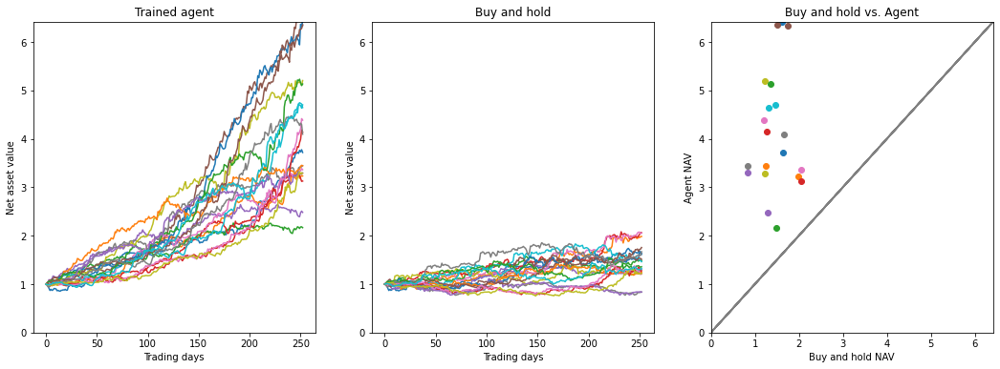

(             agent_avg  market_avg  agent_better
return        4.149234    1.453611           1.0
return_risk   1.078838    0.735080           1.0, array([3.71847938, 3.23309475, 2.1659646 , 3.12833636, 2.48090483,
       6.34096749, 3.36269579, 3.44512072, 5.20315367, 4.70015739,
       6.42105323, 3.44313194, 5.13250816, 4.14232148, 3.29695327,
       6.35214579, 4.38615082, 4.09666352, 3.28754031, 4.64734628]), array([1.63774657, 1.9847183 , 1.48375079, 2.06002206, 1.29776023,
       1.75612941, 2.0551946 , 0.8364116 , 1.23004119, 1.46375701,
       1.61332331, 1.24796098, 1.35955041, 1.27595641, 0.83674819,
       1.51136814, 1.20831539, 1.67051682, 1.2200708 , 1.32287085]))


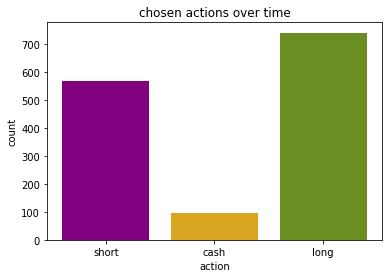

{'short': 567, 'cash': 97, 'long': 740}


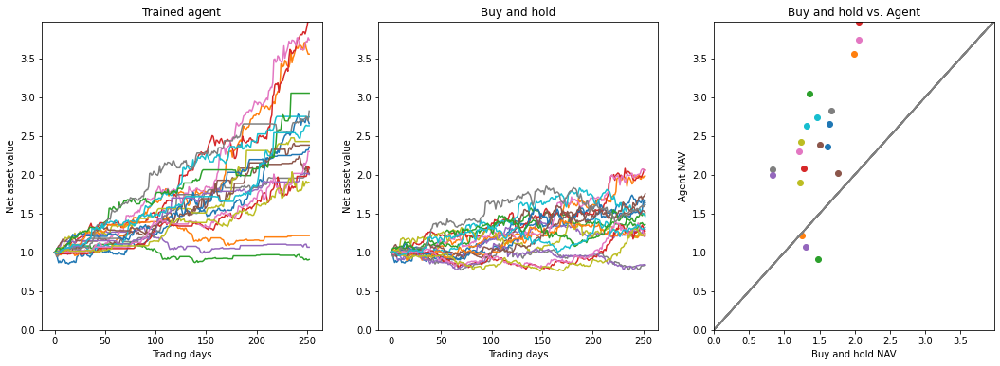

(             agent_avg  market_avg  agent_better
return        2.396221    1.453611          0.85
return_risk   1.042588    0.735080          1.00, array([2.66008701, 3.5555901 , 0.90796926, 3.97740675, 1.06600474,
       2.01607501, 3.74056937, 2.07297675, 2.4286687 , 2.74605984,
       2.35890822, 1.2162273 , 3.05208352, 2.08890237, 2.00242398,
       2.3824397 , 2.29904791, 2.82207508, 1.89859055, 2.63230606]), array([1.63774657, 1.9847183 , 1.48375079, 2.06002206, 1.29776023,
       1.75612941, 2.0551946 , 0.8364116 , 1.23004119, 1.46375701,
       1.61332331, 1.24796098, 1.35955041, 1.27595641, 0.83674819,
       1.51136814, 1.20831539, 1.67051682, 1.2200708 , 1.32287085]))


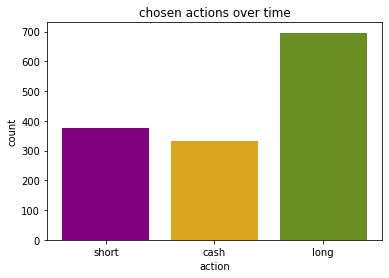

{'short': 375, 'cash': 333, 'long': 696}


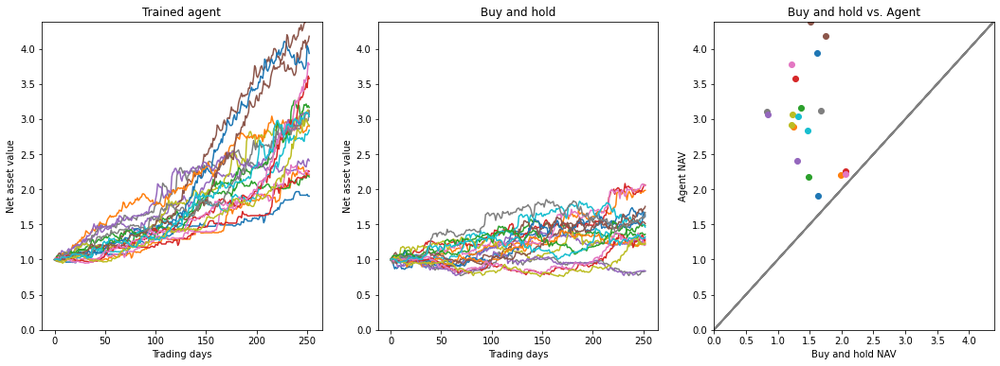

(             agent_avg  market_avg  agent_better
return        3.010427    1.453611           1.0
return_risk   1.123153    0.735080           1.0, array([1.90205661, 2.19996793, 2.17639008, 2.25520841, 2.40617443,
       4.17779676, 2.21488391, 3.10206855, 3.06691504, 2.84113901,
       3.93358134, 2.89637234, 3.16413171, 3.57634979, 3.06460617,
       4.38845764, 3.77655246, 3.11957226, 2.91291367, 3.03341187]), array([1.63774657, 1.9847183 , 1.48375079, 2.06002206, 1.29776023,
       1.75612941, 2.0551946 , 0.8364116 , 1.23004119, 1.46375701,
       1.61332331, 1.24796098, 1.35955041, 1.27595641, 0.83674819,
       1.51136814, 1.20831539, 1.67051682, 1.2200708 , 1.32287085]))


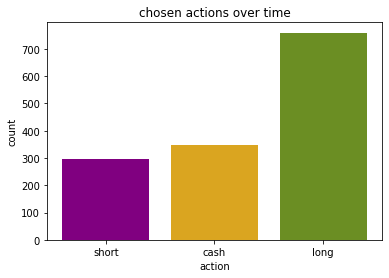

{'short': 297, 'cash': 348, 'long': 759}


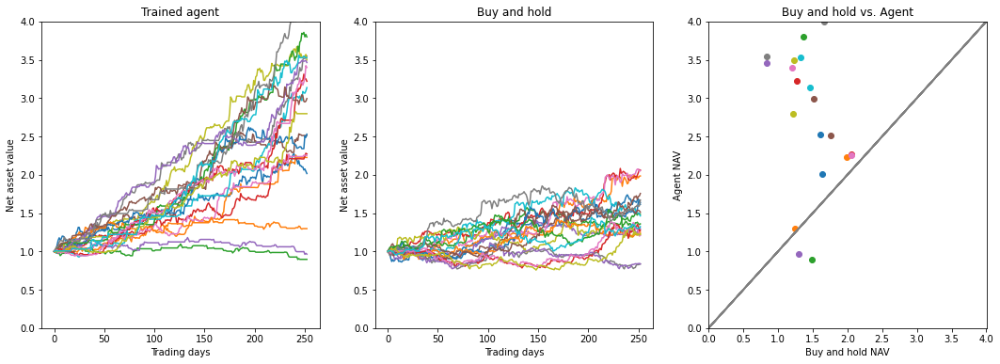

(             agent_avg  market_avg  agent_better
return        2.717693    1.453611           0.9
return_risk   1.074057    0.735080           1.0, array([2.0161096 , 2.22574828, 0.89657225, 2.27179182, 0.96434519,
       2.51197316, 2.25328546, 3.54978193, 3.49680237, 3.13703671,
       2.52965309, 1.29749665, 3.79868091, 3.21984638, 3.46382898,
       2.99423469, 3.40009213, 4.00229047, 2.7970945 , 3.52720057]), array([1.63774657, 1.9847183 , 1.48375079, 2.06002206, 1.29776023,
       1.75612941, 2.0551946 , 0.8364116 , 1.23004119, 1.46375701,
       1.61332331, 1.24796098, 1.35955041, 1.27595641, 0.83674819,
       1.51136814, 1.20831539, 1.67051682, 1.2200708 , 1.32287085]))


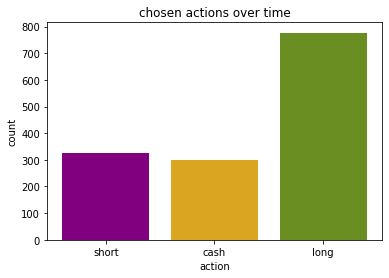

{'short': 327, 'cash': 300, 'long': 777}


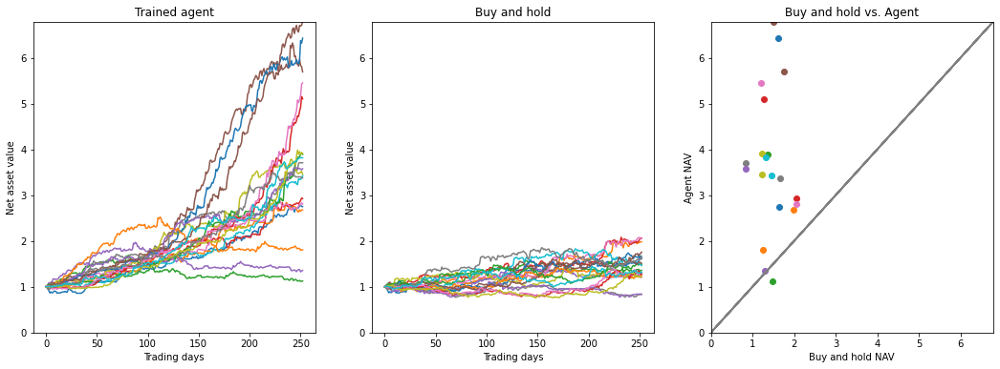

(             agent_avg  market_avg  agent_better
return        3.704127    1.453611          0.95
return_risk   0.984972    0.735080          1.00, array([2.75155465, 2.67726833, 1.12729476, 2.92584482, 1.35637063,
       5.69214147, 2.80893544, 3.70809162, 3.45265882, 3.42396671,
       6.42766892, 1.80793649, 3.8907565 , 5.10329071, 3.57802618,
       6.79064886, 5.45262882, 3.37749982, 3.91280346, 3.81715737]), array([1.63774657, 1.9847183 , 1.48375079, 2.06002206, 1.29776023,
       1.75612941, 2.0551946 , 0.8364116 , 1.23004119, 1.46375701,
       1.61332331, 1.24796098, 1.35955041, 1.27595641, 0.83674819,
       1.51136814, 1.20831539, 1.67051682, 1.2200708 , 1.32287085]))


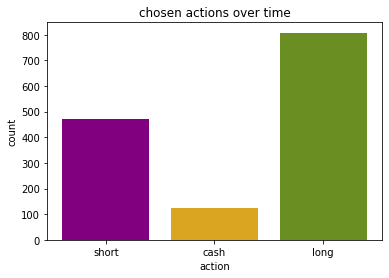

{'short': 470, 'cash': 126, 'long': 808}
**** 
Testing trained agent with time periods 2019-01-01 till 2022-06-01 
-****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.42% of the data
Time period used for training or testing starts at:2020-04-30 00:00:00 and ends at: 2022-05-31 00:00:00


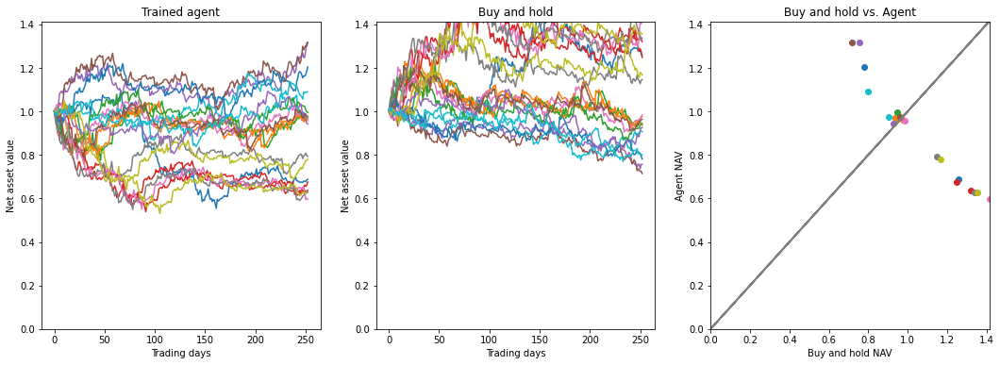

(             agent_avg  market_avg  agent_better
return        0.905077    1.043687           0.5
return_risk  -0.644504    0.531968           0.0, array([0.68784068, 0.96206624, 0.96940214, 0.67507778, 1.31580863,
       1.31701329, 0.95671176, 0.79351615, 0.77927804, 0.97541183,
       1.20409819, 0.97177025, 0.99509591, 0.6376527 , 0.94239728,
       0.97648908, 0.59572691, 0.62972719, 0.62602377, 1.09043184]), array([1.25761035, 0.97767667, 0.93830511, 1.24759164, 0.75685763,
       0.71468917, 0.98314849, 1.14628415, 1.16722779, 0.90599368,
       0.78115699, 0.93601855, 0.94522519, 1.32081522, 0.92542624,
       0.96323629, 1.41377095, 1.33743851, 1.3554664 , 0.79979247]))


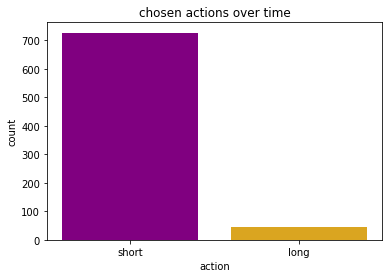

In [ ]:
for i in range (0,5):
    print('**** \nTraining agent 5 times with time periods '+ train_start_dates[i]+' till '+train_end_dates[i]+' \n****')
    env_train, model = train_agent(ticker_name = tickers[1] ,
                        ta_indicators_used = [],
                        start_date = train_start_dates[i],
                        end_date = train_end_dates[i])

    print('**** \nTesting trained agent with time periods '+ test_start_dates[i]+ ' till ' + test_end_dates[i]+' \n ****')
    env_test = TradingEnvironmentNew(ticker = tickers[1],
        use_variables = env_train.data_source.df.columns[1:].to_list(),
        scaler = env_train.data_source.scaler,
        start_date = test_start_dates[i],
        end_date = test_end_dates[i]
        )
    res_test = ai_trade_performance(env_test, model, seeds = seed )
    print(res_test)
    actions_test = analyze_actions_taken(env_test, model, plot_actions = True ,environment_new = True)

**** 
Training agent 5 times with time periods 2011-01-01 till 2015-01-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


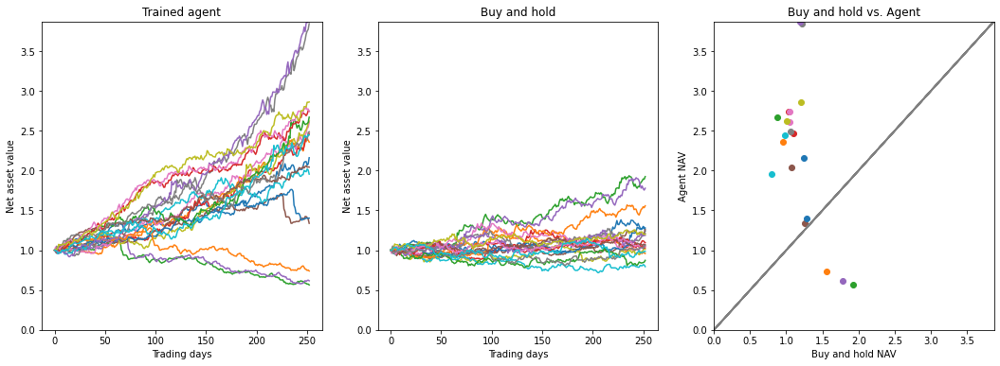

(             agent_avg  market_avg  agent_better
return        2.227507    1.180994          0.85
return_risk   0.964329    0.390001          1.00, array([2.16144834, 2.35861115, 0.56478562, 2.46604588, 0.61612474,
       1.33840518, 2.60594189, 3.84538701, 2.62136589, 1.95549305,
       1.40290755, 0.73970106, 2.67025762, 2.74586876, 3.87327246,
       2.04370439, 2.74385306, 2.48801122, 2.86148427, 2.44746997]), array([1.24011278, 0.95910621, 1.92424434, 1.09425246, 1.77822417,
       1.26058122, 1.05034159, 1.21434336, 1.01254861, 0.79448029,
       1.27965468, 1.55750083, 0.8728944 , 1.03059708, 1.18709365,
       1.06936243, 1.05263799, 1.05644045, 1.19949102, 0.98597823]))


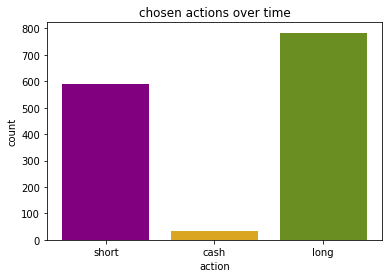

{'short': 588, 'cash': 32, 'long': 784}


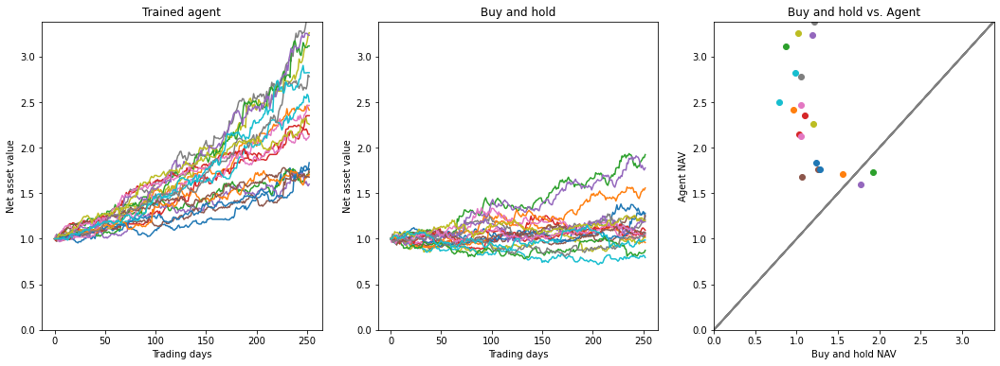

(             agent_avg  market_avg  agent_better
return        2.347670    1.180994           0.9
return_risk   1.216619    0.390001           1.0, array([1.83533412, 2.41388114, 1.73122386, 2.35168777, 1.59985093,
       1.76717619, 2.46427773, 3.38688546, 3.26196705, 2.50400598,
       1.76300022, 1.7062911 , 3.11758746, 2.14740524, 3.23466774,
       1.67790869, 2.12606928, 2.78161149, 2.25820054, 2.82436792]), array([1.24011278, 0.95910621, 1.92424434, 1.09425246, 1.77822417,
       1.26058122, 1.05034159, 1.21434336, 1.01254861, 0.79448029,
       1.27965468, 1.55750083, 0.8728944 , 1.03059708, 1.18709365,
       1.06936243, 1.05263799, 1.05644045, 1.19949102, 0.98597823]))


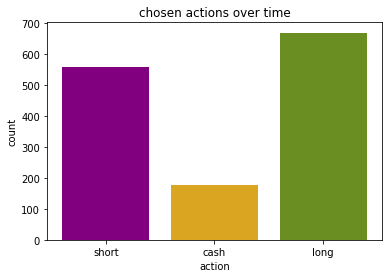

{'short': 558, 'cash': 177, 'long': 669}


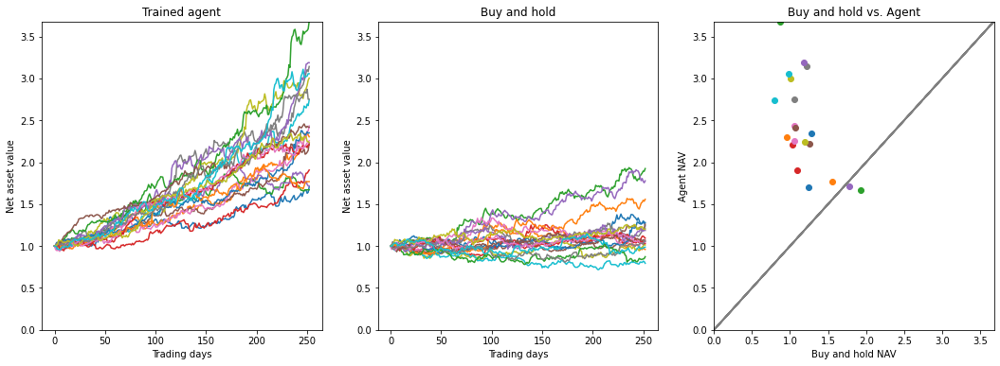

(             agent_avg  market_avg  agent_better
return        2.438006    1.180994           0.9
return_risk   1.266925    0.390001           1.0, array([1.7037061 , 2.30381285, 1.67114653, 1.90696662, 1.71727424,
       2.2230022 , 2.43303715, 3.14178113, 3.00368713, 2.74085546,
       2.35027225, 1.76854683, 3.68015088, 2.20894686, 3.18754319,
       2.4174011 , 2.25696518, 2.75132831, 2.23768848, 3.05601549]), array([1.24011278, 0.95910621, 1.92424434, 1.09425246, 1.77822417,
       1.26058122, 1.05034159, 1.21434336, 1.01254861, 0.79448029,
       1.27965468, 1.55750083, 0.8728944 , 1.03059708, 1.18709365,
       1.06936243, 1.05263799, 1.05644045, 1.19949102, 0.98597823]))


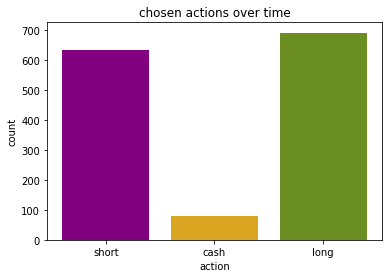

{'short': 633, 'cash': 79, 'long': 692}


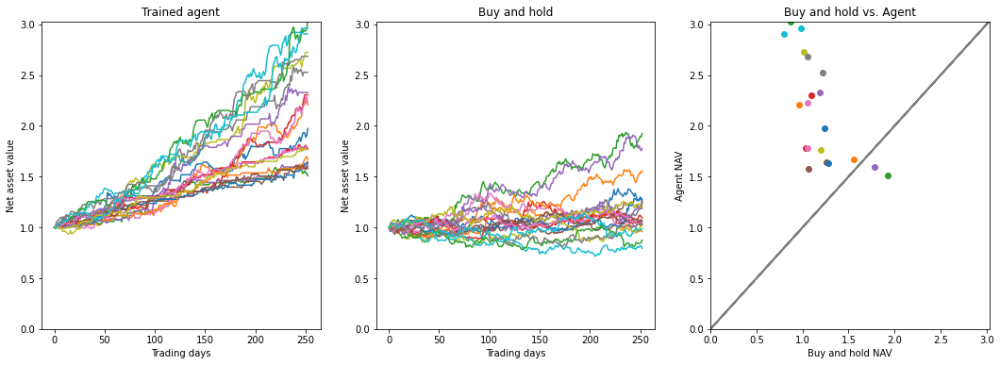

(             agent_avg  market_avg  agent_better
return        2.141412    1.180994           0.9
return_risk   1.206403    0.390001           1.0, array([1.97314394, 2.2057719 , 1.50812814, 2.30488178, 1.59705618,
       1.6460078 , 2.22537195, 2.52735903, 2.72374669, 2.90588186,
       1.63256743, 1.67131299, 3.02874034, 1.77812948, 2.32901127,
       1.58053712, 1.77935716, 2.68454048, 1.76650992, 2.96017884]), array([1.24011278, 0.95910621, 1.92424434, 1.09425246, 1.77822417,
       1.26058122, 1.05034159, 1.21434336, 1.01254861, 0.79448029,
       1.27965468, 1.55750083, 0.8728944 , 1.03059708, 1.18709365,
       1.06936243, 1.05263799, 1.05644045, 1.19949102, 0.98597823]))


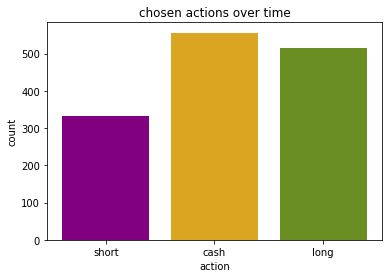

{'short': 332, 'cash': 556, 'long': 516}


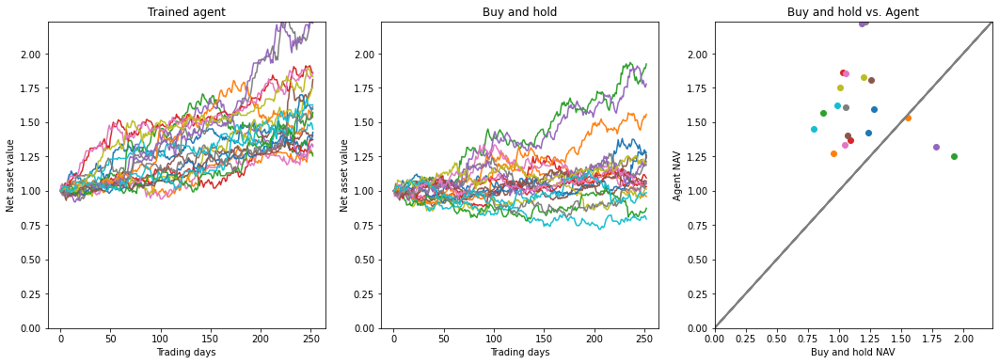

(             agent_avg  market_avg  agent_better
return        1.617062    1.180994          0.85
return_risk   1.184289    0.390001          1.00, array([1.42625307, 1.2703768 , 1.25515742, 1.37229467, 1.32303392,
       1.8112455 , 1.33538594, 2.2353307 , 1.74997069, 1.45010564,
       1.59645369, 1.5368595 , 1.57097291, 1.86174107, 2.22133127,
       1.40038179, 1.85478927, 1.61189545, 1.83166501, 1.62599613]), array([1.24011278, 0.95910621, 1.92424434, 1.09425246, 1.77822417,
       1.26058122, 1.05034159, 1.21434336, 1.01254861, 0.79448029,
       1.27965468, 1.55750083, 0.8728944 , 1.03059708, 1.18709365,
       1.06936243, 1.05263799, 1.05644045, 1.19949102, 0.98597823]))


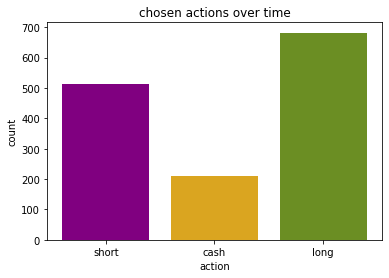

{'short': 512, 'cash': 210, 'long': 682}
**** 
Testing trained agent with time periods 2017-01-01 till 2020-01-01 
 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 9.63% of the data
Time period used for training or testing starts at:2018-04-23 00:00:00 and ends at: 2019-12-31 00:00:00


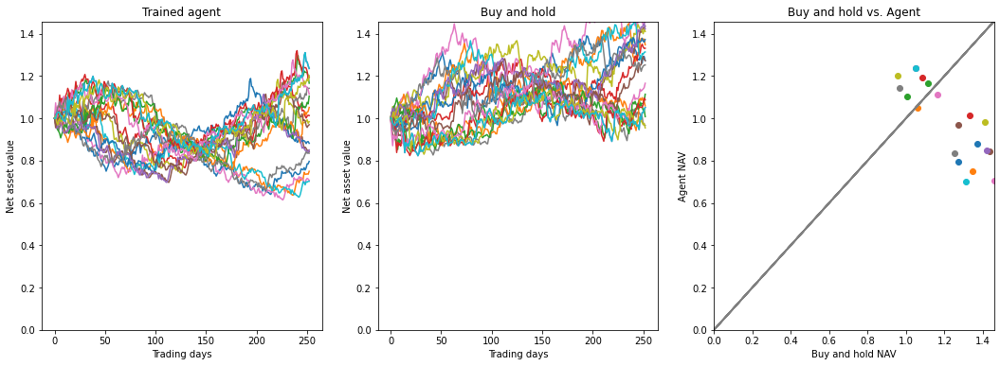

(             agent_avg  market_avg  agent_better
return        0.988682    1.216985          0.35
return_risk  -0.503073    0.720345          0.00, array([0.79633997, 0.74938976, 1.16585925, 1.0128981 , 1.23528399,
       0.84230564, 0.70664731, 1.1415591 , 0.98395842, 0.70233665,
       0.8816087 , 1.051164  , 1.10425603, 1.19446147, 0.85044409,
       0.96940744, 1.11410867, 0.8347761 , 1.20155682, 1.23528399]), array([1.2718959 , 1.34708867, 1.11351903, 1.33090195, 1.05093765,
       1.43575725, 1.45767788, 0.96635467, 1.41007468, 1.31330156,
       1.37174966, 1.05865087, 1.0077515 , 1.08685503, 1.42201756,
       1.27244677, 1.16524221, 1.25191927, 0.95461114, 1.05093765]))


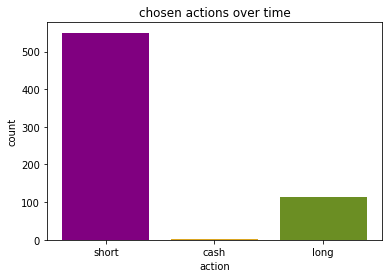

**** 
Training agent 5 times with time periods 2011-06-01 till 2016-01-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


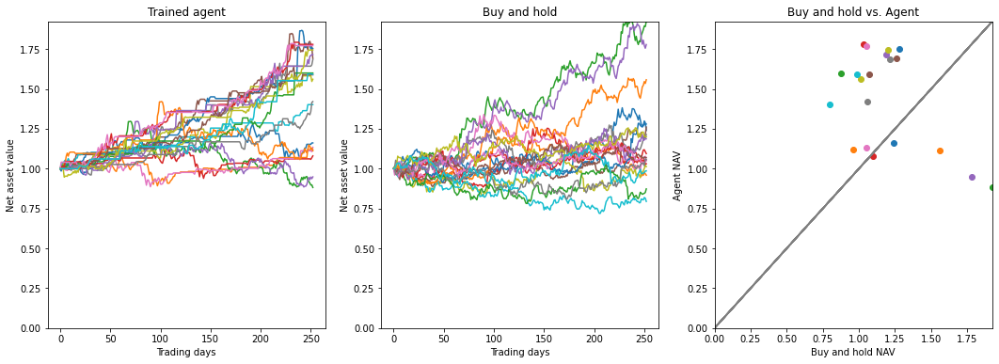

(             agent_avg  market_avg  agent_better
return        1.436864    1.180994          0.75
return_risk   1.019663    0.390001          1.00, array([1.16122988, 1.11906443, 0.88177089, 1.07982186, 0.94835097,
       1.6912362 , 1.13419342, 1.68374218, 1.56049019, 1.40154717,
       1.75314578, 1.11198745, 1.59963808, 1.77939799, 1.71530387,
       1.58881638, 1.77144042, 1.42074217, 1.74413302, 1.59121789]), array([1.24011259, 0.9591062 , 1.92424447, 1.09425224, 1.77822406,
       1.26058105, 1.05034151, 1.21434319, 1.01254854, 0.79448038,
       1.27965476, 1.55750053, 0.87289434, 1.03059708, 1.1870934 ,
       1.06936243, 1.05263792, 1.05644038, 1.19949086, 0.98597823]))


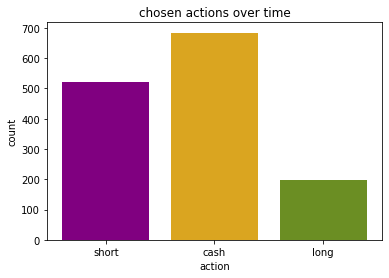

{'short': 521, 'cash': 684, 'long': 199}


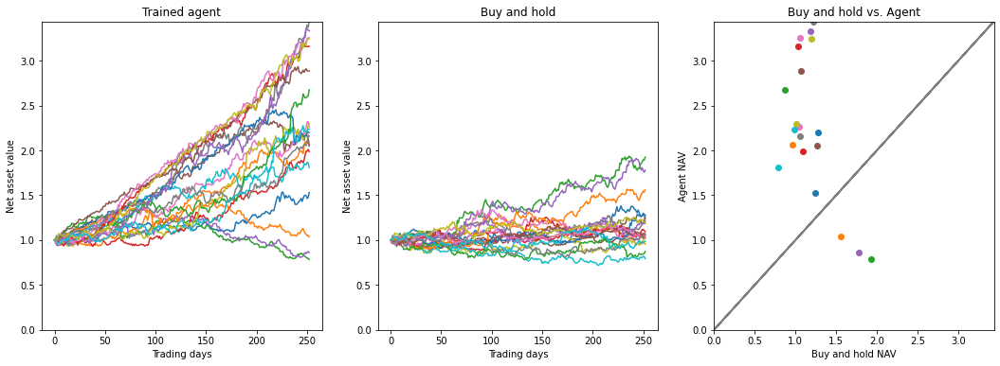

(             agent_avg  market_avg  agent_better
return        2.262283    1.180994          0.85
return_risk   1.010524    0.390001          1.00, array([1.52986254, 2.06274099, 0.78384836, 1.9862967 , 0.86014361,
       2.0485365 , 2.25895994, 3.43625352, 2.29640233, 1.80995232,
       2.19720171, 1.03770888, 2.6747068 , 3.15751432, 3.33209699,
       2.88479746, 3.25398642, 2.15763325, 3.24082205, 2.23618646]), array([1.24011259, 0.9591062 , 1.92424447, 1.09425224, 1.77822406,
       1.26058105, 1.05034151, 1.21434319, 1.01254854, 0.79448038,
       1.27965476, 1.55750053, 0.87289434, 1.03059708, 1.1870934 ,
       1.06936243, 1.05263792, 1.05644038, 1.19949086, 0.98597823]))


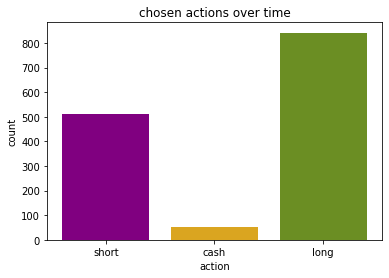

{'short': 511, 'cash': 51, 'long': 842}


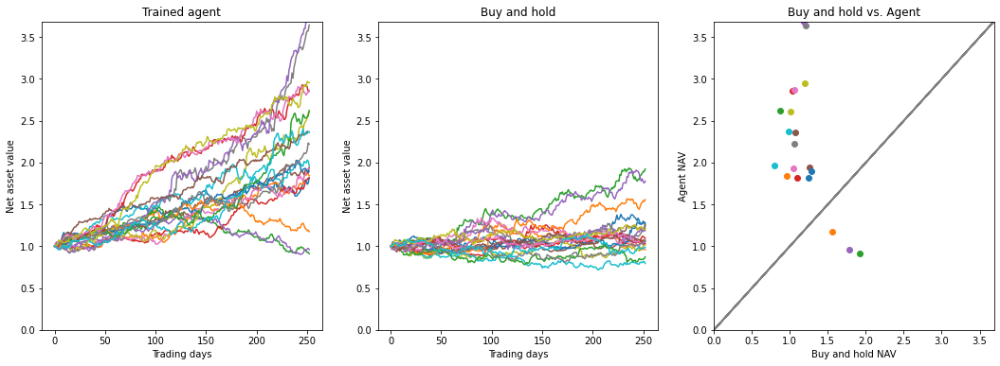

(             agent_avg  market_avg  agent_better
return        2.222134    1.180994          0.85
return_risk   1.101466    0.390001          1.00, array([1.81956902, 1.84347232, 0.91113603, 1.81359702, 0.96040852,
       1.94452166, 1.92587936, 3.64356518, 2.61024561, 1.96650619,
       1.89472208, 1.17461155, 2.62158855, 2.85424233, 3.68797209,
       2.36270681, 2.86449352, 2.22120093, 2.95436768, 2.36788227]), array([1.24011259, 0.9591062 , 1.92424447, 1.09425224, 1.77822406,
       1.26058105, 1.05034151, 1.21434319, 1.01254854, 0.79448038,
       1.27965476, 1.55750053, 0.87289434, 1.03059708, 1.1870934 ,
       1.06936243, 1.05263792, 1.05644038, 1.19949086, 0.98597823]))


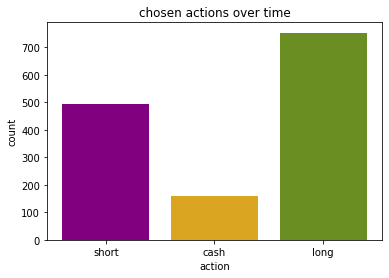

{'short': 493, 'cash': 158, 'long': 753}


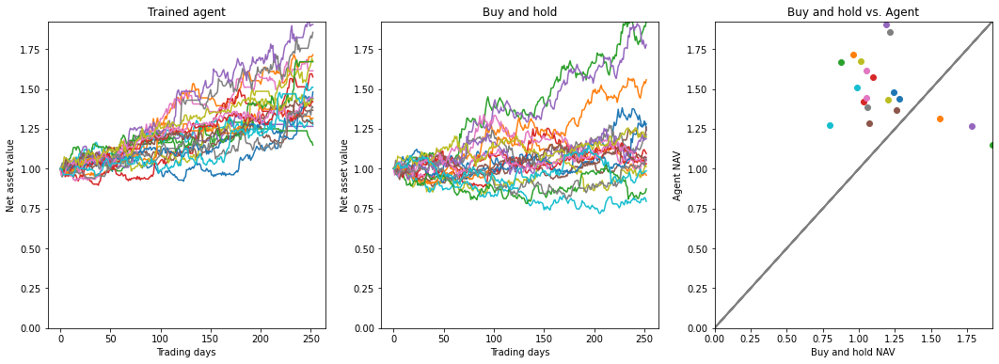

(             agent_avg  market_avg  agent_better
return        1.488792    1.180994          0.85
return_risk   1.154135    0.390001          1.00, array([1.48049974, 1.71454818, 1.14781998, 1.57549853, 1.26508177,
       1.36637325, 1.61337258, 1.85493887, 1.6734231 , 1.2754383 ,
       1.43955176, 1.31569034, 1.67081377, 1.41933128, 1.90463241,
       1.28536   , 1.44529952, 1.38347242, 1.43403508, 1.51066518]), array([1.24011259, 0.9591062 , 1.92424447, 1.09425224, 1.77822406,
       1.26058105, 1.05034151, 1.21434319, 1.01254854, 0.79448038,
       1.27965476, 1.55750053, 0.87289434, 1.03059708, 1.1870934 ,
       1.06936243, 1.05263792, 1.05644038, 1.19949086, 0.98597823]))


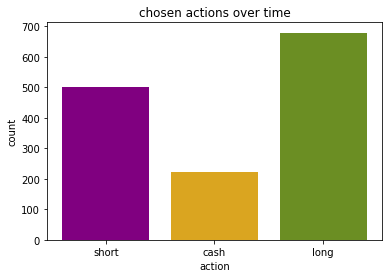

{'short': 502, 'cash': 223, 'long': 679}


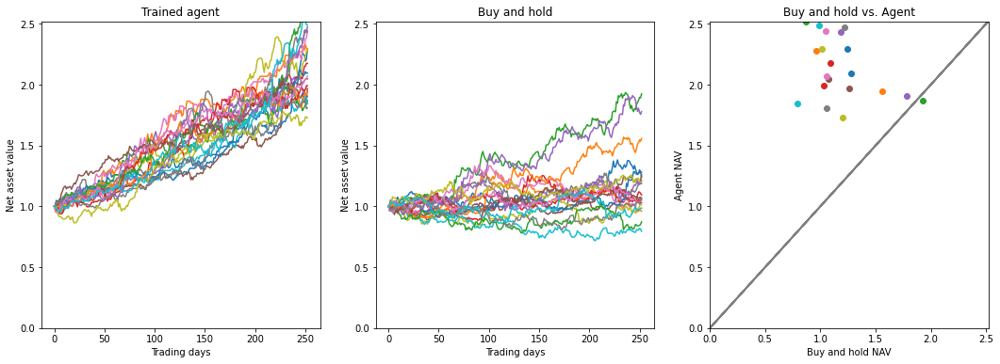

(             agent_avg  market_avg  agent_better
return        2.133432    1.180994          0.95
return_risk   1.436300    0.390001          1.00, array([2.29264528, 2.2785372 , 1.86991518, 2.17477489, 1.90513025,
       1.96786043, 2.4420857 , 2.47367731, 2.29562819, 1.84247338,
       2.09590643, 1.9425852 , 2.52051305, 1.99144101, 2.43417583,
       2.04614904, 2.07080931, 1.80908039, 1.72697287, 2.48828422]), array([1.24011259, 0.9591062 , 1.92424447, 1.09425224, 1.77822406,
       1.26058105, 1.05034151, 1.21434319, 1.01254854, 0.79448038,
       1.27965476, 1.55750053, 0.87289434, 1.03059708, 1.1870934 ,
       1.06936243, 1.05263792, 1.05644038, 1.19949086, 0.98597823]))


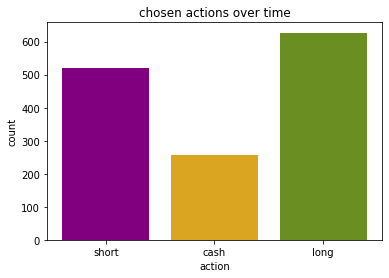

{'short': 521, 'cash': 256, 'long': 627}
**** 
Testing trained agent with time periods 2017-06-01 till 2021-01-01 
 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.01% of the data
Time period used for training or testing starts at:2018-09-18 00:00:00 and ends at: 2020-12-31 00:00:00


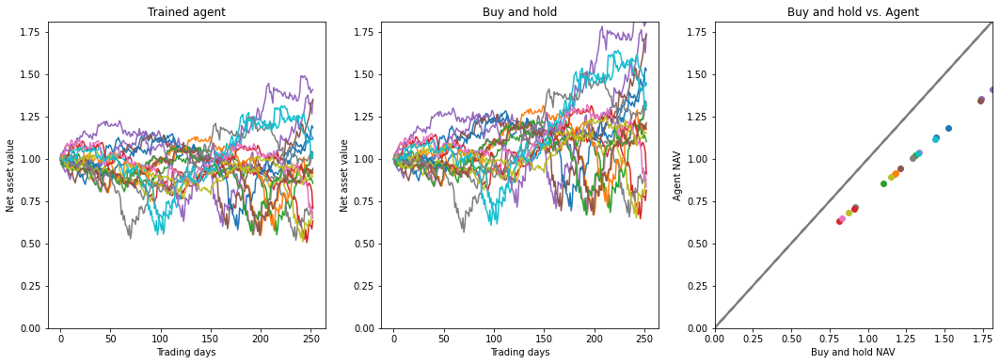

(             agent_avg  market_avg  agent_better
return        0.976406    1.256240           0.0
return_risk  -0.300417    0.516131           0.0, array([1.12489813, 0.91233655, 0.85540953, 0.63234186, 1.35263478,
       1.34537058, 1.03648025, 0.71426957, 0.68145804, 1.11544945,
       1.18366533, 0.9167093 , 1.01919194, 0.70661595, 1.40851054,
       0.94237149, 0.6474607 , 1.00375369, 0.89497623, 1.03422104]), array([1.44728948, 1.17380859, 1.10056651, 0.81356853, 1.74029455,
       1.73094846, 1.33353138, 0.9189764 , 0.87676121, 1.43513284,
       1.52289913, 1.17943455, 1.31128831, 0.90912928, 1.81218408,
       1.21245143, 0.83302037, 1.29142552, 1.15147288, 1.33062469]))


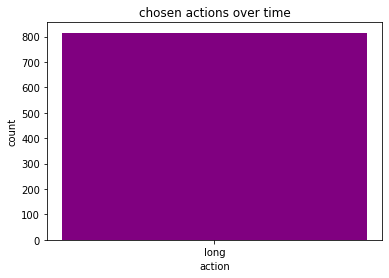

**** 
Training agent 5 times with time periods 2012-01-01 till 2017-01-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


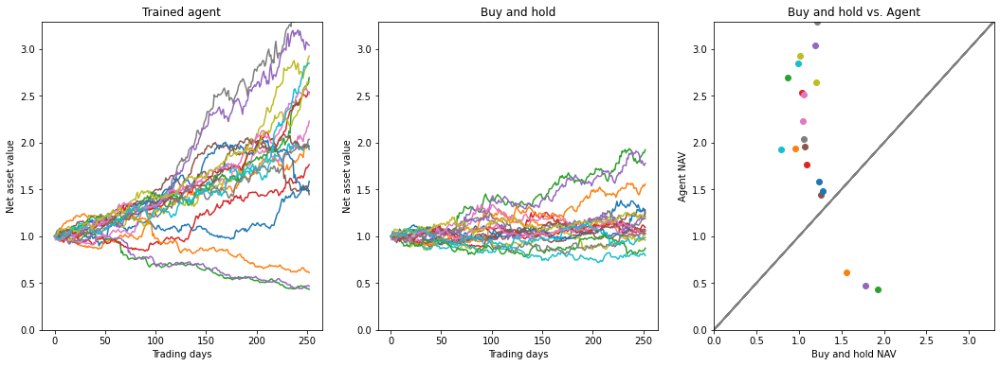

(             agent_avg  market_avg  agent_better
return        2.018620    1.180994          0.85
return_risk   0.778909    0.390001          1.00, array([1.5863279 , 1.93309229, 0.43231908, 1.76343591, 0.46781921,
       1.44499555, 2.22860298, 3.29386123, 2.92456676, 1.92636885,
       1.48464014, 0.61196034, 2.69324264, 2.53711976, 3.03945649,
       1.96175521, 2.51484201, 2.0357935 , 2.64394579, 2.8482588 ]), array([1.24011267, 0.95910628, 1.92424435, 1.09425231, 1.77822441,
       1.26058125, 1.0503416 , 1.21434336, 1.0125484 , 0.79448038,
       1.27965468, 1.55750053, 0.87289435, 1.03059714, 1.18709348,
       1.06936243, 1.05263799, 1.05644038, 1.19949095, 0.98597809]))


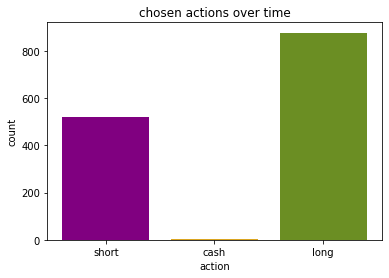

{'short': 521, 'cash': 5, 'long': 878}


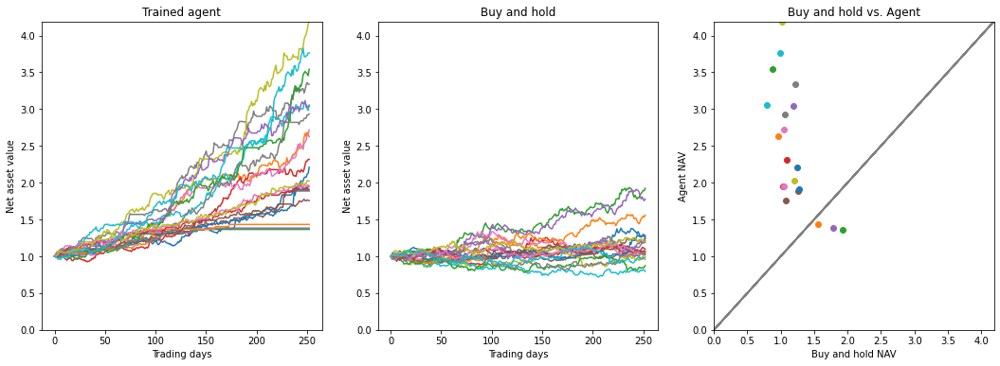

(             agent_avg  market_avg  agent_better
return        2.469238    1.180994          0.85
return_risk   1.067144    0.390001          1.00, array([2.20898844, 2.62597683, 1.36553686, 2.31680273, 1.38310928,
       1.88805137, 2.71762952, 3.33706585, 4.1911372 , 3.05547298,
       1.9090964 , 1.43236656, 3.54102092, 1.94663536, 3.04046845,
       1.75706552, 1.94910739, 2.93253453, 2.02475115, 3.76194473]), array([1.24011267, 0.95910628, 1.92424435, 1.09425231, 1.77822441,
       1.26058125, 1.0503416 , 1.21434336, 1.0125484 , 0.79448038,
       1.27965468, 1.55750053, 0.87289435, 1.03059714, 1.18709348,
       1.06936243, 1.05263799, 1.05644038, 1.19949095, 0.98597809]))


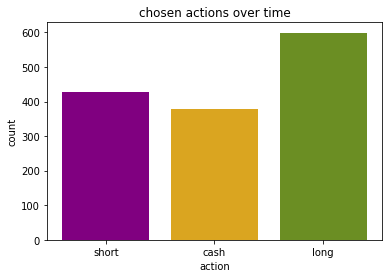

{'short': 428, 'cash': 377, 'long': 599}


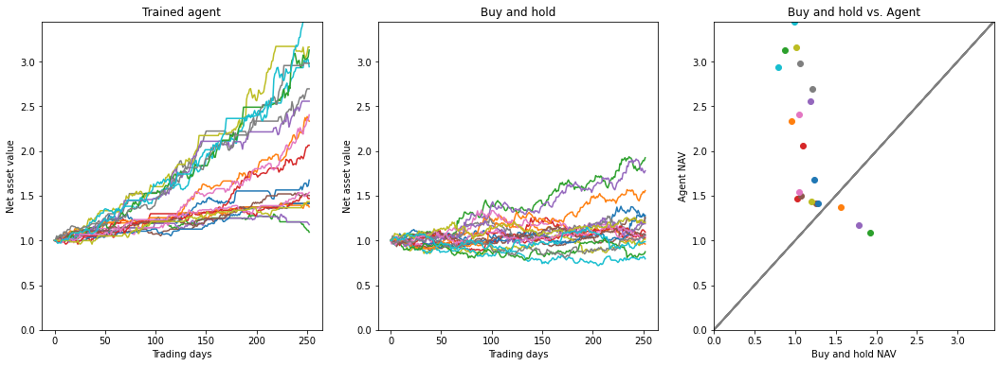

(             agent_avg  market_avg  agent_better
return        2.090293    1.180994          0.85
return_risk   0.977720    0.390001          1.00, array([1.67464736, 2.33288597, 1.09191791, 2.06385697, 1.1763146 ,
       1.417402  , 2.40383368, 2.69508415, 3.16288438, 2.94194217,
       1.41275292, 1.37478789, 3.12843176, 1.4684955 , 2.55655166,
       1.5020741 , 1.53682984, 2.98048487, 1.43603809, 3.4486454 ]), array([1.24011267, 0.95910628, 1.92424435, 1.09425231, 1.77822441,
       1.26058125, 1.0503416 , 1.21434336, 1.0125484 , 0.79448038,
       1.27965468, 1.55750053, 0.87289435, 1.03059714, 1.18709348,
       1.06936243, 1.05263799, 1.05644038, 1.19949095, 0.98597809]))


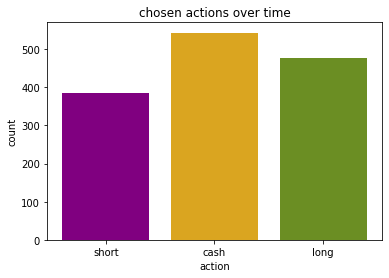

{'short': 385, 'cash': 543, 'long': 476}


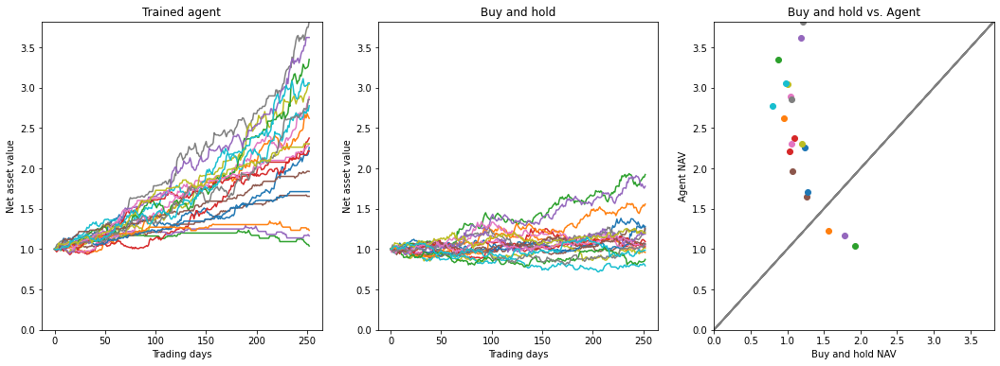

(             agent_avg  market_avg  agent_better
return        2.412725    1.180994          0.85
return_risk   1.127696    0.390001          1.00, array([2.25987195, 2.62052759, 1.03892641, 2.37600566, 1.16391895,
       1.65437912, 2.88632313, 3.8209141 , 3.04349957, 2.77665623,
       1.71262016, 1.23256027, 3.35062247, 2.21424227, 3.62165497,
       1.96242076, 2.30249025, 2.85311893, 2.30462762, 3.05911771]), array([1.24011267, 0.95910628, 1.92424435, 1.09425231, 1.77822441,
       1.26058125, 1.0503416 , 1.21434336, 1.0125484 , 0.79448038,
       1.27965468, 1.55750053, 0.87289435, 1.03059714, 1.18709348,
       1.06936243, 1.05263799, 1.05644038, 1.19949095, 0.98597809]))


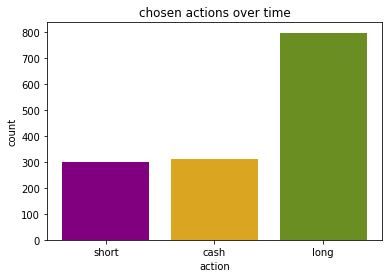

{'short': 299, 'cash': 309, 'long': 796}


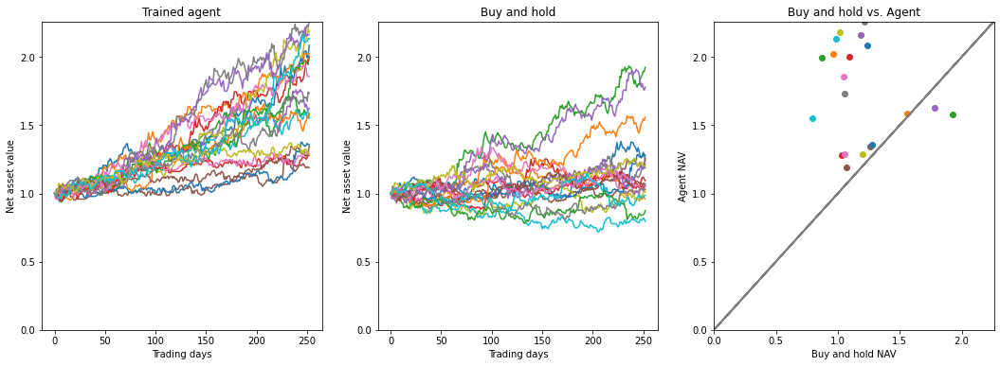

(             agent_avg  market_avg  agent_better
return        1.726591    1.180994           0.9
return_risk   1.107027    0.390001           1.0, array([2.08611857, 2.02200972, 1.5798154 , 2.00394428, 1.62464846,
       1.34650165, 1.85632881, 2.26066893, 2.18265638, 1.55070361,
       1.3596697 , 1.5870839 , 1.99307189, 1.28075498, 2.16434793,
       1.18887117, 1.28993936, 1.73389052, 1.28613416, 2.13466076]), array([1.24011267, 0.95910628, 1.92424435, 1.09425231, 1.77822441,
       1.26058125, 1.0503416 , 1.21434336, 1.0125484 , 0.79448038,
       1.27965468, 1.55750053, 0.87289435, 1.03059714, 1.18709348,
       1.06936243, 1.05263799, 1.05644038, 1.19949095, 0.98597809]))


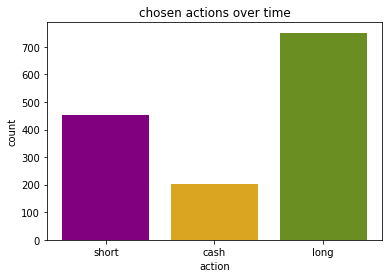

{'short': 451, 'cash': 202, 'long': 751}
**** 
Testing trained agent with time periods 2018-01-01 till 2021-06-01 
 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.45% of the data
Time period used for training or testing starts at:2019-04-26 00:00:00 and ends at: 2021-05-31 00:00:00


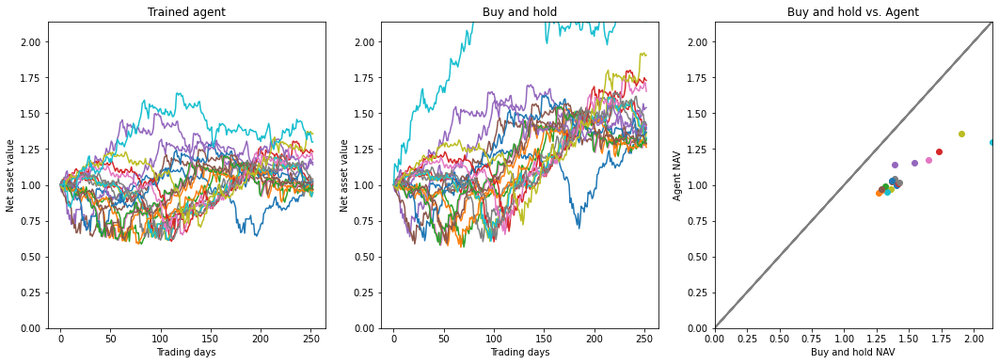

(             agent_avg  market_avg  agent_better
return        1.060162    1.457276           0.0
return_risk   0.085935    0.748286           0.0, array([0.99862918, 0.94774323, 0.9699575 , 1.01090035, 1.15617894,
       1.02402535, 0.96409024, 1.04175922, 0.96814556, 0.94793331,
       1.02776062, 0.96458809, 0.99082452, 1.2324873 , 1.13993657,
       0.96867425, 1.17755626, 1.01450939, 1.35800444, 1.29953096]), array([1.40178705, 1.26184889, 1.29142552, 1.41901223, 1.53936538,
       1.3634128 , 1.28361371, 1.38702412, 1.35899685, 1.33062469,
       1.36838603, 1.28427656, 1.31920838, 1.73005634, 1.39111093,
       1.28971698, 1.65294902, 1.42407828, 1.90624616, 2.14237622]))


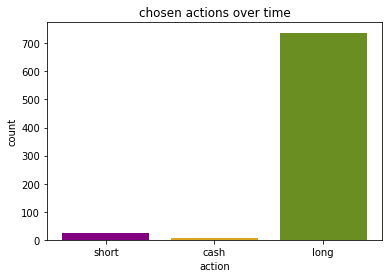

**** 
Training agent 5 times with time periods 2012-06-01 till 2017-01-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


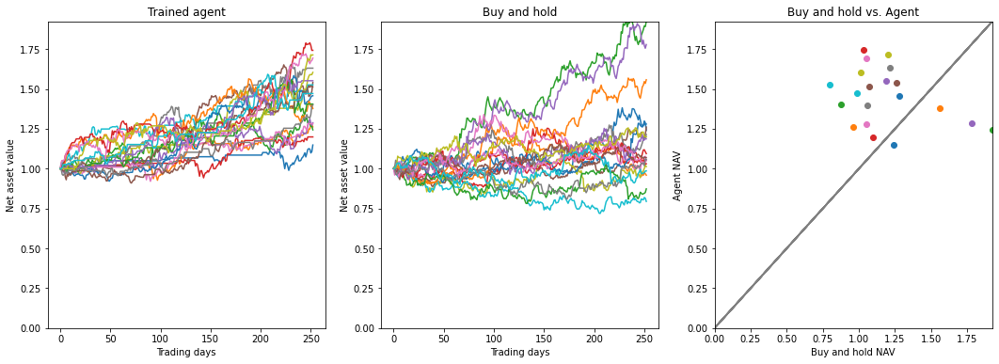

(             agent_avg  market_avg  agent_better
return        1.452246    1.180994           0.8
return_risk   1.164258    0.390001           1.0, array([1.14822585, 1.26220922, 1.24335442, 1.19899533, 1.28755555,
       1.54097563, 1.28192333, 1.63027061, 1.60376985, 1.52518588,
       1.45740429, 1.37678257, 1.4050198 , 1.74230046, 1.55147723,
       1.51248705, 1.69323784, 1.39893496, 1.71349778, 1.47130891]), array([1.24011269, 0.9591062 , 1.92424459, 1.09425224, 1.77822417,
       1.26058098, 1.05034151, 1.21434327, 1.01254847, 0.79448035,
       1.27965481, 1.55750083, 0.8728944 , 1.03059715, 1.18709365,
       1.0693625 , 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


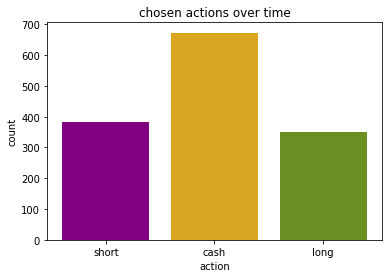

{'short': 382, 'cash': 673, 'long': 349}


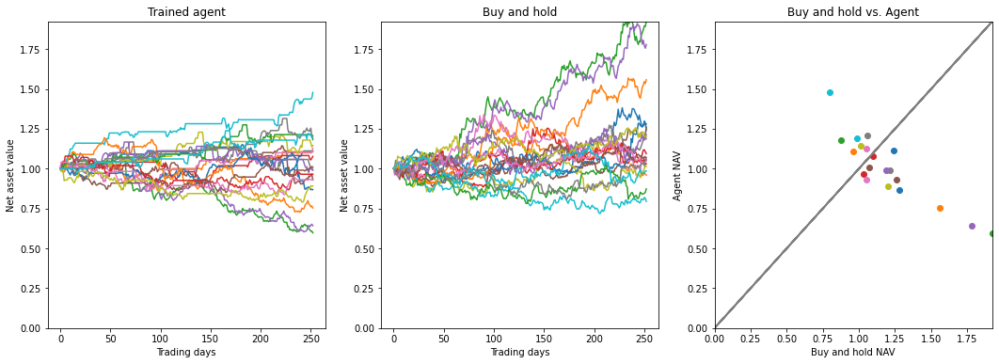

(             agent_avg  market_avg  agent_better
return        1.009738    1.180994          0.35
return_risk   0.148412    0.390001          0.00, array([1.11094589, 1.10605488, 0.59710938, 1.07640655, 0.64219546,
       0.92885957, 1.12672719, 0.99059139, 1.1454372 , 1.47804062,
       0.86822636, 0.75337385, 1.18156651, 0.9649451 , 0.99192887,
       1.01030549, 0.93117095, 1.20637848, 0.89108823, 1.19341247]), array([1.24011269, 0.9591062 , 1.92424459, 1.09425224, 1.77822417,
       1.26058098, 1.05034151, 1.21434327, 1.01254847, 0.79448035,
       1.27965481, 1.55750083, 0.8728944 , 1.03059715, 1.18709365,
       1.0693625 , 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


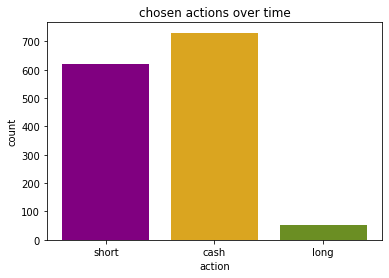

{'short': 620, 'cash': 731, 'long': 53}


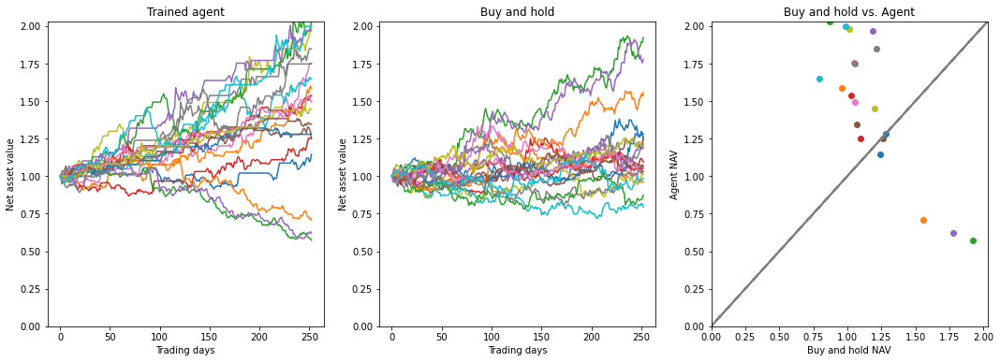

(             agent_avg  market_avg  agent_better
return        1.460876    1.180994          0.75
return_risk   0.778622    0.390001          1.00, array([1.14560927, 1.58503275, 0.57395327, 1.25273706, 0.62108394,
       1.24821196, 1.75333221, 1.84856143, 1.98072615, 1.64879215,
       1.2803361 , 0.70910169, 2.03241567, 1.53533842, 1.96831509,
       1.34690539, 1.49408083, 1.74736071, 1.44793582, 1.9976925 ]), array([1.24011269, 0.9591062 , 1.92424459, 1.09425224, 1.77822417,
       1.26058098, 1.05034151, 1.21434327, 1.01254847, 0.79448035,
       1.27965481, 1.55750083, 0.8728944 , 1.03059715, 1.18709365,
       1.0693625 , 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


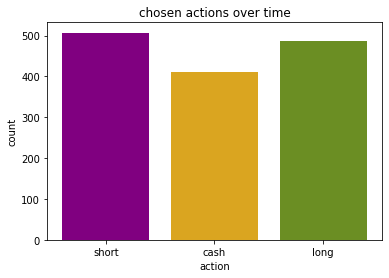

{'short': 507, 'cash': 410, 'long': 487}


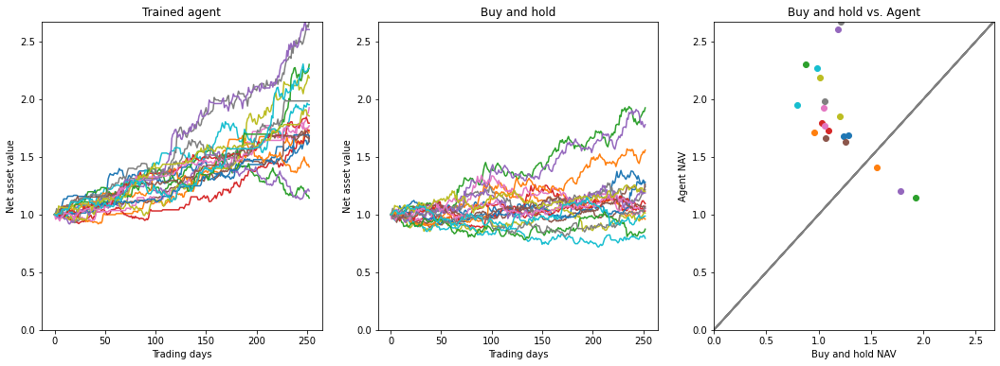

(             agent_avg  market_avg  agent_better
return        1.857520    1.180994          0.85
return_risk   1.217509    0.390001          1.00, array([1.67731818, 1.71198605, 1.14182252, 1.72932361, 1.20357009,
       1.63030277, 1.92530573, 2.67326865, 2.18425307, 1.95199964,
       1.68425523, 1.41174856, 2.30020153, 1.79153713, 2.60242798,
       1.65988899, 1.76841917, 1.98393501, 1.85390314, 2.26493739]), array([1.24011269, 0.9591062 , 1.92424459, 1.09425224, 1.77822417,
       1.26058098, 1.05034151, 1.21434327, 1.01254847, 0.79448035,
       1.27965481, 1.55750083, 0.8728944 , 1.03059715, 1.18709365,
       1.0693625 , 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


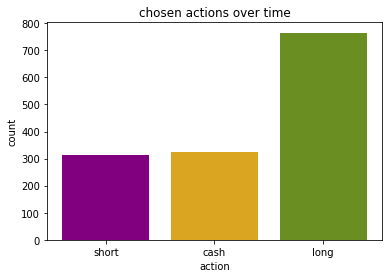

{'short': 313, 'cash': 326, 'long': 765}


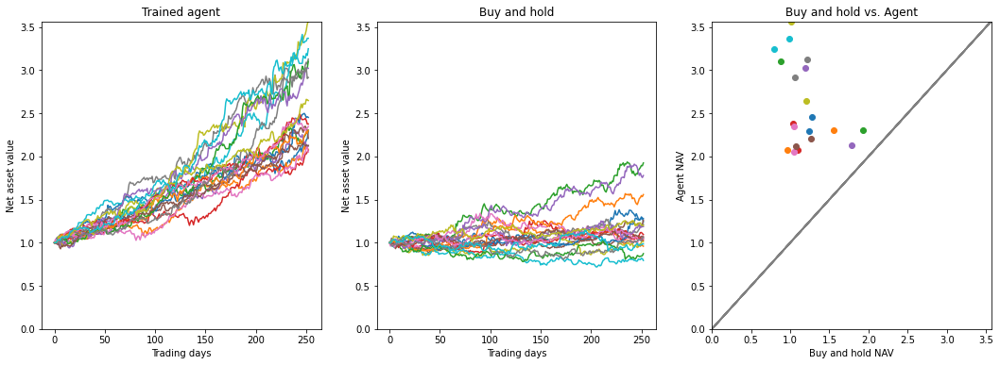

(             agent_avg  market_avg  agent_better
return        2.586475    1.180994           1.0
return_risk   1.308163    0.390001           1.0, array([2.29092978, 2.07880892, 2.30405947, 2.07106139, 2.12921697,
       2.2095802 , 2.05144907, 3.1282709 , 3.56543553, 3.24749918,
       2.45220149, 2.30111031, 3.10102532, 2.37577937, 3.02147537,
       2.12279735, 2.34746228, 2.91458468, 2.64776246, 3.36899645]), array([1.24011269, 0.9591062 , 1.92424459, 1.09425224, 1.77822417,
       1.26058098, 1.05034151, 1.21434327, 1.01254847, 0.79448035,
       1.27965481, 1.55750083, 0.8728944 , 1.03059715, 1.18709365,
       1.0693625 , 1.05263792, 1.05644044, 1.19949093, 0.98597816]))


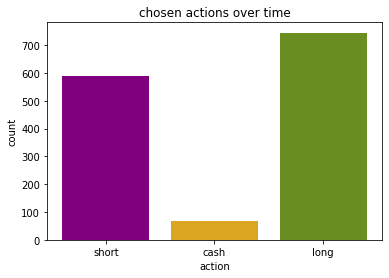

{'short': 591, 'cash': 68, 'long': 745}
**** 
Testing trained agent with time periods 2018-06-01 till 2022-01-01 
 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.02% of the data
Time period used for training or testing starts at:2019-09-27 00:00:00 and ends at: 2021-12-31 00:00:00


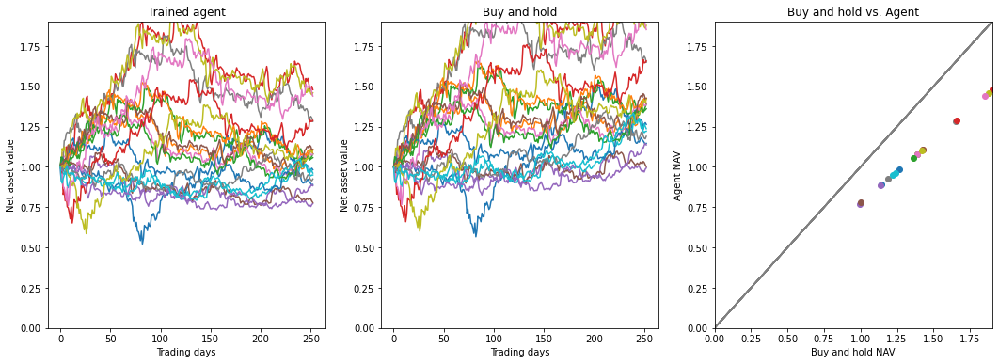

(             agent_avg  market_avg  agent_better
return        1.085502    1.396603           0.0
return_risk   0.486104    0.902678           0.0, array([0.98236122, 1.0811437 , 1.08006921, 1.47960793, 0.77194329,
       0.77868403, 1.0783768 , 1.28222206, 1.45991128, 0.9616961 ,
       0.89081365, 1.10889051, 1.05745201, 1.28806398, 0.88357481,
       1.10795702, 1.43980019, 0.92475347, 1.10316019, 0.94956596]), array([1.26390205, 1.39099519, 1.38961276, 1.9036577 , 0.99317918,
       1.00185179, 1.38743532, 1.64970183, 1.87831607, 1.2373144 ,
       1.14611732, 1.42669414, 1.36051357, 1.65721801, 1.13680384,
       1.42549311, 1.85244122, 1.18978415, 1.41932152, 1.2217078 ]))


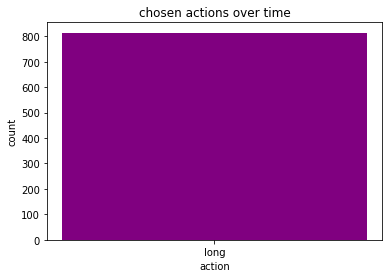

**** 
Training agent 5 times with time periods 2013-01-01 till 2017-06-01 
****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


73 observations have been deleted due to missing data
This equals 4.94% of the data
Time period used for training or testing starts at:2013-04-25 00:00:00 and ends at: 2017-12-29 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


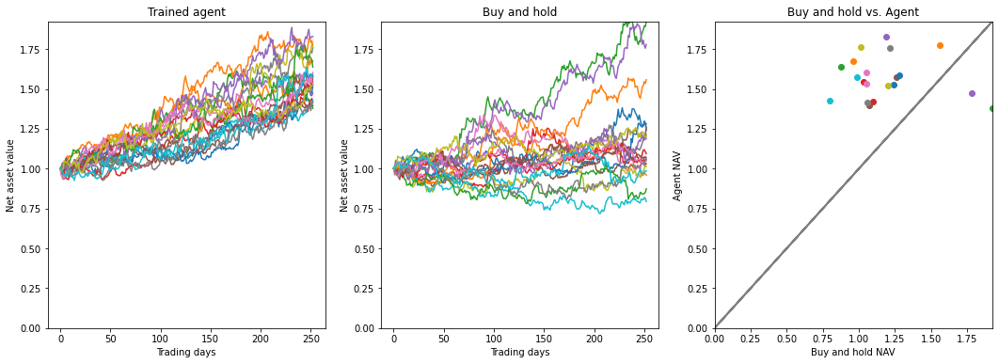

(             agent_avg  market_avg  agent_better
return        1.570334    1.180994           0.9
return_risk   1.297290    0.390001           1.0, array([1.524768  , 1.67538532, 1.37797342, 1.42328195, 1.47487984,
       1.57554067, 1.6033186 , 1.75890871, 1.76140571, 1.4278876 ,
       1.58573039, 1.77429002, 1.63707745, 1.54371163, 1.828784  ,
       1.39527083, 1.53015693, 1.41234722, 1.52182053, 1.57414944]), array([1.24011259, 0.95910621, 1.92424447, 1.09425247, 1.77822417,
       1.2605809 , 1.0503416 , 1.21434336, 1.01254861, 0.79448038,
       1.27965468, 1.55750053, 0.8728944 , 1.03059714, 1.1870934 ,
       1.06936243, 1.05263799, 1.05644038, 1.19949078, 0.98597823]))


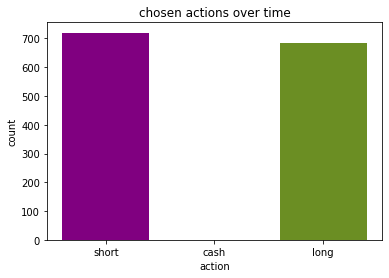

{'short': 720, 'cash': 1, 'long': 683}


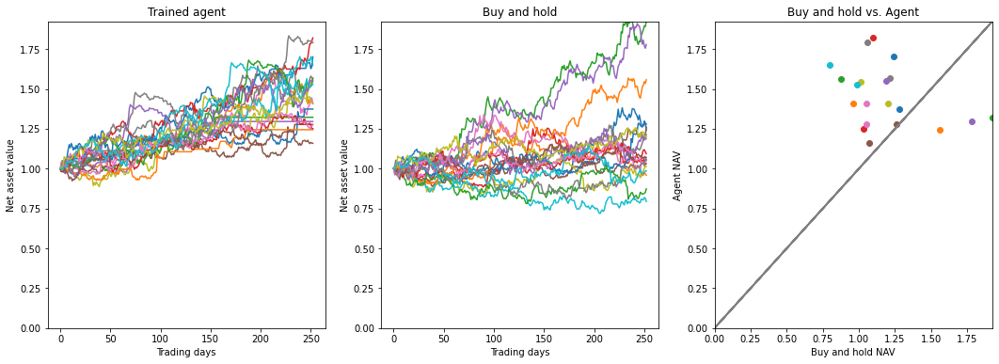

(             agent_avg  market_avg  agent_better
return        1.457079    1.180994          0.85
return_risk   1.332030    0.390001          1.00, array([1.70096692, 1.40825368, 1.32207123, 1.82014341, 1.29572945,
       1.27710959, 1.4066496 , 1.56882536, 1.54570651, 1.6488417 ,
       1.37368479, 1.24434029, 1.56499728, 1.25099208, 1.55065391,
       1.15895779, 1.27666802, 1.78975584, 1.40996424, 1.52727101]), array([1.24011259, 0.95910621, 1.92424447, 1.09425247, 1.77822417,
       1.2605809 , 1.0503416 , 1.21434336, 1.01254861, 0.79448038,
       1.27965468, 1.55750053, 0.8728944 , 1.03059714, 1.1870934 ,
       1.06936243, 1.05263799, 1.05644038, 1.19949078, 0.98597823]))


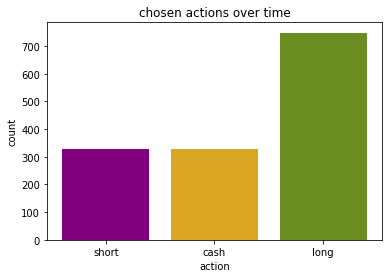

{'short': 329, 'cash': 327, 'long': 748}


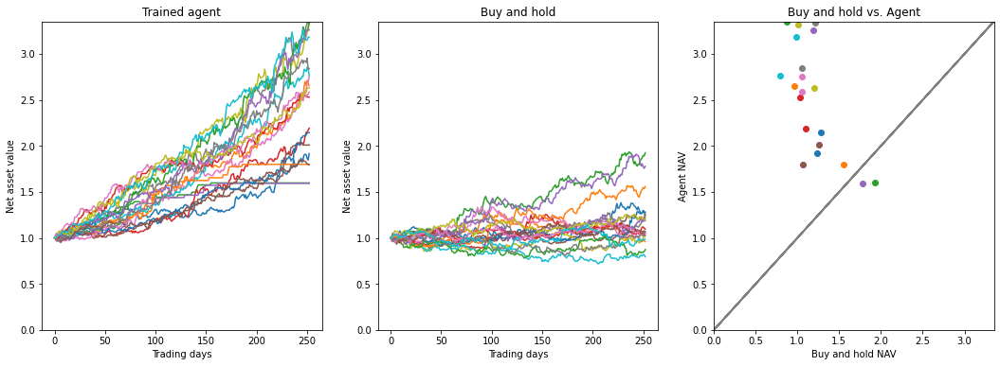

(             agent_avg  market_avg  agent_better
return        2.512527    1.180994           0.9
return_risk   1.238692    0.390001           1.0, array([1.91512447, 2.653241  , 1.59695139, 2.19189244, 1.5926936 ,
       2.00897213, 2.75637898, 3.33340751, 3.32215902, 2.76533706,
       2.14235749, 1.79874198, 3.35243549, 2.53035733, 3.25799439,
       1.79642993, 2.58447278, 2.84104728, 2.63021141, 3.18034094]), array([1.24011259, 0.95910621, 1.92424447, 1.09425247, 1.77822417,
       1.2605809 , 1.0503416 , 1.21434336, 1.01254861, 0.79448038,
       1.27965468, 1.55750053, 0.8728944 , 1.03059714, 1.1870934 ,
       1.06936243, 1.05263799, 1.05644038, 1.19949078, 0.98597823]))


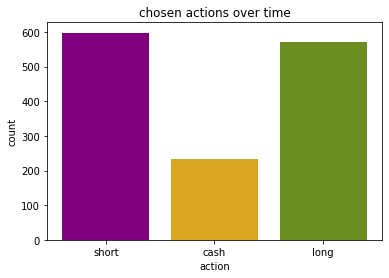

{'short': 598, 'cash': 234, 'long': 572}


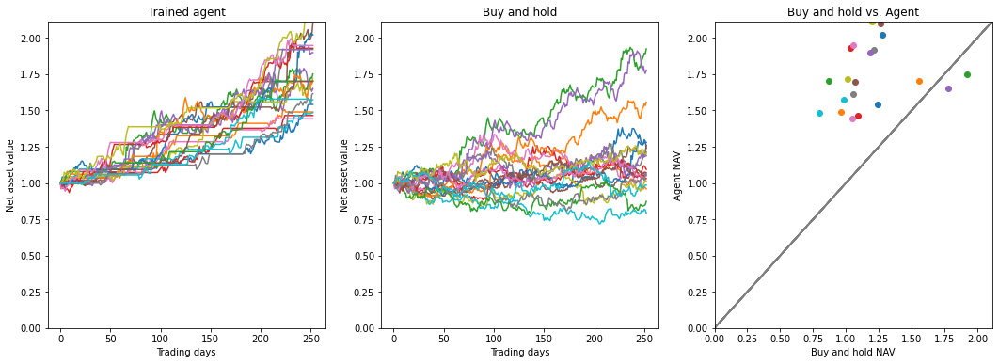

(             agent_avg  market_avg  agent_better
return        1.738879    1.180994           0.9
return_risk   1.300726    0.390001           1.0, array([1.54187288, 1.48981109, 1.75131612, 1.46544182, 1.65132035,
       2.10091804, 1.4430147 , 1.92017117, 1.71846319, 1.48455166,
       2.02168425, 1.7062299 , 1.70193706, 1.92875698, 1.8985017 ,
       1.70016863, 1.94847411, 1.61628883, 2.11486718, 1.57379856]), array([1.24011259, 0.95910621, 1.92424447, 1.09425247, 1.77822417,
       1.2605809 , 1.0503416 , 1.21434336, 1.01254861, 0.79448038,
       1.27965468, 1.55750053, 0.8728944 , 1.03059714, 1.1870934 ,
       1.06936243, 1.05263799, 1.05644038, 1.19949078, 0.98597823]))


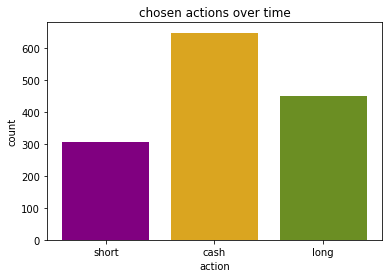

{'short': 306, 'cash': 648, 'long': 450}


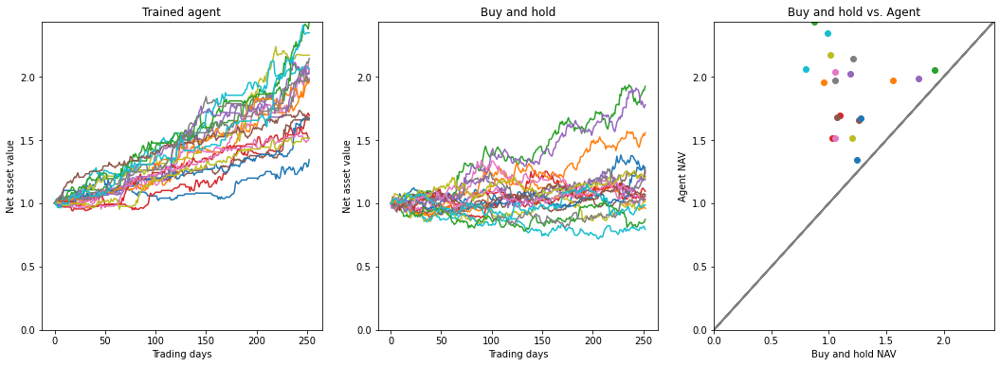

(             agent_avg  market_avg  agent_better
return        1.887402    1.180994           1.0
return_risk   1.236201    0.390001           1.0, array([1.34436341, 1.95680097, 2.05366815, 1.69222725, 1.98536134,
       1.65862117, 2.03671903, 2.14373287, 2.16954359, 2.06310835,
       1.67051853, 1.97154185, 2.43656624, 1.51706379, 2.02532045,
       1.67586486, 1.51163792, 1.97187869, 1.5167339 , 2.34676274]), array([1.24011259, 0.95910621, 1.92424447, 1.09425247, 1.77822417,
       1.2605809 , 1.0503416 , 1.21434336, 1.01254861, 0.79448038,
       1.27965468, 1.55750053, 0.8728944 , 1.03059714, 1.1870934 ,
       1.06936243, 1.05263799, 1.05644038, 1.19949078, 0.98597823]))


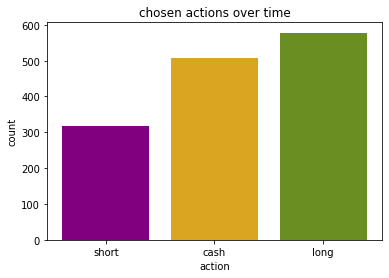

{'short': 318, 'cash': 508, 'long': 578}
**** 
Testing trained agent with time periods 2019-01-01 till 2022-06-01 
 ****


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(


71 observations have been deleted due to missing data
This equals 8.42% of the data
Time period used for training or testing starts at:2020-04-30 00:00:00 and ends at: 2022-05-31 00:00:00


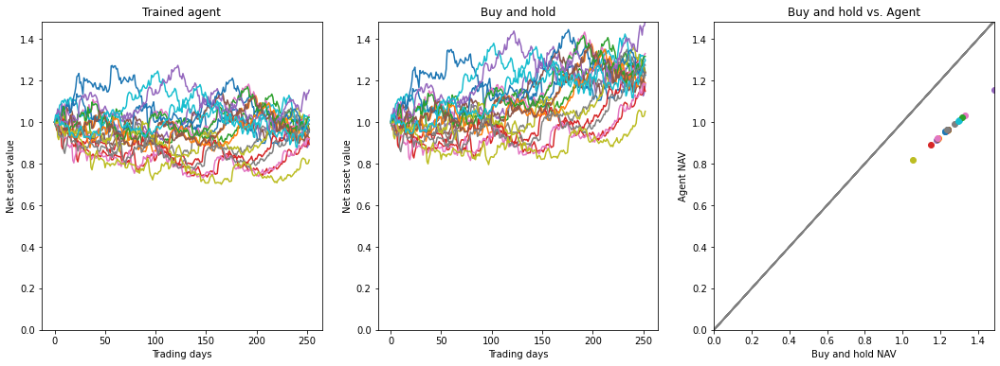

(             agent_avg  market_avg  agent_better
return        0.965174    1.241789           0.0
return_risk  -0.411799    0.639760           0.0, array([0.95326332, 0.96313733, 0.96515358, 0.9616961 , 0.91621319,
       0.92064844, 1.03439695, 0.99057576, 0.96277555, 1.01121628,
       0.95327769, 0.92475347, 1.02382619, 0.89333825, 1.1546009 ,
       0.96500049, 0.92146364, 0.96244765, 0.81822674, 1.00746667]), array([1.22646481, 1.23916868, 1.24176277, 1.2373144 , 1.17879627,
       1.18450263, 1.33085101, 1.27447085, 1.2387032 , 1.30102686,
       1.2264833 , 1.18978415, 1.31725072, 1.14936545, 1.48550494,
       1.24156581, 1.18555146, 1.23828133, 1.05272728, 1.29620263]))


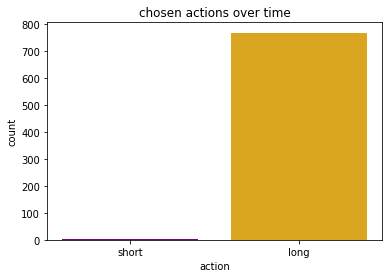

In [ ]:
for i in range (0,5):
    print('**** \nTraining agent 5 times with time periods '+ train_start_dates[i]+' till '+train_end_dates[i]+' \n****')
    env_train, model = train_agent(ticker_name = tickers[2] ,
                        ta_indicators_used = [],
                        start_date = train_start_dates[i],
                        end_date = train_end_dates[i])

    print('**** \nTesting trained agent with time periods '+ test_start_dates[i]+ ' till ' + test_end_dates[i]+' \n ****')
    env_test = TradingEnvironmentNew(ticker = tickers[2],
        use_variables = env_train.data_source.df.columns[1:].to_list(),
        scaler = env_train.data_source.scaler,
        start_date = test_start_dates[i],
        end_date = test_end_dates[i]
        )
    res_test = ai_trade_performance(env_test, model, seeds = seed )
    print(res_test)
    actions_test = analyze_actions_taken(env_test, model, plot_actions = True ,environment_new = True)

## 6. Taking a look at  overall findings



As we can see, it is now possible for RL agents to learn optimal trading strategies that outperform simple buy-and-sell strategies that were used by people in the past.
Training artificial agents for trading decisions can become a promising approach in near future. Already several researches are going on to tackle the challenges faced in this area and seems like it is slowly taking over human brokers. It will definitely be quick and can handle complex situations by seeing the big picture, which humans fail to comprehend, and also reduce human error to a great extent.

Even though reinforcement learning lacks the ability to perceive the environment, the combination of deep learning and reinforcement learning (DRL) solves this problem and it has more advantages when it has the decision making ability of reinforcement learning and perception ability of deep learning.

At present, an increasing number of studies implement dynamic trading strategies based on deep reinforcement learning.

Some of the challenges which I see are:

- In order to reach efficient performance, the agent depends on the amount of experience it accumulates during training, and for an RL agent, it needs a careful choice of market state variables.
- Correct analysis of the state of the stock market since financial data is nonlinear and unstable. Diﬀerent data sources reﬂect the changes in the stock market from diﬀerent perspectives.
- Most of the existing studies on stock trading based on DRL analyze the stock market through stock data. However, there is noise in stock data, which aﬀects the ﬁnal analysis results. A tradeoff between removing noise and pertaining useful information should be considered.
- When it comes to an agent trying to make decisions for multiple assets, it might sometimes be challenging to know the history of the assets from different sources.
- It is also inevitable that some investments will involve a degree of risk. Choosing an appropriate measure of risk to work as a reward for agents.
- Selecting a very efficient algorithm that exploits the particular properties of markets

## 7. Scientific paper- Related study


###### [ Dynamic stock-decision ensemble strategy based on deep reinforcement learning](https://link.springer.com/content/pdf/10.1007/s10489-022-03606-0.pdf)



The paper proposes a two- layered nested  reinforcement learning (Nested RL) method based on three Deep RLmodels ( Advantage Actor Critic, Deep Deterministic Policy Gradient, and Soft Actor Critic ).
They combined these 3 models to integrate the individual advantages and to obtain higher returns with minimal risk.

At the second layer of nested RL, the three agents(A2C/DDPG/SAC ) whose environmental factors include opening/high/low prices, closing prices, trading volume & balance and reward the annualized return, attempt to learn their own trading strategies independently and present their recommendations, while at the first layer, a primary agent (A2C/DDPG/SAC ) aims to learn a selection strategy of determining which recommendations (from 2nd layer) to adopt.

 In addition to the layered RL framework, to comprehensively combine the strengths of each agent, they added the corresponding weight to each agent by introducing the weighted random selection with confidence (WRSC) algorithm. It selects the optimal trading strategy from the A2C, DDPG, and SAC based on their weight and confidence .

All the algorithms are validated for the U.S., Japanese and British stocks and evaluated by different performance indicators.The experimental results show that the annualized return, cumulative return, and Sharpe ratio values of the proposed ensemble strategy are higher than those of the RandomWeight-R, Weight-R, Average-W, Multi-DQN and AUST ensemble strategies, which only use a greedy algorithm to select agents.


## Extra: Comparing five algorithms for one company and one time period.
 https://stable-baselines3.readthedocs.io/en/master/guide/algos.html

In [ ]:
#trying out different algorithms.

from stable_baselines3 import A2C, PPO, DQN
from sb3_contrib import ARS

/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))


56 observations have been deleted due to missing data
This equals 4.56% of the data
Time period used for training or testing starts at:2013-03-28 00:00:00 and ends at: 2016-12-30 00:00:00


/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/pool.py:48: FutureWarning: The series.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  return list(map(*args))
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/aif_course/aif_environment.py:428: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df.dropna(inplace = True)
/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/gym/spaces/box.py:73: UserWarning: WARN: Box bound precision lowered by casting to float32
  logger.warn(
/opt/homebrew/C

54 observations have been deleted due to missing data
This equals 5.47% of the data
Time period used for training or testing starts at:2019-04-01 00:00:00 and ends at: 2021-12-31 00:00:00


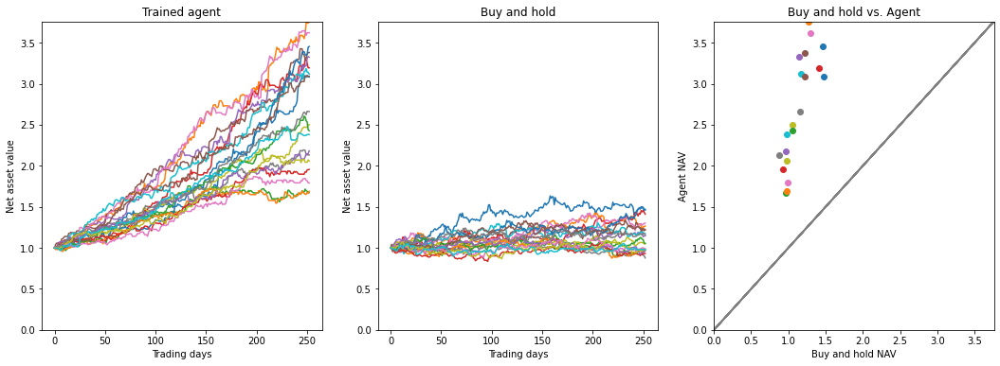

(             agent_avg  market_avg  agent_better
return        2.673649    1.129952           1.0
return_risk   1.271140    0.702771           1.0, array([3.08342436, 3.75946307, 1.67298668, 3.19411915, 3.32418232,
       3.38038555, 3.62124276, 2.13273447, 2.50033347, 3.1167692 ,
       3.4534205 , 1.68908828, 2.42719936, 1.95505186, 2.18182391,
       3.0912714 , 1.79016383, 2.66130951, 2.05794783, 2.38005653]), array([1.47025351, 1.26629298, 0.96942337, 1.40965458, 1.14570295,
       1.21890174, 1.30084313, 0.87682904, 1.04816128, 1.17255953,
       1.46158592, 0.97875355, 1.0547342 , 0.93181888, 0.96817951,
       1.22341939, 0.98876204, 1.15666133, 0.97609957, 0.98039581]))


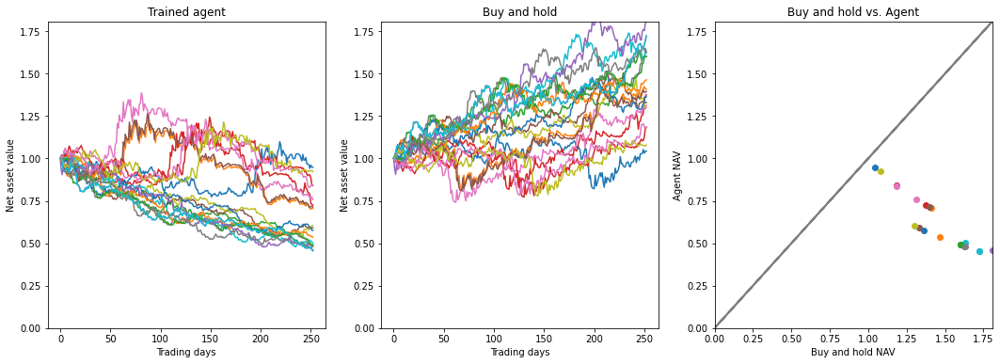

(             agent_avg  market_avg  agent_better
return        0.628857    1.438706           0.0
return_risk  -1.001281    0.959248           0.0, array([0.94733436, 0.70599348, 0.49006853, 0.72380122, 0.45581214,
       0.59039266, 0.7576277 , 0.48364632, 0.60256748, 0.50317369,
       0.57596793, 0.53612657, 0.4902466 , 0.84226983, 0.46112847,
       0.71257316, 0.83837731, 0.48149533, 0.92271979, 0.45581214]), array([1.04268164, 1.40941106, 1.60120817, 1.37473519, 1.72154635,
       1.32911837, 1.31335618, 1.62247019, 1.30226365, 1.62820247,
       1.36240526, 1.46365014, 1.60062657, 1.18137322, 1.80817297,
       1.39639698, 1.18685823, 1.62971826, 1.07837181, 1.72154635]))


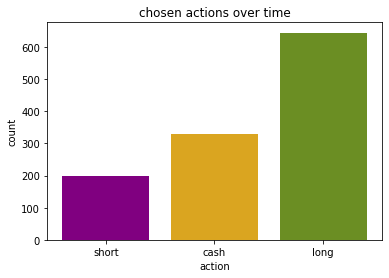

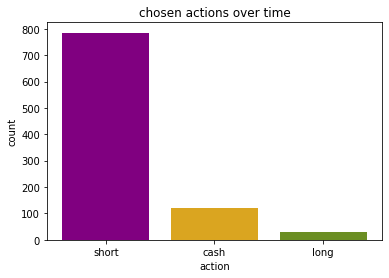

In [ ]:
#DQN
env_train = TradingEnvironmentNew(ticker = 'TCS.NS',
        start_date = '2012-01-01',
        end_date = '2017-01-01'
    )

env_test = TradingEnvironmentNew(ticker = 'TCS.NS',
        use_variables = env_train.data_source.df.columns[1:].to_list(),
        scaler = env_train.data_source.scaler,
        start_date = '2018-01-01',
        end_date = '2022-01-01'
    )
seed = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20]

model = DQN("MlpPolicy", env_train, verbose=0, exploration_fraction=0.3, learning_rate = 0.0001)
model.learn(total_timesteps = 70000)
res_train = ai_trade_performance( env_train, model,seeds = seed)
print(res_train)
res_test = ai_trade_performance(env_test, model,seeds = seed)
#print('RESULTS- TEST')
print(res_test)
actions_training = analyze_actions_taken(env_train, model, plot_actions = True, environment_new = True)
actions_test = analyze_actions_taken(env_test, model, plot_actions = True,environment_new = True)

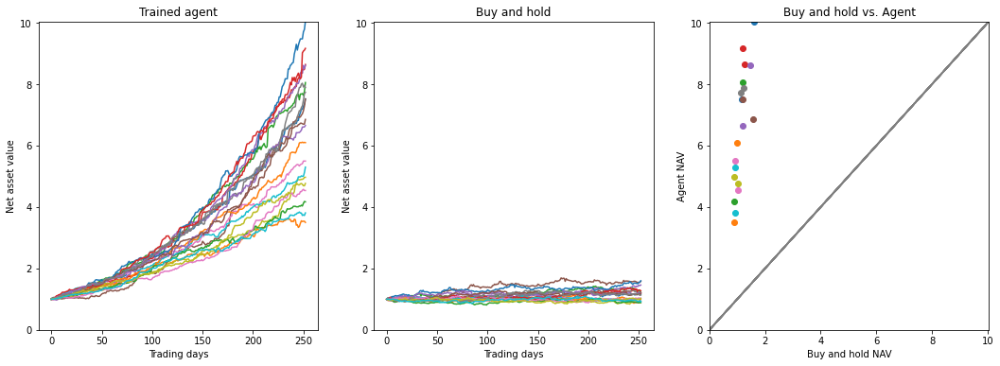

(             agent_avg  market_avg  agent_better
return        6.565568    1.135715           1.0
return_risk   1.150347    0.543658           1.0, array([ 7.51944733,  3.49876287,  8.05105287,  8.63865153,  8.61564508,
        6.85093582,  5.49544875,  7.8885768 ,  4.96659899,  5.29774453,
       10.04221614,  6.09692283,  4.16865623,  9.16401586,  6.65304514,
        7.51709628,  4.53666417,  7.7345385 ,  4.76702564,  3.80831469]), array([1.1505472 , 0.89316134, 1.21117291, 1.27255003, 1.46114358,
       1.5820933 , 0.92361592, 1.21890174, 0.89866495, 0.93806043,
       1.5977674 , 0.99420596, 0.89047954, 1.20691365, 1.18913182,
       1.17936012, 1.03433763, 1.13580049, 1.0223804 , 0.914004  ]))


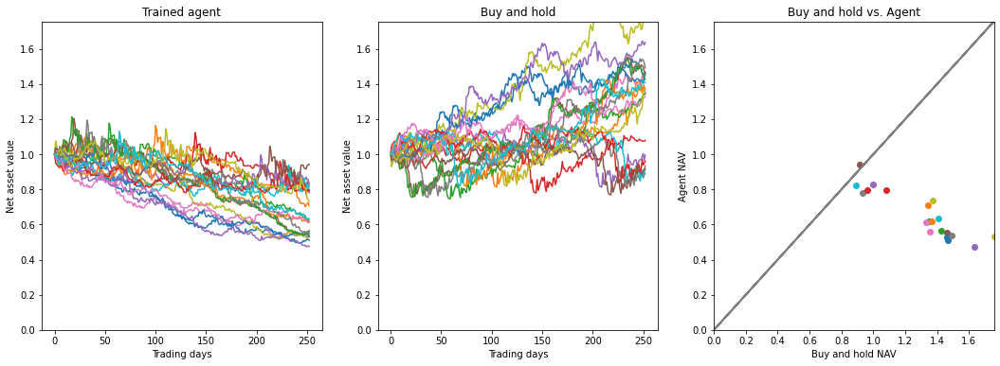

(             agent_avg  market_avg  agent_better
return        0.657416    1.299581          0.05
return_risk  -1.126428    0.660596          0.00, array([0.51057457, 0.70830221, 0.62000012, 0.79426366, 0.82926985,
       0.55134903, 0.56056321, 0.78045418, 0.53052451, 0.82064417,
       0.52903795, 0.61956381, 0.56410085, 0.79691544, 0.47428204,
       0.94069554, 0.61127393, 0.53933835, 0.73455072, 0.63261038]), array([1.46734731, 1.34255411, 1.34750251, 1.07837181, 0.99573949,
       1.45903536, 1.35289161, 0.93439129, 1.75619264, 0.88863068,
       1.46023175, 1.3663008 , 1.42605304, 0.96018982, 1.63617276,
       0.91566744, 1.32868426, 1.49152703, 1.37473519, 1.40941106]))


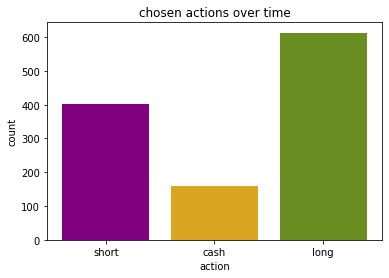

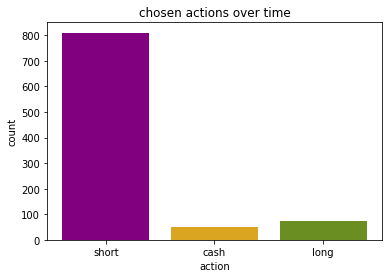

In [ ]:
model = PPO("MlpPolicy", env_train, verbose=0)
model.learn(total_timesteps = 70000)
res_train = ai_trade_performance(env_train, model)
print(res_train)
res_test = ai_trade_performance(env_test, model)
#print('RESULTS- TEST')
print(res_test)
actions_training = analyze_actions_taken(env_train, model, plot_actions = True, environment_new = True)
actions_test = analyze_actions_taken(env_test, model, plot_actions = True,environment_new = True)

Process ForkServerProcess-81:
Traceback (most recent call last):
  File "/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/process.py", line 315, in _bootstrap
    self.run()
  File "/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
  File "/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/site-packages/sb3_contrib/common/vec_env/async_eval.py", line 34, in _worker
    env = worker_env_wrapper.var()
  File "/var/folders/25/w94518j938j_pmy8mf0jr1n00000gn/T/ipykernel_45465/386849869.py", line 4, in <lambda>
NameError: name 'make_vec_env' is not defined
Process ForkServerProcess-82:
Traceback (most recent call last):
  File "/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/process.py", line 315, in _bootstrap
    self.run()
  File "/opt/homebrew/Caskroom/miniforge/base/envs/env/lib/python3.8/multiprocessing/process.py", li

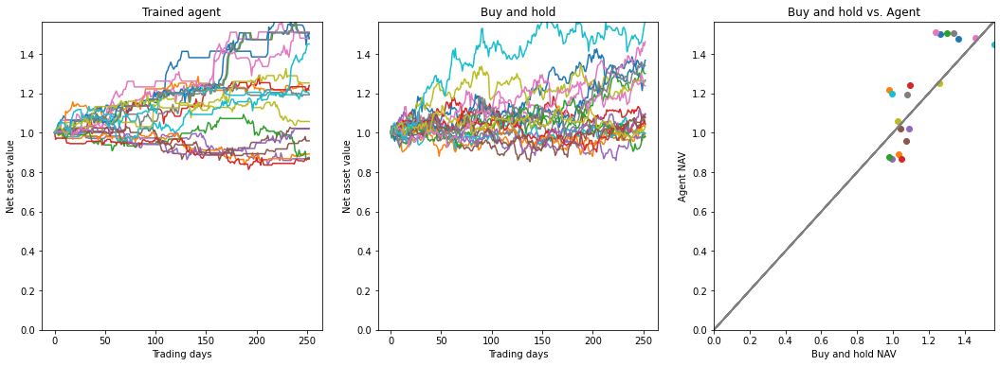

(             agent_avg  market_avg  agent_better
return        1.204624    1.162359          0.55
return_risk   0.644360    0.589038          1.00, array([1.50261506, 1.21705232, 1.50742345, 1.23967289, 0.8678058 ,
       1.02198057, 1.47965529, 1.19249922, 1.25243163, 1.19731772,
       1.47679364, 0.8918742 , 0.87475375, 0.86748122, 1.01903123,
       0.9588729 , 1.51068273, 1.50742345, 1.0570971 , 1.4500148 ]), array([1.26629298, 0.98095574, 1.30016945, 1.09588225, 0.99734913,
       1.04245999, 1.46114358, 1.07933982, 1.25854566, 0.99687604,
       1.36802036, 1.03433763, 0.98088891, 1.04556928, 1.0919641 ,
       1.07588822, 1.23777407, 1.34114971, 1.0279023 , 1.56467012]))


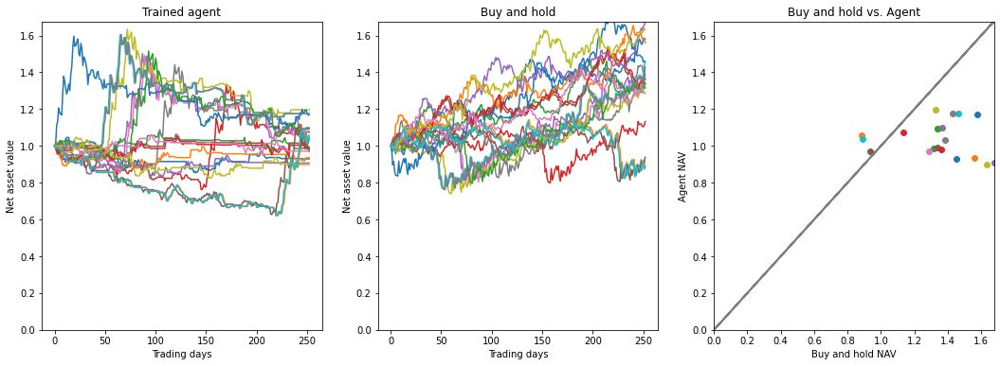

(             agent_avg  market_avg  agent_better
return        1.039022    1.334586          0.15
return_risk   0.121648    0.825115          0.00, array([0.92932811, 1.05759513, 0.98551084, 1.07541807, 1.09930895,
       0.993641  , 1.09258272, 1.03438256, 1.1965085 , 1.17519703,
       1.17087472, 0.93615545, 1.09414185, 0.98171711, 0.9063753 ,
       0.96916425, 0.97164829, 1.17519703, 0.89816892, 1.03752108]), array([1.45471091, 0.88267726, 1.31407691, 1.13275314, 1.3663008 ,
       1.33748776, 1.33778354, 1.38349563, 1.32862486, 1.46096972,
       1.57953496, 1.56042708, 1.33909506, 1.36068583, 1.67681097,
       0.93824283, 1.28816436, 1.42908485, 1.63168637, 0.88911133]))


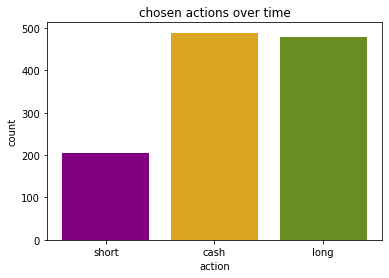

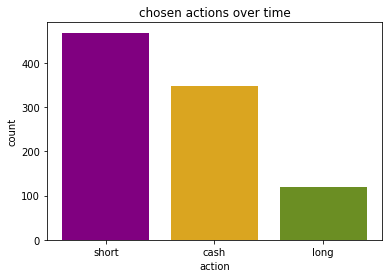

In [ ]:
from sb3_contrib.common.vec_env import AsyncEval
n_envs = 3
model = ARS("LinearPolicy", env_train, n_delta=2, n_top=1, verbose=0)
async_eval = AsyncEval([lambda: make_vec_env(env_train) for _ in range(n_envs)], model.policy)
model.learn(total_timesteps = 70000)
res_train = ai_trade_performance(env_train, model)
print(res_train)
res_test = ai_trade_performance(env_test, model)
#print('RESULTS- TEST')
print(res_test)
actions_training = analyze_actions_taken(env_train, model, plot_actions = True, environment_new = True)
actions_test = analyze_actions_taken(env_test, model, plot_actions = True,environment_new = True)